# Football Transfer Market Data Analysis


In [1]:
!pip install xgboost


In [6]:
!pip install lightgbm


     --------                              23.4/101.0 MB 454.0 kB/s eta 0:02:52


ERROR: Exception:
Traceback (most recent call last):
  File "C:\Users\ASUS\anaconda3\lib\site-packages\pip\_vendor\urllib3\response.py", line 437, in _error_catcher
    yield
  File "C:\Users\ASUS\anaconda3\lib\site-packages\pip\_vendor\urllib3\response.py", line 560, in read
    data = self._fp_read(amt) if not fp_closed else b""
  File "C:\Users\ASUS\anaconda3\lib\site-packages\pip\_vendor\urllib3\response.py", line 526, in _fp_read
    return self._fp.read(amt) if amt is not None else self._fp.read()
  File "C:\Users\ASUS\anaconda3\lib\site-packages\pip\_vendor\cachecontrol\filewrapper.py", line 90, in read
    data = self.__fp.read(amt)
  File "C:\Users\ASUS\anaconda3\lib\http\client.py", line 465, in read
    s = self.fp.read(amt)
  File "C:\Users\ASUS\anaconda3\lib\socket.py", line 705, in readinto
    return self._sock.recv_into(b)
  File "C:\Users\ASUS\anaconda3\lib\ssl.py", line 1274, in recv_into
    return self.read(nbytes, buffer)
  File "C:\Users\ASUS\anaconda3\lib\ssl.py"

In [733]:
# Import modules
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import datetime as dt
import calendar
import datetime
from datetime import datetime, timedelta, date
import warnings
import os

from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.svm import SVR
from sklearn.ensemble import GradientBoostingRegressor
from sklearn import ensemble
from xgboost import XGBRegressor
from lightgbm import LGBMRegressor
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import train_test_split

#settings
pd.set_option('display.max_row', 100)
pd.set_option('display.max_columns', 1200)
pd.set_option('display.width', 1200)
warnings.filterwarnings("ignore")
%matplotlib inline

#variables
colour=['maroon','r','g','darkgreen','c','teal','b','navy','indigo','m','deeppink','orange','sienna','yellow','khaki','olive','tan','black','grey','brown']

print("Packages installed")

Packages installed


# Get Data

In [734]:
# Import all files in the current directory and read into dataframes
dataframes = []

# Get the current working directory
current_directory = os.getcwd()

# Look for CSV files in the current directory
for filename in os.listdir(current_directory):
    if filename.endswith(".csv"):
        file = filename.split('.')[0] + "_df"
        filepath = os.path.join(current_directory, filename)
        df = pd.read_csv(filepath, sep=",", encoding="UTF-8")
        exec(f'{file} = df.copy()')
        print(file, df.shape)
        dataframes.append(df)

print('Data imported')


appearances_df (1524941, 13)
clubs_df (426, 17)
club_games_df (132390, 11)
competitions_df (43, 10)
games_df (66195, 23)
game_events_df (681952, 10)
game_lineups_df (2304615, 9)
players_df (30396, 23)
player_valuations_df (464869, 5)
Data imported


In [735]:
game_lineups_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2304615 entries, 0 to 2304614
Data columns (total 9 columns):
 #   Column           Dtype 
---  ------           ----- 
 0   game_lineups_id  object
 1   game_id          int64 
 2   club_id          int64 
 3   type             object
 4   number           object
 5   player_id        int64 
 6   player_name      object
 7   team_captain     int64 
 8   position         object
dtypes: int64(4), object(5)
memory usage: 158.2+ MB


In [736]:
game_events_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 681952 entries, 0 to 681951
Data columns (total 10 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   game_event_id     681952 non-null  object 
 1   date              681952 non-null  object 
 2   game_id           681952 non-null  int64  
 3   minute            681952 non-null  int64  
 4   type              681952 non-null  object 
 5   club_id           681952 non-null  int64  
 6   player_id         681952 non-null  int64  
 7   description       344576 non-null  object 
 8   player_in_id      429604 non-null  float64
 9   player_assist_id  32987 non-null   float64
dtypes: float64(2), int64(4), object(4)
memory usage: 52.0+ MB


In [737]:
competitions_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 43 entries, 0 to 42
Data columns (total 10 columns):
 #   Column                Non-Null Count  Dtype 
---  ------                --------------  ----- 
 0   competition_id        43 non-null     object
 1   competition_code      43 non-null     object
 2   name                  43 non-null     object
 3   sub_type              43 non-null     object
 4   type                  43 non-null     object
 5   country_id            43 non-null     int64 
 6   country_name          36 non-null     object
 7   domestic_league_code  36 non-null     object
 8   confederation         43 non-null     object
 9   url                   43 non-null     object
dtypes: int64(1), object(9)
memory usage: 3.5+ KB


In [738]:
games_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 66195 entries, 0 to 66194
Data columns (total 23 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   game_id                 66195 non-null  int64  
 1   competition_id          66195 non-null  object 
 2   season                  66195 non-null  int64  
 3   round                   66195 non-null  object 
 4   date                    66195 non-null  object 
 5   home_club_id            66195 non-null  int64  
 6   away_club_id            66195 non-null  int64  
 7   home_club_goals         66195 non-null  int64  
 8   away_club_goals         66195 non-null  int64  
 9   home_club_position      46460 non-null  float64
 10  away_club_position      46459 non-null  float64
 11  home_club_manager_name  65451 non-null  object 
 12  away_club_manager_name  65451 non-null  object 
 13  stadium                 65982 non-null  object 
 14  attendance              56539 non-null

In [739]:
games_df["season"].unique()

array([2013, 2014, 2015, 2016, 2017, 2012, 2018, 2019, 2020, 2021, 2022,
       2023], dtype=int64)

In [740]:
player_valuations_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 464869 entries, 0 to 464868
Data columns (total 5 columns):
 #   Column                               Non-Null Count   Dtype 
---  ------                               --------------   ----- 
 0   player_id                            464869 non-null  int64 
 1   date                                 464869 non-null  object
 2   market_value_in_eur                  464869 non-null  int64 
 3   current_club_id                      464869 non-null  int64 
 4   player_club_domestic_competition_id  464869 non-null  object
dtypes: int64(3), object(2)
memory usage: 17.7+ MB


In [741]:
appearances_df.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1524941 entries, 0 to 1524940
Data columns (total 13 columns):
 #   Column                  Non-Null Count    Dtype 
---  ------                  --------------    ----- 
 0   appearance_id           1524941 non-null  object
 1   game_id                 1524941 non-null  int64 
 2   player_id               1524941 non-null  int64 
 3   player_club_id          1524941 non-null  int64 
 4   player_current_club_id  1524941 non-null  int64 
 5   date                    1524941 non-null  object
 6   player_name             1524940 non-null  object
 7   competition_id          1524941 non-null  object
 8   yellow_cards            1524941 non-null  int64 
 9   red_cards               1524941 non-null  int64 
 10  goals                   1524941 non-null  int64 
 11  assists                 1524941 non-null  int64 
 12  minutes_played          1524941 non-null  int64 
dtypes: int64(9), object(4)
memory usage: 151.2+ MB


In [742]:
clubs_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 426 entries, 0 to 425
Data columns (total 17 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   club_id                  426 non-null    int64  
 1   club_code                426 non-null    object 
 2   name                     426 non-null    object 
 3   domestic_competition_id  426 non-null    object 
 4   total_market_value       0 non-null      float64
 5   squad_size               426 non-null    int64  
 6   average_age              388 non-null    float64
 7   foreigners_number        426 non-null    int64  
 8   foreigners_percentage    378 non-null    float64
 9   national_team_players    426 non-null    int64  
 10  stadium_name             426 non-null    object 
 11  stadium_seats            426 non-null    int64  
 12  net_transfer_record      426 non-null    object 
 13  coach_name               0 non-null      float64
 14  last_season              4

In [743]:
players_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30396 entries, 0 to 30395
Data columns (total 23 columns):
 #   Column                                Non-Null Count  Dtype  
---  ------                                --------------  -----  
 0   player_id                             30396 non-null  int64  
 1   first_name                            28416 non-null  object 
 2   last_name                             30396 non-null  object 
 3   name                                  30396 non-null  object 
 4   last_season                           30396 non-null  int64  
 5   current_club_id                       30396 non-null  int64  
 6   player_code                           30396 non-null  object 
 7   country_of_birth                      27704 non-null  object 
 8   city_of_birth                         28209 non-null  object 
 9   country_of_citizenship                29836 non-null  object 
 10  date_of_birth                         30350 non-null  object 
 11  sub_position   

### 1. Which team has won more in the year 2023?

In [744]:
import pandas as pd

# Assuming your DataFrame is named games_df
# Convert the 'date' column to datetime if it's not already
games_df['date'] = pd.to_datetime(games_df['date'])

# Filter data for the year 2022
games_2022 = games_df[games_df['date'].dt.year == 2023]

# Calculate wins for each team
home_wins = games_2022[games_2022['home_club_goals'] > games_2022['away_club_goals']]['home_club_name'].value_counts()
away_wins = games_2022[games_2022['away_club_goals'] > games_2022['home_club_goals']]['away_club_name'].value_counts()

# Combine home and away wins
total_wins = home_wins.add(away_wins, fill_value=0)

# Team with the most wins
team_with_most_wins = total_wins.idxmax()
number_of_wins = total_wins.max()

print(f"The team with the most wins in 2023 is {team_with_most_wins} with {number_of_wins} wins.")


The team with the most wins in 2023 is Manchester City Football Club with 48.0 wins.


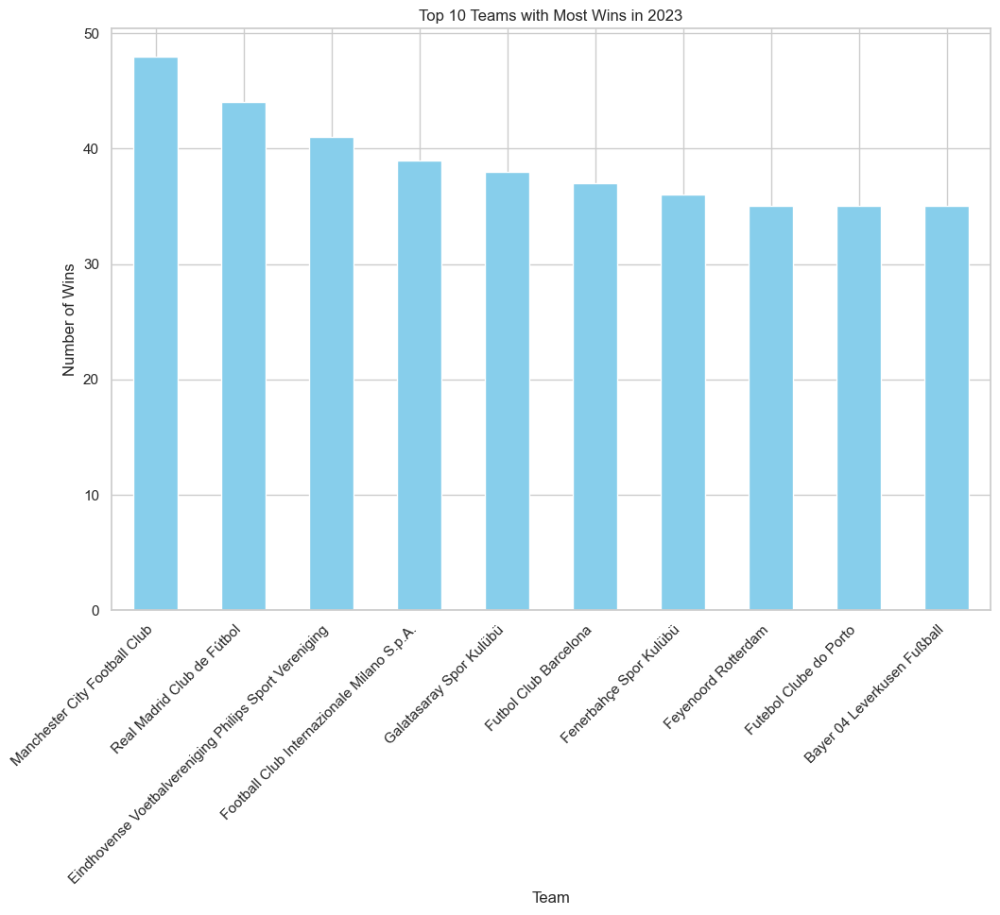

In [745]:
# Plotting the top 10 results
plt.figure(figsize=(12, 8))
total_wins.sort_values(ascending=False).head(10).plot(kind='bar', color='skyblue')
plt.title('Top 10 Teams with Most Wins in 2023')
plt.xlabel('Team')
plt.ylabel('Number of Wins')
plt.xticks(rotation=45, ha='right')
plt.show()


### Visualizing Club Squad Sizes

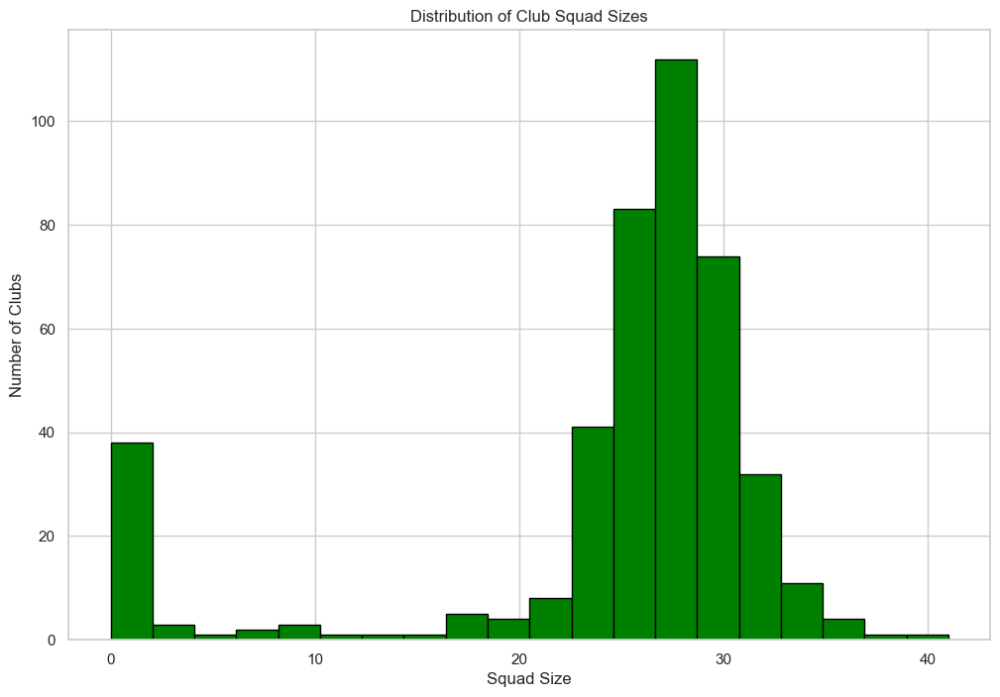

In [746]:
# Plotting club squad sizes
plt.figure(figsize=(12, 8))
plt.hist(clubs_df['squad_size'], bins=20, color='green', edgecolor='black')
plt.title('Distribution of Club Squad Sizes')
plt.xlabel('Squad Size')
plt.ylabel('Number of Clubs')
plt.show()


### Which player has the highest number of goals in a Match?

In [747]:
# Assuming your DataFrame is named appearances_df
# Find the player with the highest number of goals
highest_goals_player = appearances_df.loc[appearances_df['goals'].idxmax()]

print(f"The player with the highest number of goals is {highest_goals_player['player_name']} with {highest_goals_player['goals']} goals.")


The player with the highest number of goals is Arkadiusz Milik with 6 goals.


# highest number of goals in domestic leagues

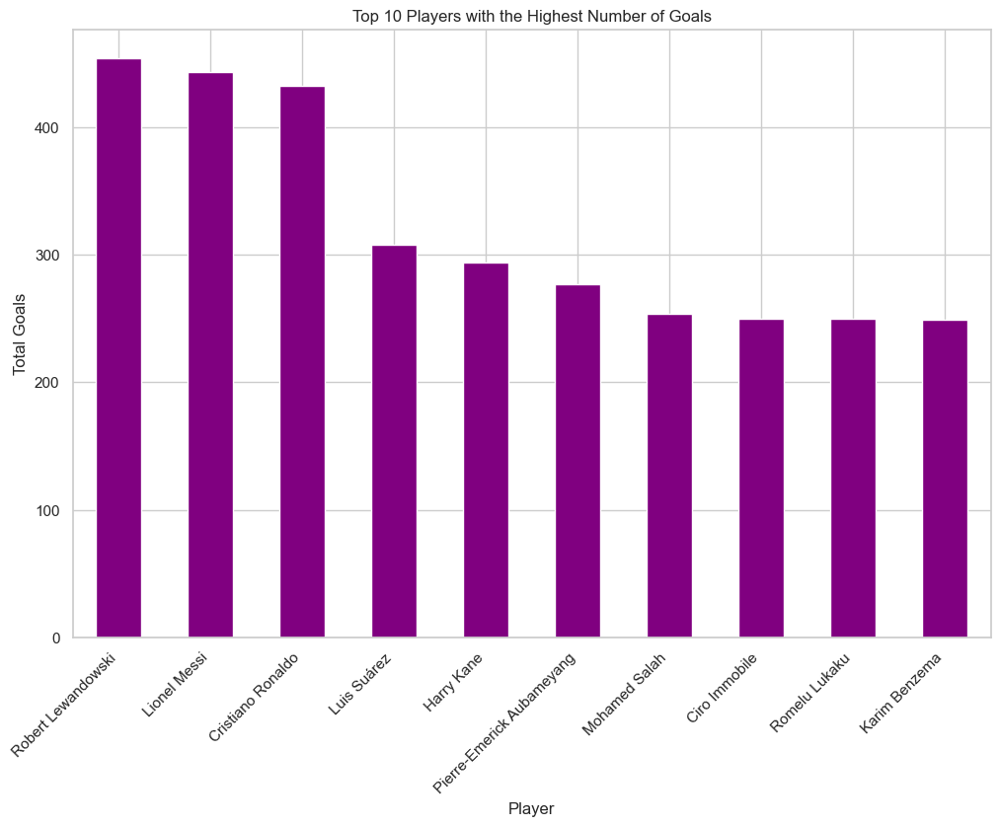

In [748]:
# Assuming your DataFrame is named appearances_df
# Find the top 10 players with the highest number of goals
top_goals_players = appearances_df.groupby('player_name')['goals'].sum().nlargest(10)

# Plotting top 10 players with the highest number of goals
plt.figure(figsize=(12, 8))
top_goals_players.plot(kind='bar', color='purple')
plt.title('Top 10 Players with the Highest Number of Goals')
plt.xlabel('Player')
plt.ylabel('Total Goals')
plt.xticks(rotation=45, ha='right')
plt.show()


In [749]:
##Visualizing Player Minutes Played

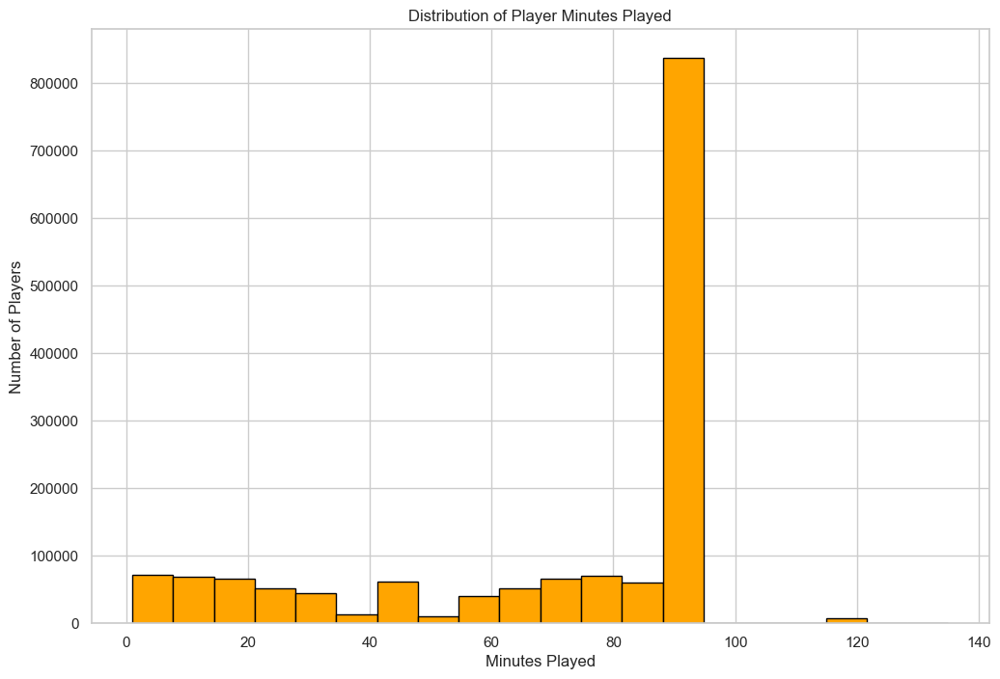

In [750]:
# Plotting player minutes played
plt.figure(figsize=(12, 8))
plt.hist(appearances_df['minutes_played'], bins=20, color='orange', edgecolor='black')
plt.title('Distribution of Player Minutes Played')
plt.xlabel('Minutes Played')
plt.ylabel('Number of Players')
plt.show()


In [751]:
# Which competition had the highest average attendance?

In [752]:
# Assuming your DataFrame is named games_df
# Find the competition with the highest average attendance
highest_average_attendance_competition = games_df.groupby('competition_id')['attendance'].mean().idxmax()

print(f"The competition with the highest average attendance is {highest_average_attendance_competition}.")


The competition with the highest average attendance is GBCS.


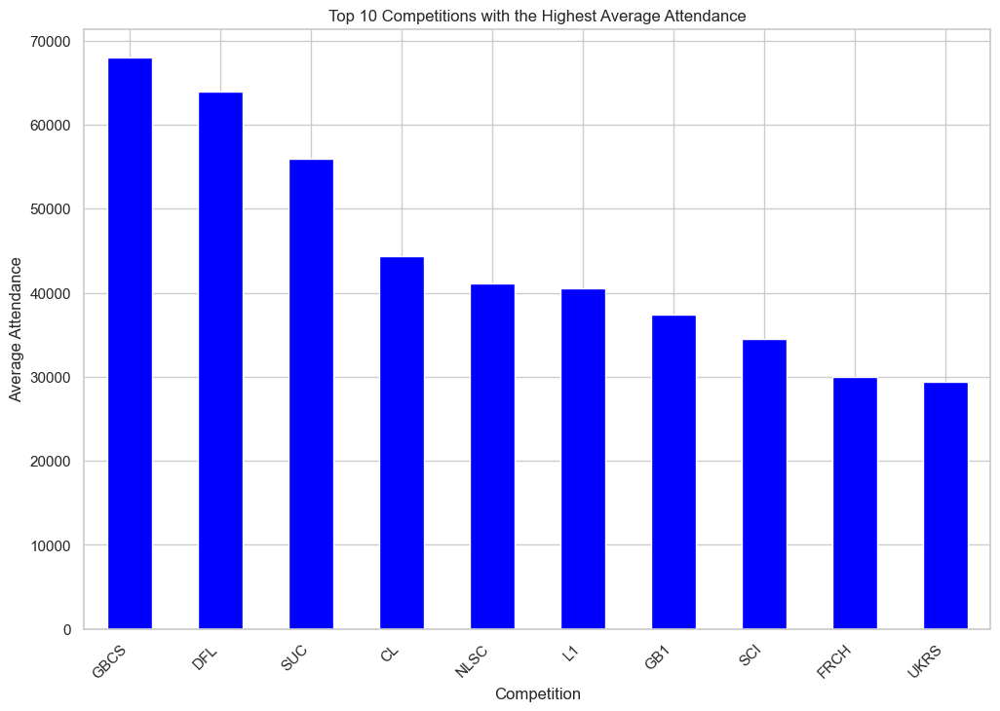

In [753]:
# Assuming your DataFrame is named games_df
# Find the top 10 competitions with the highest average attendance
top_avg_attendance_competitions = games_df.groupby('competition_id')['attendance'].mean().nlargest(10)

# Plotting top 10 competitions with the highest average attendance
plt.figure(figsize=(12, 8))
top_avg_attendance_competitions.plot(kind='bar', color='blue')
plt.title('Top 10 Competitions with the Highest Average Attendance')
plt.xlabel('Competition')
plt.ylabel('Average Attendance')
plt.xticks(rotation=45, ha='right')
plt.show()


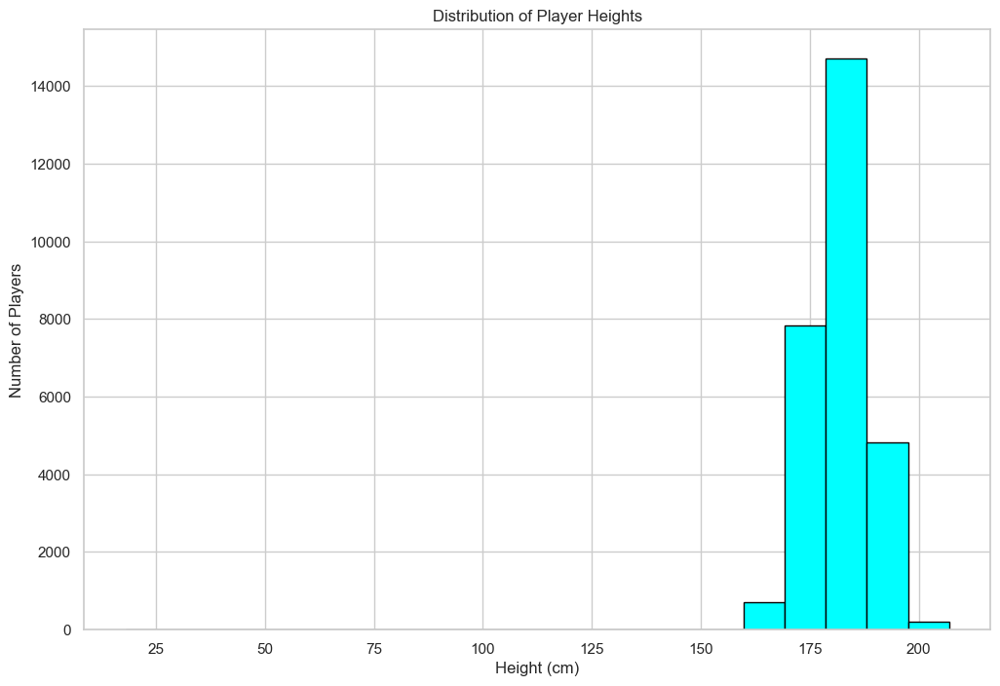

In [754]:
# Plotting player height distribution
plt.figure(figsize=(12, 8))
plt.hist(players_df['height_in_cm'].dropna(), bins=20, color='cyan', edgecolor='black')
plt.title('Distribution of Player Heights')
plt.xlabel('Height (cm)')
plt.ylabel('Number of Players')
plt.show()


In [755]:
# Which competition had the highest total number of goals scored?

In [756]:
# Assuming your DataFrame is named games_df
# Find the competition with the highest total number of goals scored
highest_total_goals_competition = games_df.groupby('competition_id')['home_club_goals', 'away_club_goals'].sum().sum(axis=1).idxmax()

print(f"The competition with the highest total number of goals scored is {highest_total_goals_competition}.")


The competition with the highest total number of goals scored is GB1.


The competition with the highest total number of goals scored is GB1.


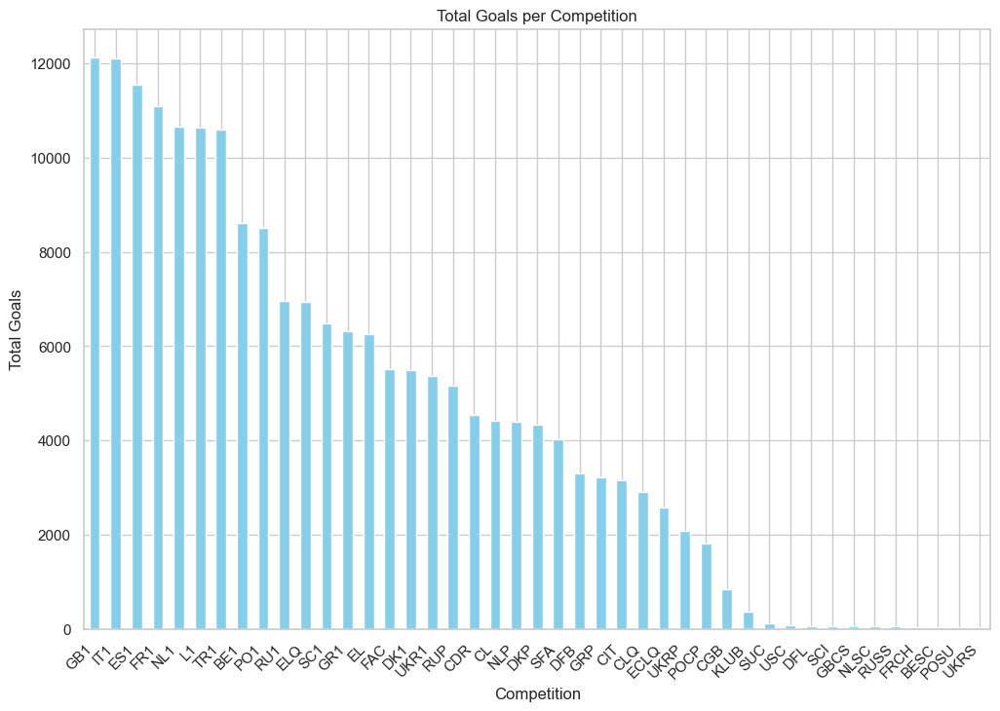

In [757]:
# Assuming your DataFrame is named games_df
# Calculate total goals for each competition
total_goals_per_competition = games_df.groupby('competition_id')['home_club_goals', 'away_club_goals'].sum().sum(axis=1)

# Find the competition with the highest total number of goals scored
highest_total_goals_competition = total_goals_per_competition.idxmax()

print(f"The competition with the highest total number of goals scored is {highest_total_goals_competition}.")

# Plotting total goals per competition
plt.figure(figsize=(12, 8))
total_goals_per_competition.sort_values(ascending=False).plot(kind='bar', color='skyblue')
plt.title('Total Goals per Competition')
plt.xlabel('Competition')
plt.ylabel('Total Goals')
plt.xticks(rotation=45, ha='right')
plt.show()


In [758]:
#Visualizing Player Positions Distribution

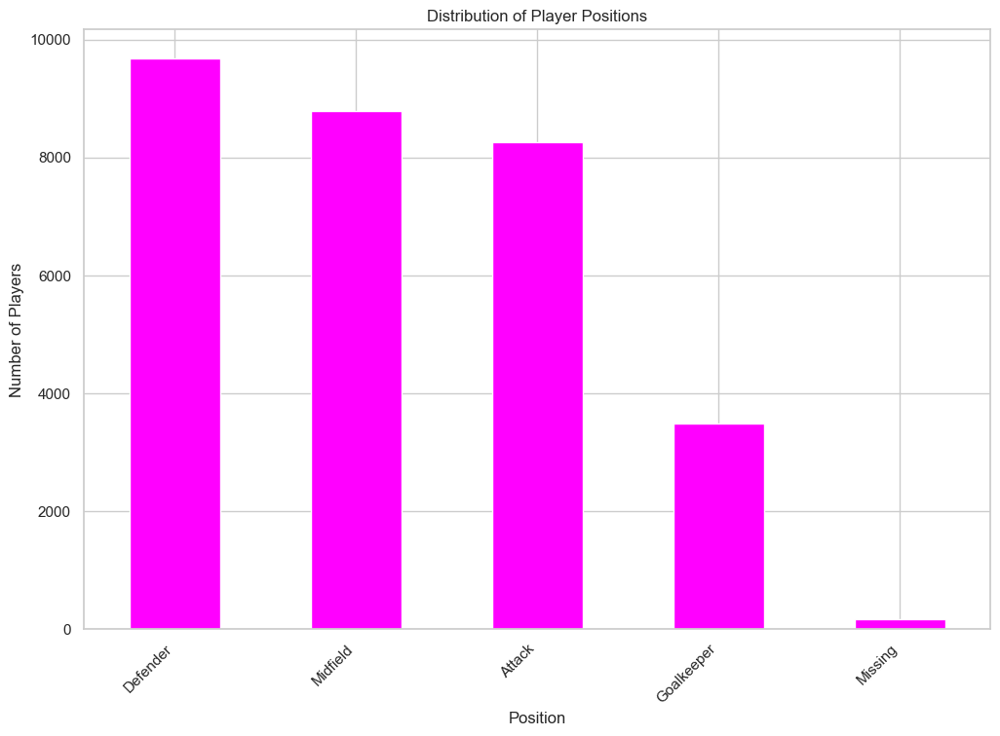

In [759]:
# Plotting player positions distribution
plt.figure(figsize=(12, 8))
players_df['position'].value_counts().plot(kind='bar', color='magenta')
plt.title('Distribution of Player Positions')
plt.xlabel('Position')
plt.ylabel('Number of Players')
plt.xticks(rotation=45, ha='right')
plt.show()


In [760]:
# Visualizing Player Age Distribution

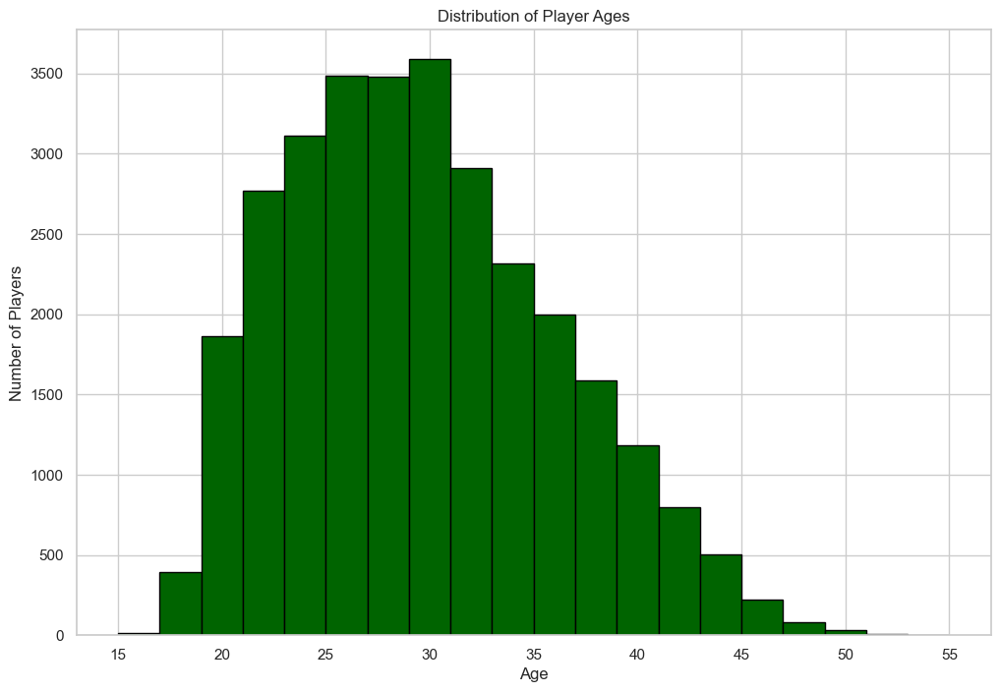

In [761]:
# Assuming your DataFrame is named players_df
# Plotting player age distribution
plt.figure(figsize=(12, 8))
plt.hist((pd.to_datetime('now') - pd.to_datetime(players_df['date_of_birth'])).dt.days // 365, bins=20, color='darkgreen', edgecolor='black')
plt.title('Distribution of Player Ages')
plt.xlabel('Age')
plt.ylabel('Number of Players')
plt.show()


In [762]:
# Visualizing Club Average Age Distribution

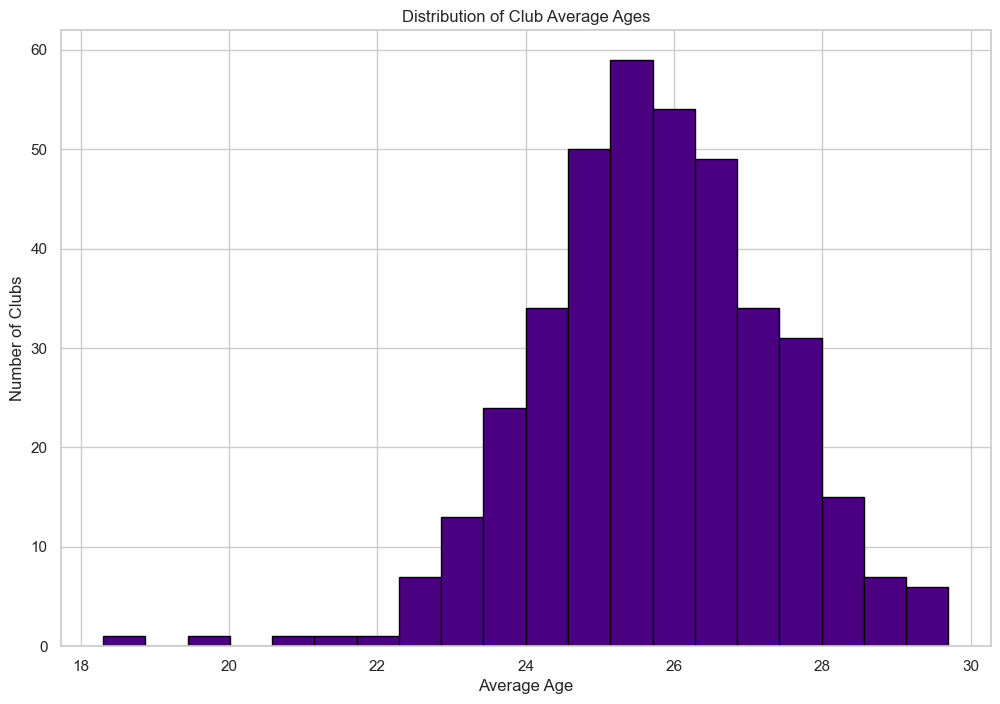

In [763]:
# Plotting club average age distribution
plt.figure(figsize=(12, 8))
plt.hist(clubs_df['average_age'].dropna(), bins=20, color='indigo', edgecolor='black')
plt.title('Distribution of Club Average Ages')
plt.xlabel('Average Age')
plt.ylabel('Number of Clubs')
plt.show()


In [764]:
# Visualizing Club Stadium Capacity Distribution

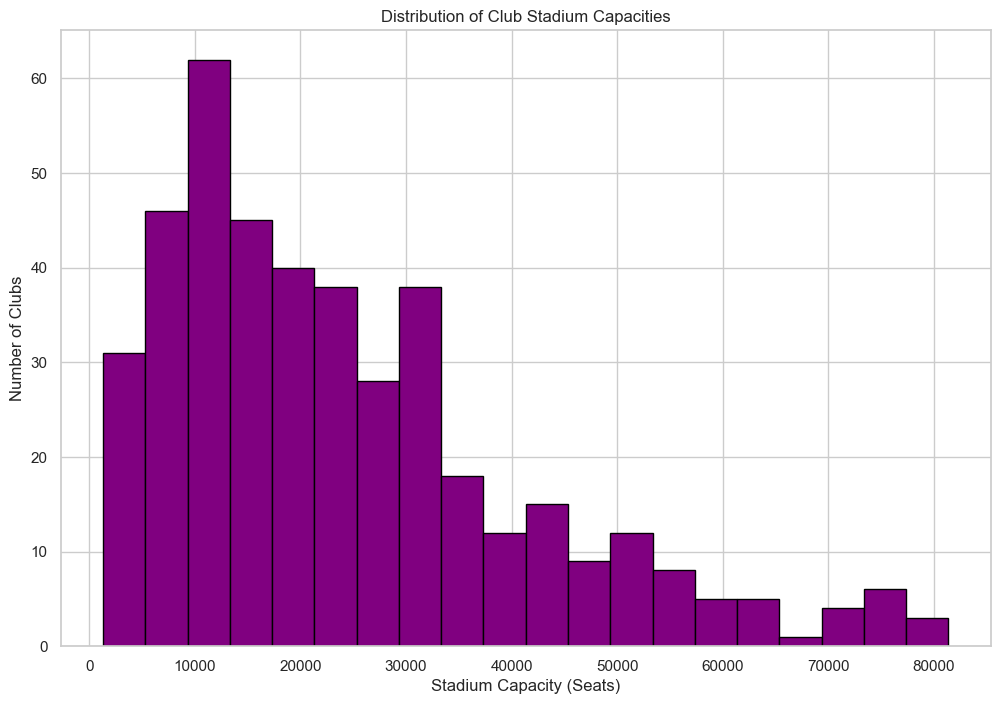

In [765]:
# Assuming your DataFrame is named clubs_df
# Plotting club stadium capacity distribution
plt.figure(figsize=(12, 8))
plt.hist(clubs_df['stadium_seats'].dropna(), bins=20, color='purple', edgecolor='black')
plt.title('Distribution of Club Stadium Capacities')
plt.xlabel('Stadium Capacity (Seats)')
plt.ylabel('Number of Clubs')
plt.show()


In [766]:
#Visualization for Player Foot Distribution

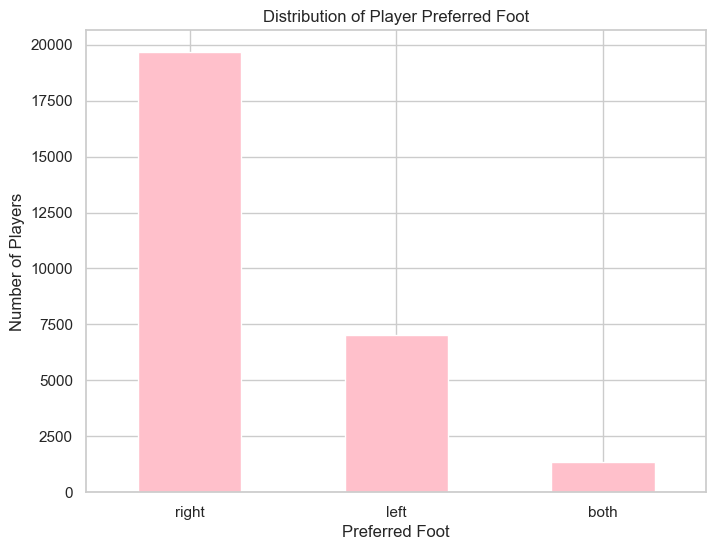

In [767]:
# Assuming your DataFrame is named players_df
# Plotting player foot distribution
plt.figure(figsize=(8, 6))
players_df['foot'].value_counts().plot(kind='bar', color='pink')
plt.title('Distribution of Player Preferred Foot')
plt.xlabel('Preferred Foot')
plt.ylabel('Number of Players')
plt.xticks(rotation=0)
plt.show()


In [768]:
# How frequent left footers are versus right footers across positions?

In [769]:
import pandas as pd
players_df_clean = players_df_clean[players_df_clean["position"] != 'Missing']

# Assuming players_df is your DataFrame
unique_positions = players_df_clean["position"].unique()

# Print or use the unique positions
print("Unique Positions:", unique_positions)


Unique Positions: ['Attack' 'Midfield' 'Goalkeeper' 'Defender']


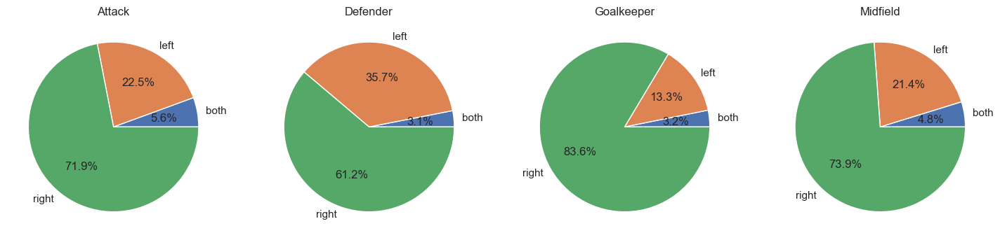

In [770]:
import pandas as pd
import matplotlib.pyplot as plt

# Assuming players_df is your DataFrame



# Group by "position" and "foot" and count the number of players
players_by_foot = players_df_clean.groupby(by=["position", "foot"]).size()

# Create a pie chart
fig, axes = plt.subplots(nrows=1, ncols=len(players_by_foot.index.levels[0]), figsize=(18, 18))

for i, pos in enumerate(players_by_foot.index.levels[0]):
    players_by_foot[pos].plot.pie(ax=axes[i], autopct='%1.1f%%', title=pos)
    axes[i].set_ylabel('')  # Remove y-axis label for better presentation

plt.show()


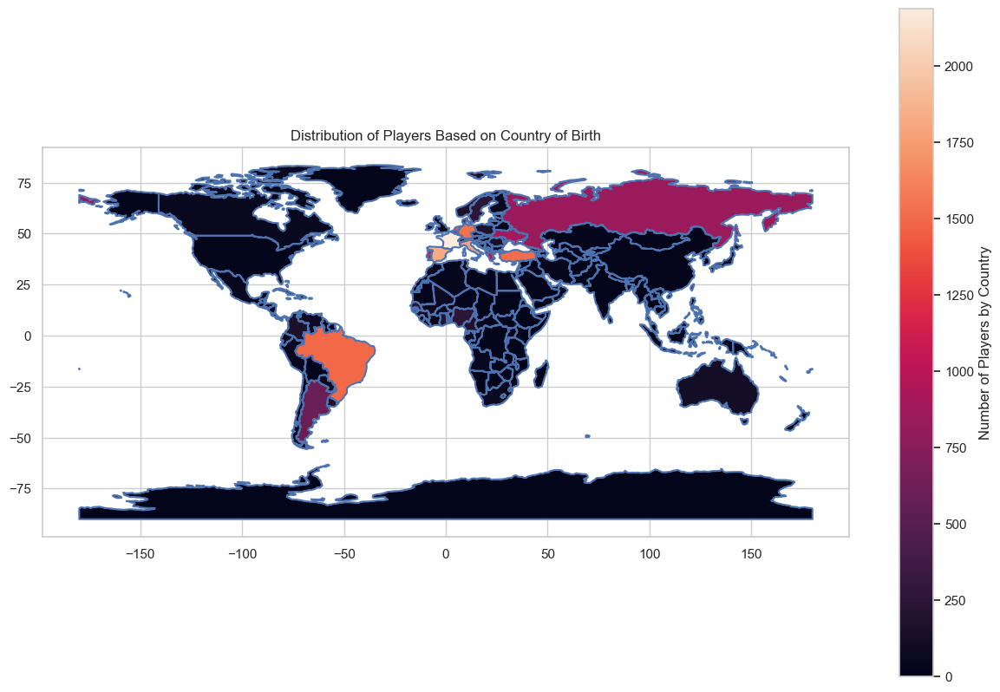

In [771]:
import geopandas as gpd
from shapely.geometry import Point
import matplotlib.pyplot as plt

# Assuming your DataFrame is named players_df
# Assuming 'country_of_birth' column contains the country names

# Load world map shapefile (you need to have the 'naturalearth_lowres' shapefile)
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))

# Count the number of players from each country
players_count_by_country = players_df['country_of_birth'].value_counts().reset_index()
players_count_by_country.columns = ['name', 'players_count']

# Merge the player count with the world map
world = world.merge(players_count_by_country, left_on='name', right_on='name', how='left')

# Fill NaN values with 0 (countries with no players)
world['players_count'] = world['players_count'].fillna(0)

# Plotting the geographical map
fig, ax = plt.subplots(1, 1, figsize=(15, 10))
world.boundary.plot(ax=ax)
world.plot(column='players_count', ax=ax, legend=True, legend_kwds={'label': "Number of Players by Country"})
plt.title('Distribution of Players Based on Country of Birth')
plt.show()


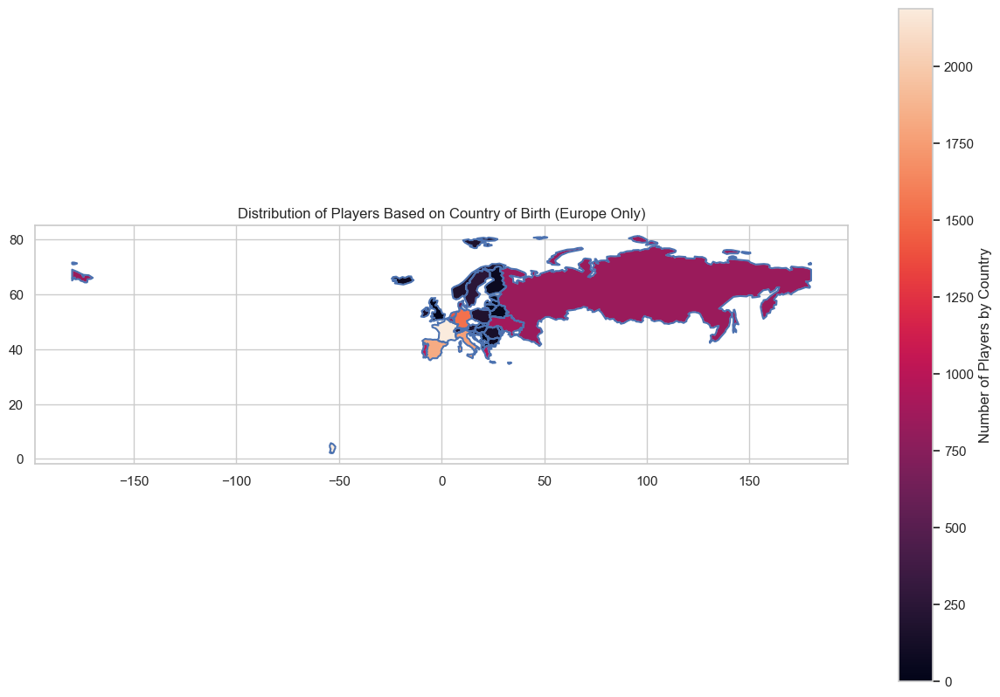

In [772]:
import geopandas as gpd
from shapely.geometry import Point
import matplotlib.pyplot as plt
from geopy.geocoders import Nominatim

# Assuming your DataFrame is named players_df
# Assuming 'country_of_birth' column contains the country names

# Load world map shapefile (you need to have the 'naturalearth_lowres' shapefile)
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))

# Filter world map to include only European countries
european_countries = ['Albania', 'Andorra', 'Austria', 'Belarus', 'Belgium', 'Bosnia and Herzegovina', 'Bulgaria', 'Croatia', 'Cyprus', 'Czech Republic', 'Denmark', 'Estonia', 'Finland', 'France', 'Germany', 'Greece', 'Hungary', 'Iceland', 'Ireland', 'Italy', 'Latvia', 'Liechtenstein', 'Lithuania', 'Luxembourg', 'Malta', 'Moldova', 'Monaco', 'Montenegro', 'Netherlands', 'North Macedonia', 'Norway', 'Poland', 'Portugal', 'Romania', 'Russia', 'San Marino', 'Serbia', 'Slovakia', 'Slovenia', 'Spain', 'Sweden', 'Switzerland', 'Ukraine', 'United Kingdom', 'Vatican City']

world = world[world['name'].isin(european_countries)]

# Count the number of players from each country
players_count_by_country = players_df['country_of_birth'].value_counts().reset_index()
players_count_by_country.columns = ['name', 'players_count']

# Merge the player count with the world map
world = world.merge(players_count_by_country, left_on='name', right_on='name', how='left')

# Fill NaN values with 0 (countries with no players)
world['players_count'] = world['players_count'].fillna(0)

# Plotting the geographical map
fig, ax = plt.subplots(1, 1, figsize=(15, 10))
world.boundary.plot(ax=ax)
world.plot(column='players_count', ax=ax, legend=True, legend_kwds={'label': "Number of Players by Country"})
plt.title('Distribution of Players Based on Country of Birth (Europe Only)')
plt.show()


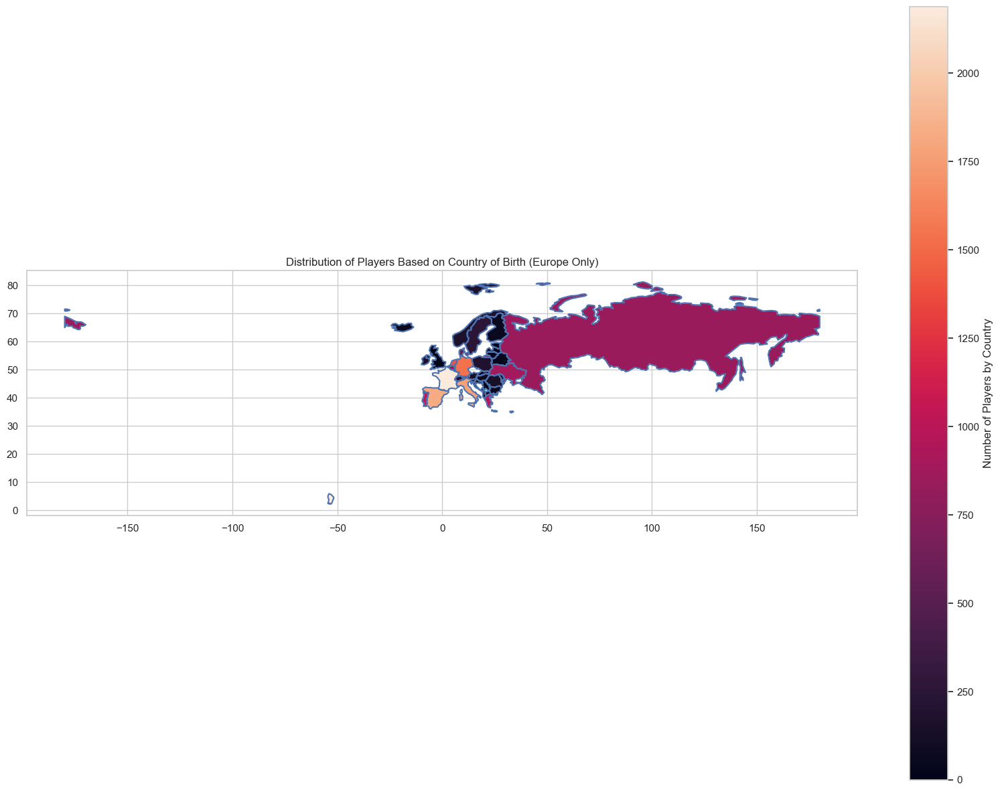

In [773]:
import geopandas as gpd
from shapely.geometry import Point
import matplotlib.pyplot as plt
from geopy.geocoders import Nominatim

# Assuming your DataFrame is named players_df
# Assuming 'country_of_birth' column contains the country names

# Load world map shapefile (you need to have the 'naturalearth_lowres' shapefile)
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))

# Filter world map to include only European countries
european_countries = ['Albania', 'Andorra', 'Austria', 'Belarus', 'Belgium', 'Bosnia and Herzegovina', 'Bulgaria', 'Croatia', 'Cyprus', 'Czech Republic', 'Denmark', 'Estonia', 'Finland', 'France', 'Germany', 'Greece', 'Hungary', 'Iceland', 'Ireland', 'Italy', 'Latvia', 'Liechtenstein', 'Lithuania', 'Luxembourg', 'Malta', 'Moldova', 'Monaco', 'Montenegro', 'Netherlands', 'North Macedonia', 'Norway', 'Poland', 'Portugal', 'Romania', 'Russia', 'San Marino', 'Serbia', 'Slovakia', 'Slovenia', 'Spain', 'Sweden', 'Switzerland', 'Ukraine', 'United Kingdom', 'Vatican City']

world = world[world['name'].isin(european_countries)]

# Count the number of players from each country
players_count_by_country = players_df['country_of_birth'].value_counts().reset_index()
players_count_by_country.columns = ['name', 'players_count']

# Merge the player count with the world map
world = world.merge(players_count_by_country, left_on='name', right_on='name', how='left')

# Fill NaN values with 0 (countries with no players)
world['players_count'] = world['players_count'].fillna(0)

# Plotting the geographical map
fig, ax = plt.subplots(figsize=(20, 15))
world.boundary.plot(ax=ax)
world.plot(column='players_count', ax=ax, legend=True, legend_kwds={'label': "Number of Players by Country"})
plt.title('Distribution of Players Based on Country of Birth (Europe Only)')
plt.show()


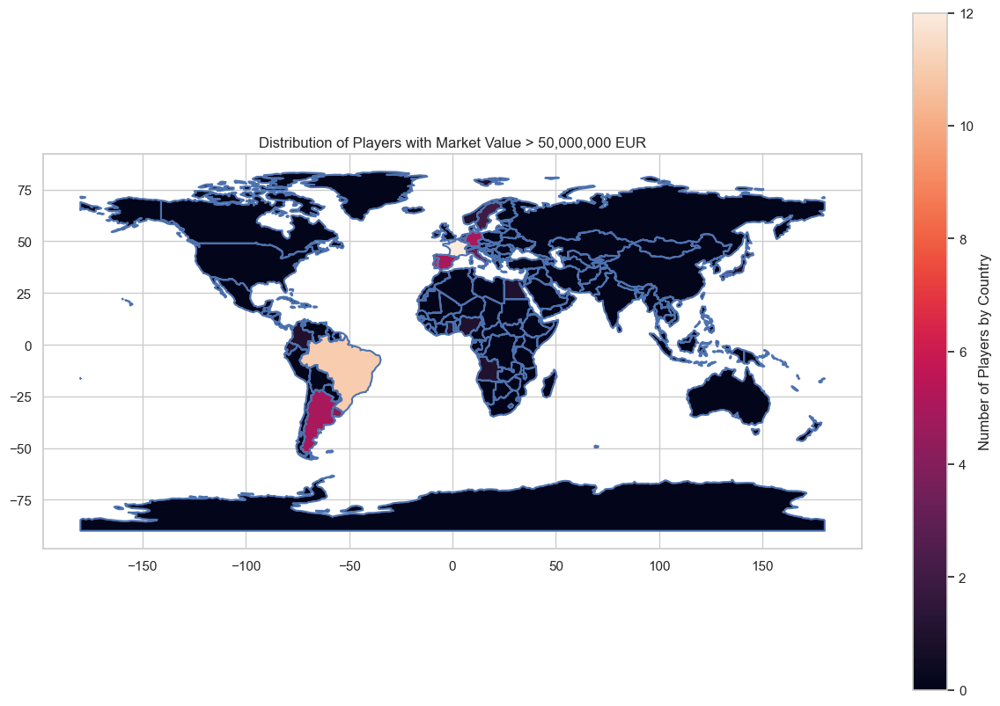

In [774]:
import geopandas as gpd
from shapely.geometry import Point
import matplotlib.pyplot as plt

# Assuming your DataFrame is named players_df
# Assuming 'country_of_birth' column contains the country names

# Filter players with market_value_in_eur greater than 50,000,000
high_value_players = players_df[players_df['market_value_in_eur'] > 50000000]

# Load world map shapefile (you need to have the 'naturalearth_lowres' shapefile)
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))

# Count the number of players from each country
players_count_by_country = high_value_players['country_of_birth'].value_counts().reset_index()
players_count_by_country.columns = ['name', 'players_count']

# Merge the player count with the world map
world = world.merge(players_count_by_country, left_on='name', right_on='name', how='left')

# Fill NaN values with 0 (countries with no players)
world['players_count'] = world['players_count'].fillna(0)

# Plotting the geographical map
fig, ax = plt.subplots(1, 1, figsize=(15, 10))
world.boundary.plot(ax=ax)
world.plot(column='players_count', ax=ax, legend=True, legend_kwds={'label': "Number of Players by Country"})
plt.title('Distribution of Players with Market Value > 50,000,000 EUR')
plt.show()


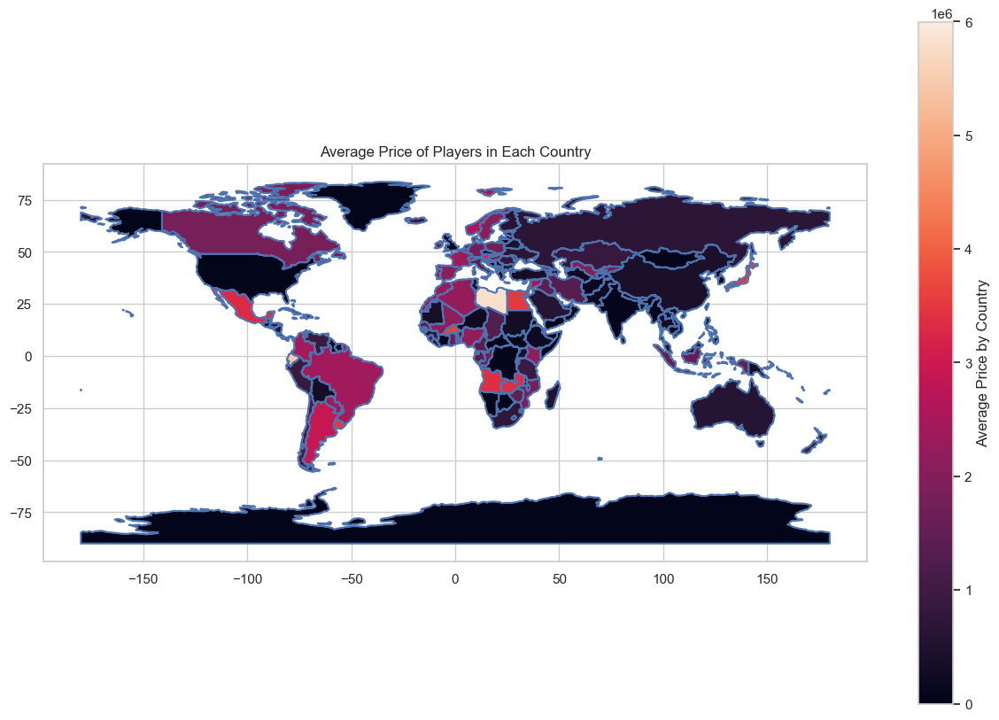

In [775]:
import geopandas as gpd
from shapely.geometry import Point
import matplotlib.pyplot as plt

# Assuming your DataFrame is named players_df
# Assuming 'country_of_birth' column contains the country names

# Load world map shapefile (you need to have the 'naturalearth_lowres' shapefile)
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))

# Group players by country and calculate the average market value for each country
average_price_by_country = players_df.groupby('country_of_birth')['market_value_in_eur'].mean().reset_index()
average_price_by_country.columns = ['name', 'average_price']

# Merge the average price with the world map
world = world.merge(average_price_by_country, left_on='name', right_on='name', how='left')

# Fill NaN values with 0 (countries with no players)
world['average_price'] = world['average_price'].fillna(0)

# Plotting the geographical map
fig, ax = plt.subplots(1, 1, figsize=(15, 10))
world.boundary.plot(ax=ax)
world.plot(column='average_price', ax=ax, legend=True, legend_kwds={'label': "Average Price by Country"})
plt.title('Average Price of Players in Each Country')
plt.show()


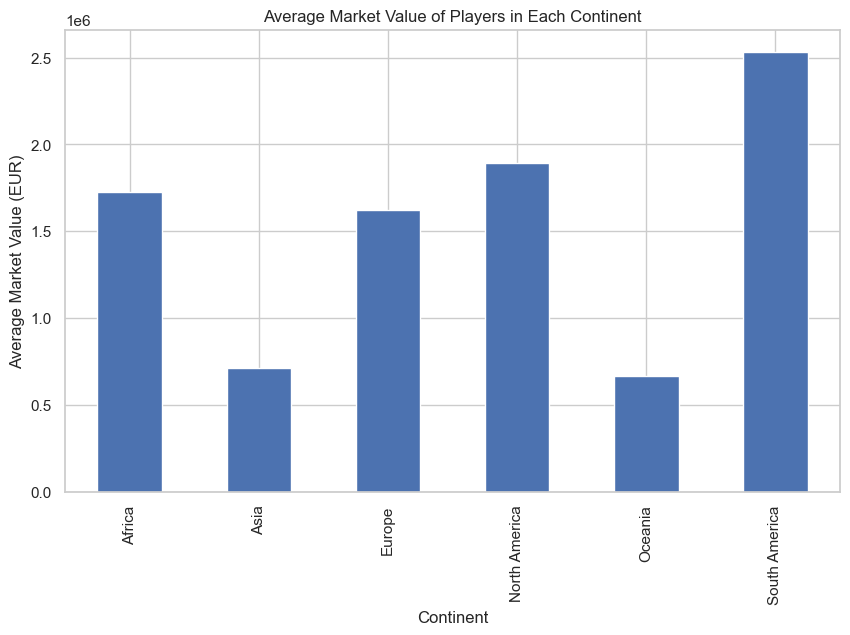

In [776]:
import geopandas as gpd
import pandas as pd

# Assuming your DataFrame is named players_df
# Assuming 'country_of_birth' column contains the country names
# Assuming 'market_value_in_eur' column contains the market value of players

# Load world map shapefile (you need to have the 'naturalearth_lowres' shapefile)
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))

# Merge the player data with the continent information
players_with_continent = pd.merge(players_df, world[['name', 'continent']], left_on='country_of_birth', right_on='name')

# Group by continent and calculate the average market value
average_market_value_by_continent = players_with_continent.groupby('continent')['market_value_in_eur'].mean().reset_index()

# Plotting the average market value for each continent
fig, ax = plt.subplots(figsize=(10, 6))
average_market_value_by_continent.plot(kind='bar', x='continent', y='market_value_in_eur', ax=ax, legend=False)
plt.title('Average Market Value of Players in Each Continent')
plt.xlabel('Continent')
plt.ylabel('Average Market Value (EUR)')
plt.show()


In [777]:
import plotly.express as px
import pandas as pd

# Assuming your DataFrame is named players_df
# Assuming 'country_of_birth' column contains the country names

# Count the number of players from each country
players_count_by_country = players_df['country_of_birth'].value_counts().reset_index()
players_count_by_country.columns = ['country', 'players_count']

# Load gapminder dataset for world map data
world = px.data.gapminder()

# Merge the player count with the world map
world = world.merge(players_count_by_country, left_on='country', right_on='country', how='left')

# Fill NaN values with 0 (countries with no players)
world['players_count'] = world['players_count'].fillna(0)

# Create an interactive choropleth map
fig = px.choropleth(world, 
                    locations='iso_alpha',  # use 'iso_alpha' for countries
                    color='players_count',
                    color_continuous_scale='Viridis',
                    title='Distribution of Players Based on Country of Birth',
                    labels={'players_count': 'Number of Players'},
                    template='plotly',
                    hover_name='country',
                    projection='natural earth'
                   )

# Show the interactive plot
fig.show()


In [778]:
#Club Compare

In [779]:
import pandas as pd

# Assuming your DataFrame is named clubs_df
# Drop the first total_market_value column
clubs_df = clubs_df.drop(columns='total_market_value', axis=1)

# Display the modified DataFrame
print(clubs_df.head())


   club_id          club_code                              name domestic_competition_id  squad_size  average_age  foreigners_number  foreigners_percentage  national_team_players                    stadium_name  stadium_seats net_transfer_record  coach_name  last_season                                           filename                                                url
0      105    sv-darmstadt-98  Sportverein Darmstadt 1898 e. V.                      L1          30         26.7                 11                   36.7                      1  Merck-Stadion am Böllenfalltor          17810             €-1.48m         NaN         2023  ../data/raw/transfermarkt-scraper/2023/clubs.j...  https://www.transfermarkt.co.uk/sv-darmstadt-9...
1    11127  ural-ekaterinburg             FK Ural Yekaterinburg                     RU1          26         28.2                 14                   53.8                      6             Yekaterinburg Arena          23000              €-770k         NaN

In [780]:
clubs_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 426 entries, 0 to 425
Data columns (total 16 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   club_id                  426 non-null    int64  
 1   club_code                426 non-null    object 
 2   name                     426 non-null    object 
 3   domestic_competition_id  426 non-null    object 
 4   squad_size               426 non-null    int64  
 5   average_age              388 non-null    float64
 6   foreigners_number        426 non-null    int64  
 7   foreigners_percentage    378 non-null    float64
 8   national_team_players    426 non-null    int64  
 9   stadium_name             426 non-null    object 
 10  stadium_seats            426 non-null    int64  
 11  net_transfer_record      426 non-null    object 
 12  coach_name               0 non-null      float64
 13  last_season              426 non-null    int64  
 14  filename                 4

In [781]:
import pandas as pd

# Assuming your DataFrames are named players_df and clubs_df

# Filter players_df for relevant columns
player_market_value = players_df[['last_season', 'current_club_id', 'market_value_in_eur']]

# Filter players with non-null market_value_in_eur
player_market_value = player_market_value.dropna(subset=['market_value_in_eur'])

# Group by club and season, summing the market values
club_market_value = player_market_value.groupby(['current_club_id', 'last_season'])['market_value_in_eur'].sum().reset_index()

# Merge the updated market values back to clubs_df
clubs_df = pd.merge(clubs_df, club_market_value, left_on=['club_id', 'last_season'], right_on=['current_club_id', 'last_season'], how='left')

# Drop unnecessary columns
clubs_df.drop(['current_club_id'], axis=1, inplace=True)

# Rename the merged column to 'total_market_value'
clubs_df.rename(columns={'market_value_in_eur': 'total_market_value'}, inplace=True)

# Fill NaN values with 0
clubs_df['total_market_value'].fillna(0, inplace=True)

# Display or use the updated clubs_df
print(clubs_df[['name', 'total_market_value']])


                                  name  total_market_value
0     Sportverein Darmstadt 1898 e. V.          41950000.0
1                FK Ural Yekaterinburg          18850000.0
2            Beşiktaş Jimnastik Kulübü         107050000.0
3           Associazione Sportiva Roma         325650000.0
4      Tottenham Hotspur Football Club         773800000.0
..                                 ...                 ...
421                   CF Os Belenenses           2750000.0
422             Football Club Volendam          13775000.0
423  Atalanta Bergamasca Calcio S.p.a.         333100000.0
424           Moreirense Futebol Clube          20300000.0
425               West Bromwich Albion          51635000.0

[426 rows x 2 columns]


In [782]:
clubs_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 426 entries, 0 to 425
Data columns (total 17 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   club_id                  426 non-null    int64  
 1   club_code                426 non-null    object 
 2   name                     426 non-null    object 
 3   domestic_competition_id  426 non-null    object 
 4   squad_size               426 non-null    int64  
 5   average_age              388 non-null    float64
 6   foreigners_number        426 non-null    int64  
 7   foreigners_percentage    378 non-null    float64
 8   national_team_players    426 non-null    int64  
 9   stadium_name             426 non-null    object 
 10  stadium_seats            426 non-null    int64  
 11  net_transfer_record      426 non-null    object 
 12  coach_name               0 non-null      float64
 13  last_season              426 non-null    int64  
 14  filename                 4

In [783]:

top_10_clubs = clubs_df.sort_values(by='total_market_value', ascending=False).head(1000)

# Print the top 10 clubs with their total market value
print(top_10_clubs[['name', 'total_market_value']].head(100))


                                                  name  total_market_value
329                      Manchester City Football Club        1.293700e+09
321                              Arsenal Football Club        1.116500e+09
233                  Paris Saint-Germain Football Club        1.049300e+09
281                         Real Madrid Club de Fútbol        1.038000e+09
392                              Chelsea Football Club        9.801000e+08
404                                  FC Bayern München        9.439500e+08
43                             Liverpool Football Club        8.746000e+08
65                               Futbol Club Barcelona        8.580000e+08
4                      Tottenham Hotspur Football Club        7.738000e+08
242                    Manchester United Football Club        7.392500e+08
166                     Newcastle United Football Club        6.417000e+08
333                          Aston Villa Football Club        6.385000e+08
79          Football Club

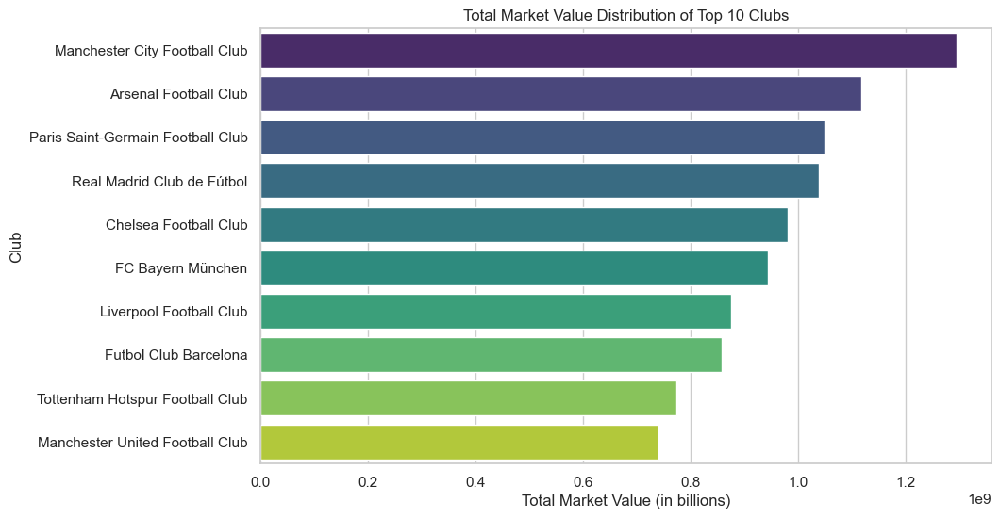

In [784]:
import matplotlib.pyplot as plt
import seaborn as sns

# Set the style for seaborn plots
sns.set(style="whitegrid")

# Filter data for the top 10 clubs based on total market value
top_10_clubs_total_value = top_10_clubs.sort_values(by='total_market_value', ascending=False).head(10)

# Plotting Total Market Value Distribution
plt.figure(figsize=(10, 6))
sns.barplot(x='total_market_value', y='name', data=top_10_clubs_total_value, palette="viridis")
plt.title('Total Market Value Distribution of Top 10 Clubs')
plt.xlabel('Total Market Value (in billions)')
plt.ylabel('Club')
plt.show()


In [785]:
# Question 2: Squad Size Comparison

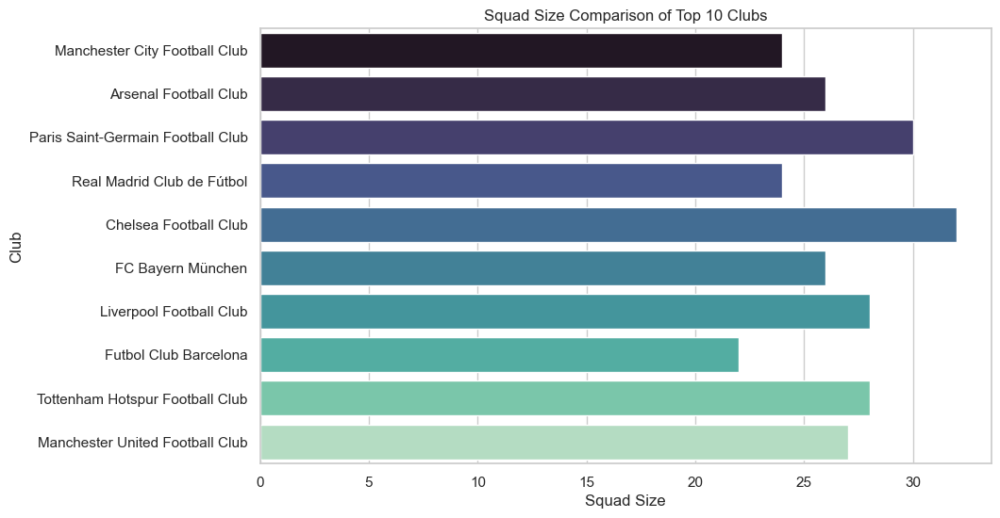

In [786]:
plt.figure(figsize=(10, 6))
sns.barplot(x='squad_size', y='name', data=top_10_clubs_total_value, palette="mako")
plt.title('Squad Size Comparison of Top 10 Clubs')
plt.xlabel('Squad Size')
plt.ylabel('Club')
plt.show()


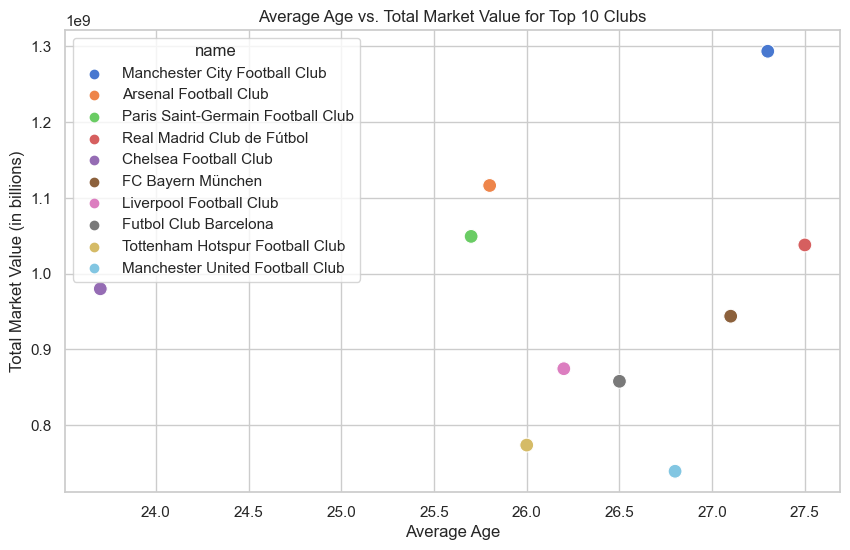

In [787]:
plt.figure(figsize=(10, 6))
sns.scatterplot(x='average_age', y='total_market_value', data=top_10_clubs_total_value, hue='name', palette="muted", s=100)
plt.title('Average Age vs. Total Market Value for Top 10 Clubs')
plt.xlabel('Average Age')
plt.ylabel('Total Market Value (in billions)')
plt.show()


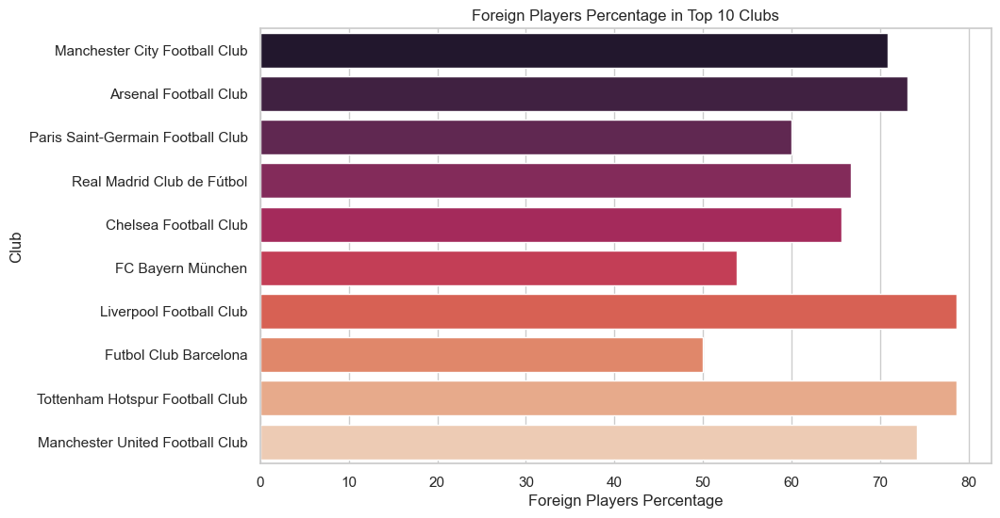

In [788]:
plt.figure(figsize=(10, 6))
sns.barplot(x='foreigners_percentage', y='name', data=top_10_clubs_total_value, palette="rocket")
plt.title('Foreign Players Percentage in Top 10 Clubs')
plt.xlabel('Foreign Players Percentage')
plt.ylabel('Club')
plt.show()


In [789]:
temp =clubs_df

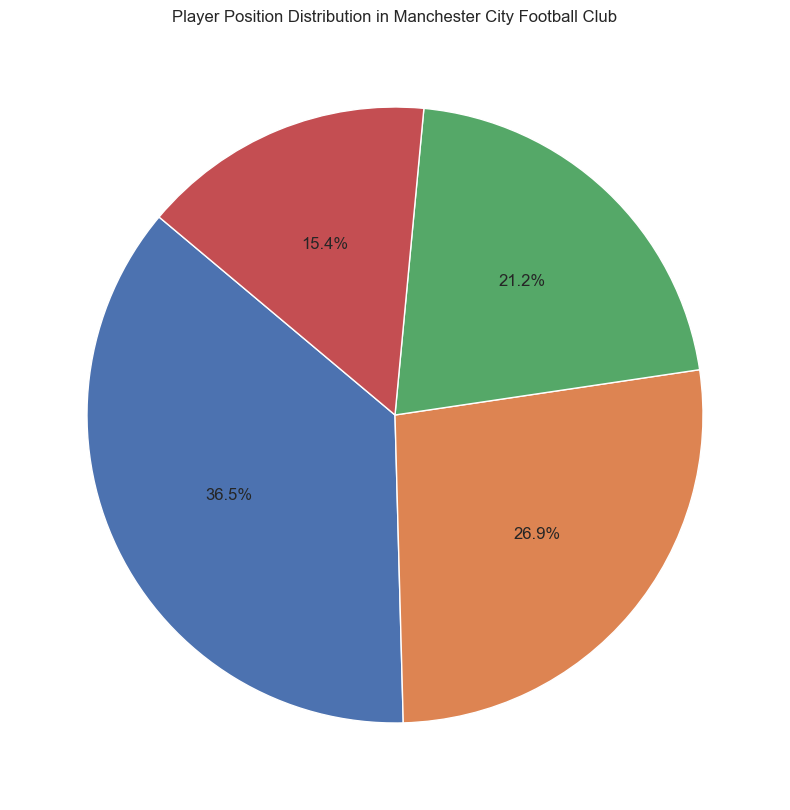

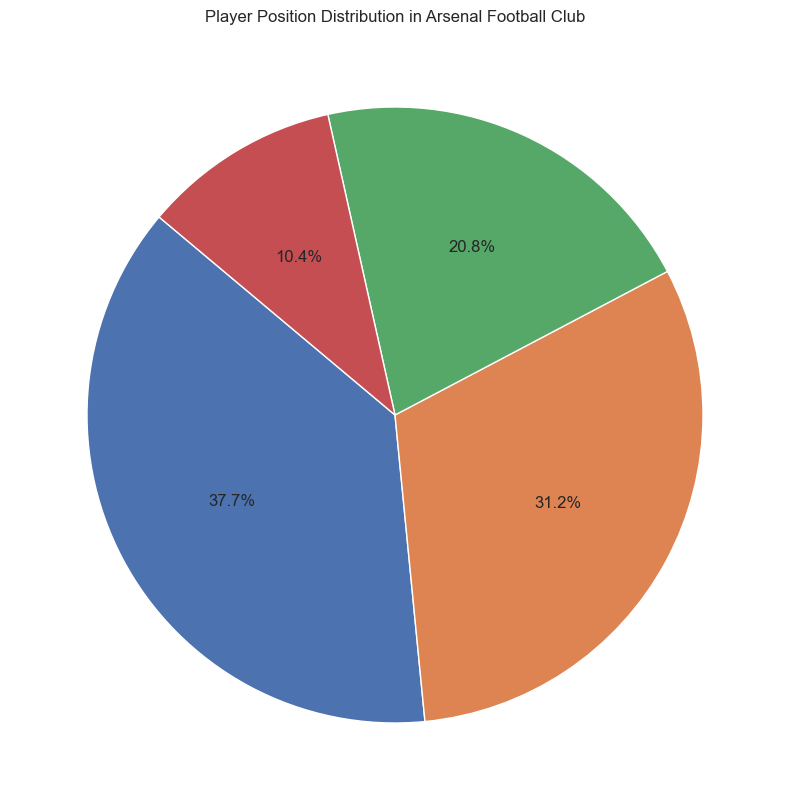

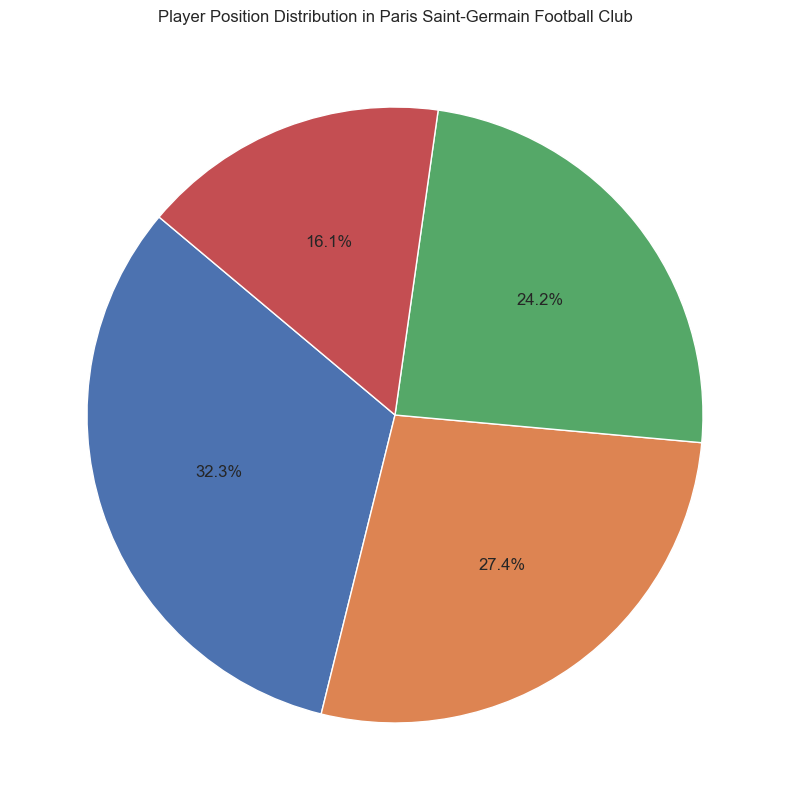

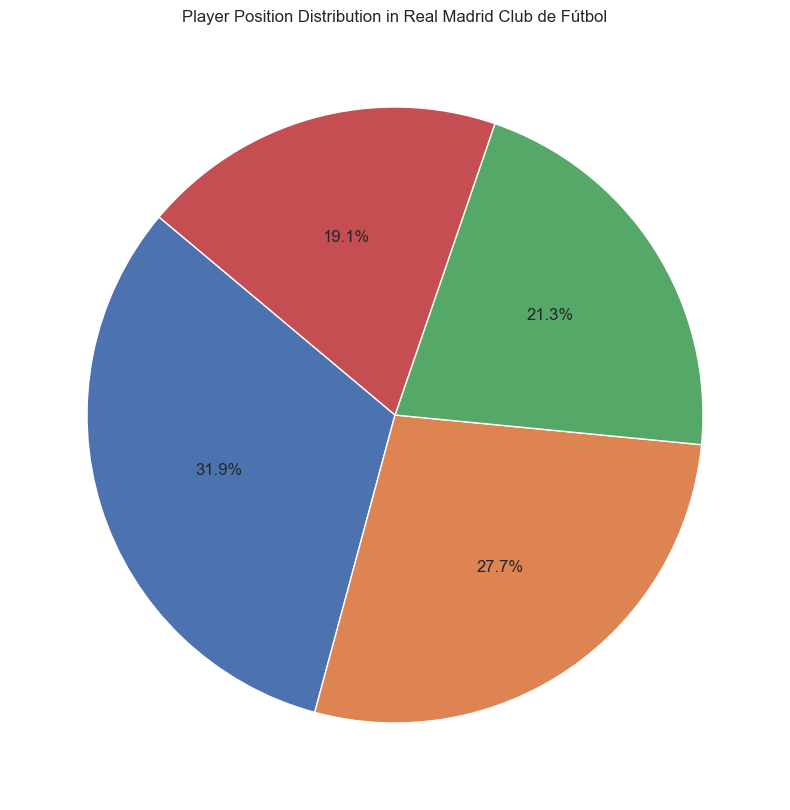

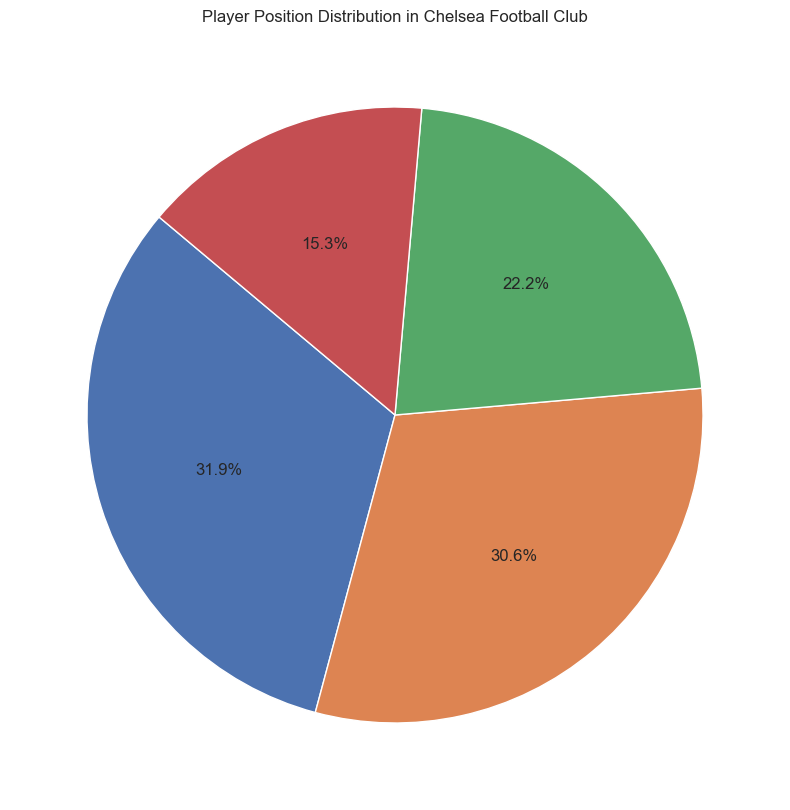

...

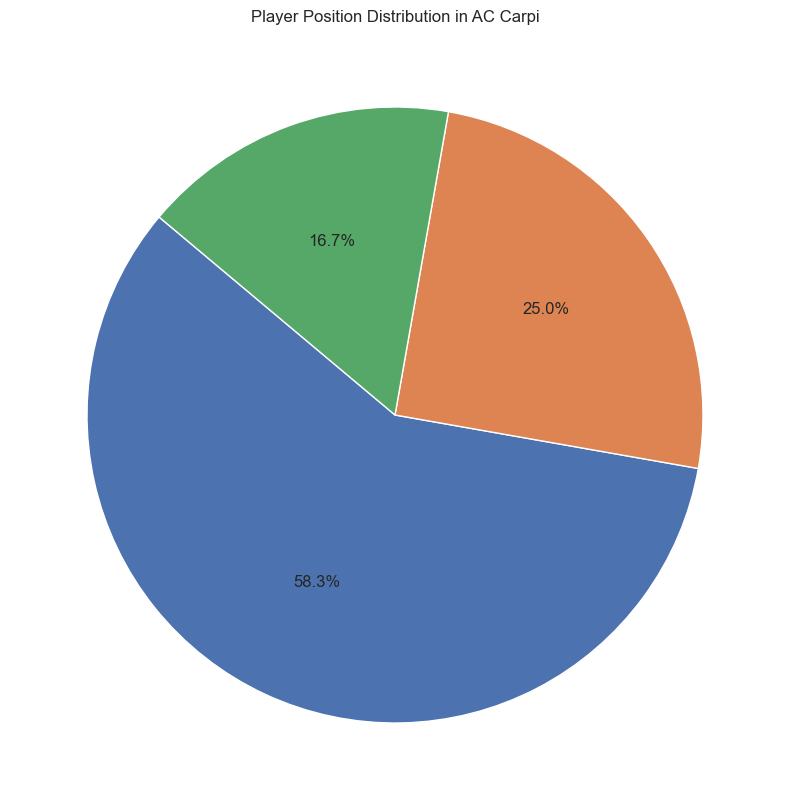

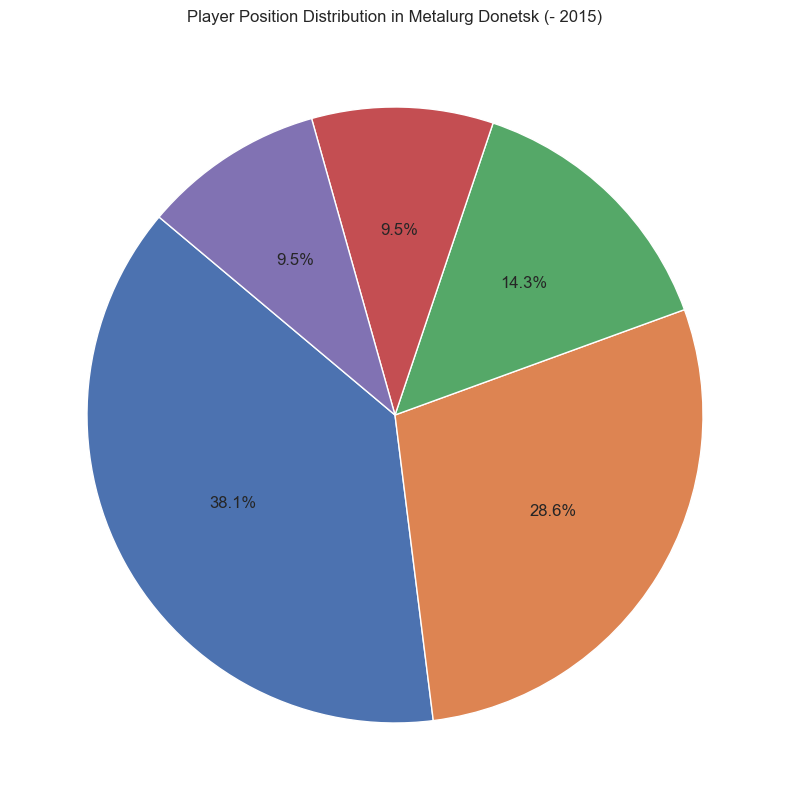

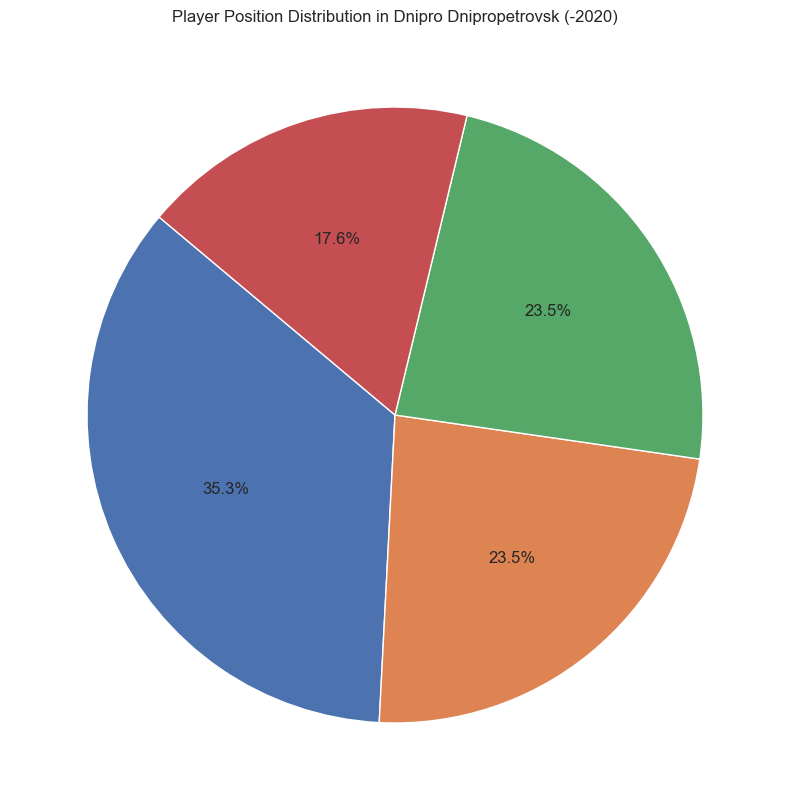

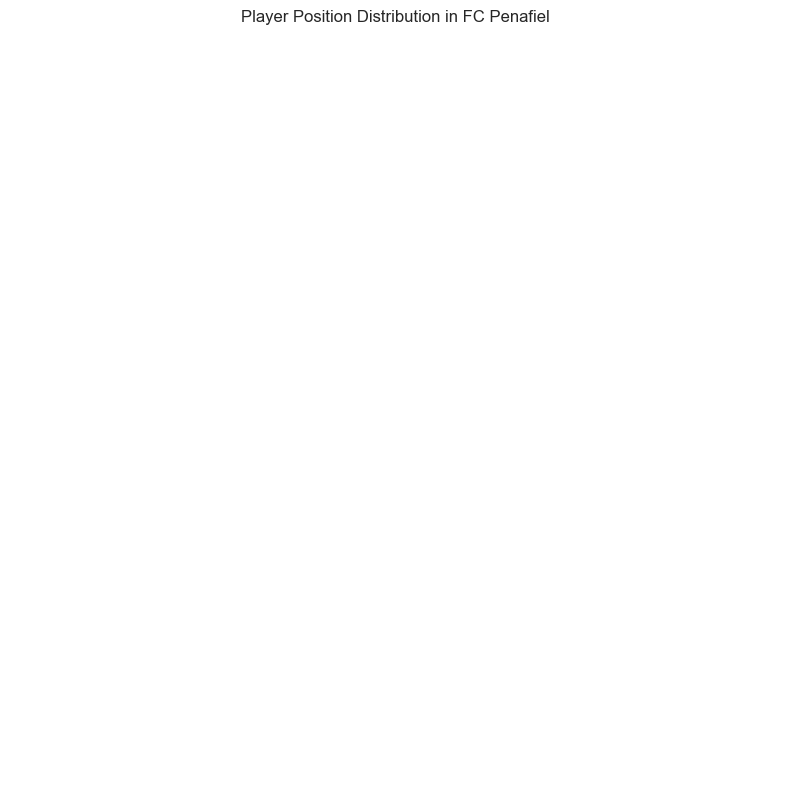

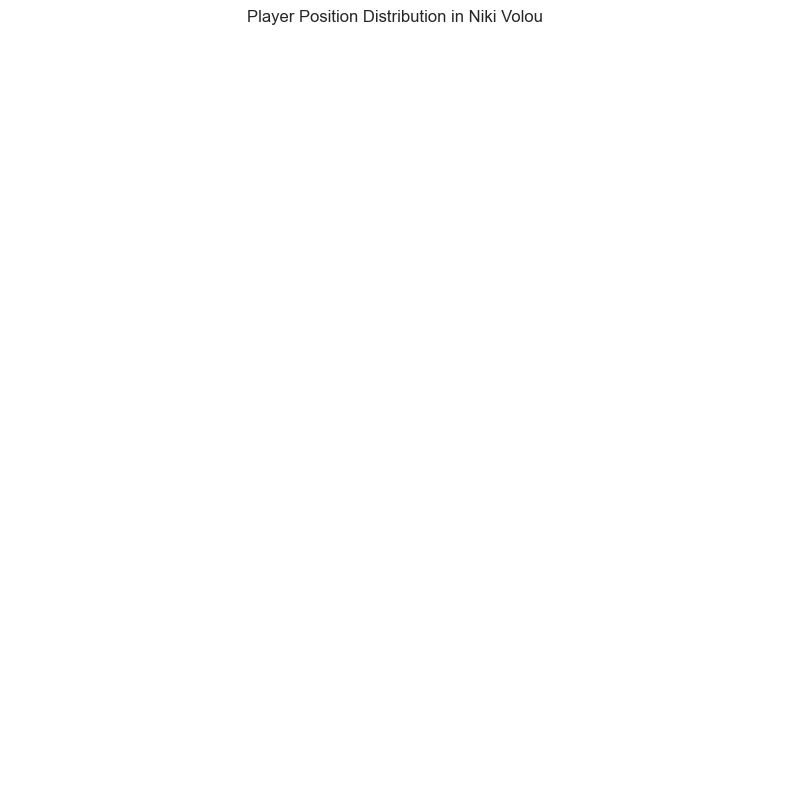

In [790]:
# Question 7: Pie chart showing the distribution of player positions in each club
plt.figure(figsize=(10, 10))
for club in top_10_clubs['name']:
    positions_dist = players_df[players_df['current_club_name'] == club]['position'].value_counts()
    plt.pie(positions_dist, labels=positions_dist.index, autopct='%1.1f%%', startangle=140, labeldistance=None)
    plt.title(f'Player Position Distribution in {club}')
    plt.show()


# Iran players.

In [791]:
#best value of iranian player of all time.


In [793]:
# Assuming players_df is your DataFrame
# Filter the DataFrame for Iranian players
iranian_players_df = players_df[players_df['country_of_citizenship'] == 'Iran']

# Sort by 'highest_market_value_in_eur' in descending order
iranian_players_df_sorted = iranian_players_df.sort_values(by='highest_market_value_in_eur', ascending=False)

# Get the top 10 players
top_10_iranian_players = iranian_players_df_sorted.head(10)

# Print the information about the top 10 Iranian players, including 'last_season'
print("Top 10 Iranian Players based on Highest Market Value:")
print(top_10_iranian_players[['name', 'highest_market_value_in_eur', 'last_season']])


Top 10 Iranian Players based on Highest Market Value:
                        name  highest_market_value_in_eur  last_season
11441          Sardar Azmoun                   25000000.0         2023
17245           Mehdi Taremi                   20000000.0         2023
13154    Alireza Jahanbakhsh                   18000000.0         2023
1137          Ashkan Dejagah                    5000000.0         2016
18145        Milad Mohammadi                    5000000.0         2023
12803          Saman Ghoddos                    5000000.0         2023
23085  Allahyar Sayyadmanesh                    4000000.0         2021
9442            Kaveh Rezaei                    4000000.0         2021
16912         Ali Gholizadeh                    4000000.0         2022
9474        Karim Ansarifard                    4000000.0         2021


# 2. Predict the price of players 

# Process Data

In [794]:
# Import modules
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import datetime as dt
import calendar
import datetime
from datetime import datetime, timedelta, date
import warnings
import os

from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.svm import SVR
from sklearn.ensemble import GradientBoostingRegressor
from sklearn import ensemble
from xgboost import XGBRegressor
from lightgbm import LGBMRegressor
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import train_test_split

#settings
pd.set_option('display.max_row', 100)
pd.set_option('display.max_columns', 1200)
pd.set_option('display.width', 1200)
warnings.filterwarnings("ignore")
%matplotlib inline

#variables
colour=['maroon','r','g','darkgreen','c','teal','b','navy','indigo','m','deeppink','orange','sienna','yellow','khaki','olive','tan','black','grey','brown']

print("Packages installed")

Packages installed


In [795]:
# Import all files in the current directory and read into dataframes
dataframes = []

# Get the current working directory
current_directory = os.getcwd()

# Look for CSV files in the current directory
for filename in os.listdir(current_directory):
    if filename.endswith(".csv"):
        file = filename.split('.')[0] + "_df"
        filepath = os.path.join(current_directory, filename)
        df = pd.read_csv(filepath, sep=",", encoding="UTF-8")
        exec(f'{file} = df.copy()')
        print(file, df.shape)
        dataframes.append(df)

print('Data imported')


appearances_df (1524941, 13)
clubs_df (426, 17)
club_games_df (132390, 11)
competitions_df (43, 10)
games_df (66195, 23)
game_events_df (681952, 10)
game_lineups_df (2304615, 9)
players_df (30396, 23)
player_valuations_df (464869, 5)
Data imported


In [796]:
clubs_df = temp

In [797]:
appearances_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1524941 entries, 0 to 1524940
Data columns (total 13 columns):
 #   Column                  Non-Null Count    Dtype 
---  ------                  --------------    ----- 
 0   appearance_id           1524941 non-null  object
 1   game_id                 1524941 non-null  int64 
 2   player_id               1524941 non-null  int64 
 3   player_club_id          1524941 non-null  int64 
 4   player_current_club_id  1524941 non-null  int64 
 5   date                    1524941 non-null  object
 6   player_name             1524940 non-null  object
 7   competition_id          1524941 non-null  object
 8   yellow_cards            1524941 non-null  int64 
 9   red_cards               1524941 non-null  int64 
 10  goals                   1524941 non-null  int64 
 11  assists                 1524941 non-null  int64 
 12  minutes_played          1524941 non-null  int64 
dtypes: int64(9), object(4)
memory usage: 151.2+ MB


In [798]:
games_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 66195 entries, 0 to 66194
Data columns (total 23 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   game_id                 66195 non-null  int64  
 1   competition_id          66195 non-null  object 
 2   season                  66195 non-null  int64  
 3   round                   66195 non-null  object 
 4   date                    66195 non-null  object 
 5   home_club_id            66195 non-null  int64  
 6   away_club_id            66195 non-null  int64  
 7   home_club_goals         66195 non-null  int64  
 8   away_club_goals         66195 non-null  int64  
 9   home_club_position      46460 non-null  float64
 10  away_club_position      46459 non-null  float64
 11  home_club_manager_name  65451 non-null  object 
 12  away_club_manager_name  65451 non-null  object 
 13  stadium                 65982 non-null  object 
 14  attendance              56539 non-null

In [799]:
player_valuations_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 464869 entries, 0 to 464868
Data columns (total 5 columns):
 #   Column                               Non-Null Count   Dtype 
---  ------                               --------------   ----- 
 0   player_id                            464869 non-null  int64 
 1   date                                 464869 non-null  object
 2   market_value_in_eur                  464869 non-null  int64 
 3   current_club_id                      464869 non-null  int64 
 4   player_club_domestic_competition_id  464869 non-null  object
dtypes: int64(3), object(2)
memory usage: 17.7+ MB


In [800]:
# Calculate the age of each player
players_df['date_of_birth'] = pd.to_datetime(players_df['date_of_birth'])
# drop players with no date of birth
players_df = players_df[players_df['date_of_birth'].isnull() == False]
now = datetime.now()
players_df['age'] = (now - players_df['date_of_birth']).apply(lambda x: x.days) / 365.25
players_df['age'] = players_df['age'].round().astype(int) 

# Calculate the contract remaining of each player
players_df['contract_expiration_date'] = pd.to_datetime(players_df['contract_expiration_date'])
# drop players with no date of birth
players_df = players_df[players_df['contract_expiration_date'].isnull() == False]
now = datetime.now()
players_df['term_days_remaining'] = (players_df['contract_expiration_date']- now).apply(lambda x: x.days) 

# add year to player valuations
player_valuations_df['date']=pd.to_datetime(player_valuations_df['date'], format="%Y-%m-%d")
player_valuations_df['year']=player_valuations_df['date'].dt.year

# add year to player appearances
appearances_df['datetime']=pd.to_datetime(appearances_df['date'], format="%Y-%m-%d")
appearances_df['year']=appearances_df['datetime'].dt.year

#add position to player valuations
position_df=players_df.copy()
position_df=position_df.drop(['name', 'current_club_id', 'current_club_name', 'country_of_citizenship', 'country_of_birth', 'city_of_birth', 'date_of_birth', 'foot', 'height_in_cm', 'market_value_in_eur', 'highest_market_value_in_eur', 'agent_name', 'contract_expiration_date', 'current_club_domestic_competition_id', 'first_name', 'last_name', 'player_code', 'image_url', 'last_season', 'url', 'age'], axis=1)
player_valuations_df=player_valuations_df.merge(position_df, left_on='player_id', right_on='player_id')

#add position to appearances
value_df=players_df.copy()
value_df=value_df.drop(['name', 'current_club_id', 'current_club_name', 'country_of_citizenship', 'country_of_birth', 'city_of_birth', 'date_of_birth', 'foot', 'height_in_cm', 'sub_position', 'highest_market_value_in_eur', 'agent_name', 'contract_expiration_date', 'current_club_domestic_competition_id', 'first_name', 'last_name', 'player_code', 'image_url', 'last_season', 'url', 'age'], axis=1)
appearances_df1=value_df.merge(appearances_df, left_on='player_id', right_on='player_id')

print("Data processing complete")

Data processing complete


# Player Valuation Data Visualization

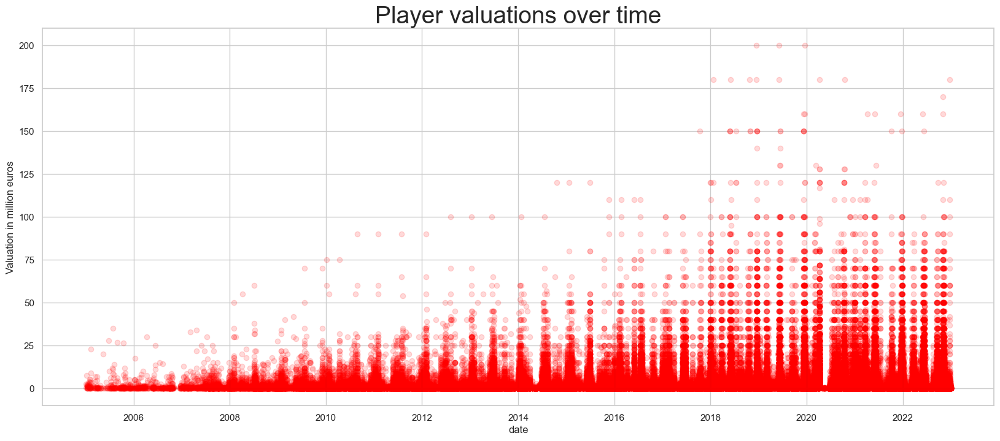

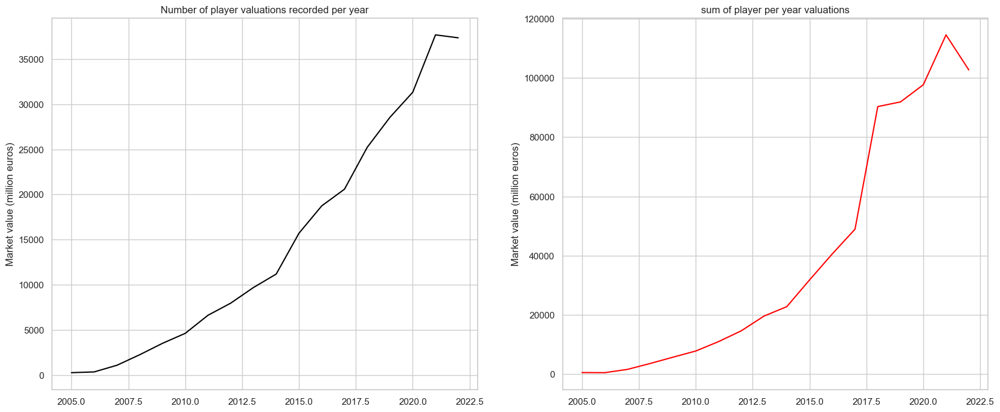

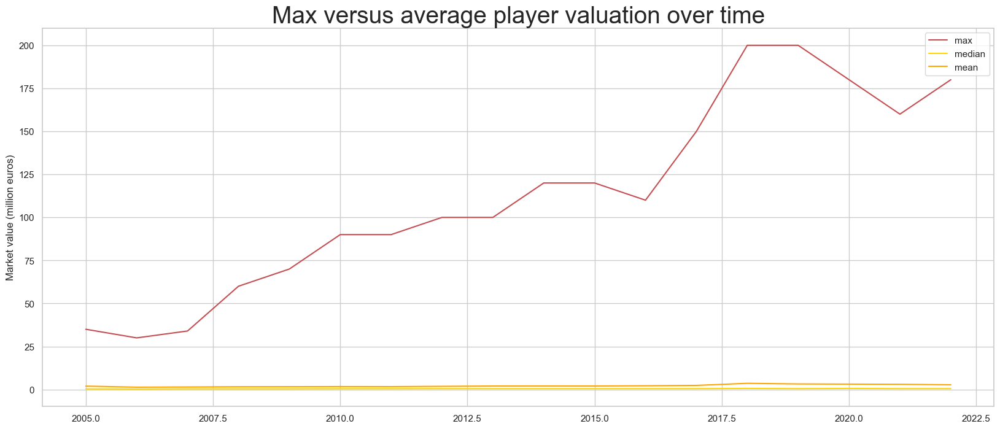

In [801]:
#filter range
player_valuations_df = player_valuations_df[(player_valuations_df.year > 2004 ) & (player_valuations_df.year < 2023 )]
high_value_player_valuations_df = player_valuations_df[(player_valuations_df.market_value_in_eur > 40000000 )]
positions=players_df.position.unique()

# Lookat data
#print(player_valuations_df.columns)

# Visualize of valuation data over time
plt.figure(figsize=(20,8))
plt.scatter(player_valuations_df['date'],y=player_valuations_df['market_value_in_eur']/1000000, c='red',alpha=0.15)
plt.xlabel('date');plt.ylabel('Valuation in million euros')
plt.title('Player valuations over time',fontsize=28)
plt.show()

# Visualize of valuation data over time
f = plt.figure(figsize=(20,8))
ax = f.add_subplot(121)
ax2 = f.add_subplot(122)
yeargroups1 = player_valuations_df.loc[:,['market_value_in_eur', 'year']].groupby(['year']).count() \
    .sort_values(by='year', ascending=True)
yeargroups2 = player_valuations_df.loc[:,['market_value_in_eur', 'year']] .groupby(['year']).sum() \
    .sort_values(by='year', ascending=True)
yeargroups3 = player_valuations_df.loc[:,['market_value_in_eur', 'year']].groupby(['year']).max() \
    .sort_values(by='year', ascending=True)
yeargroups4 = player_valuations_df.loc[:,['market_value_in_eur', 'year']] .groupby(['year']).min() \
    .sort_values(by='year', ascending=True)
yeargroups5 = player_valuations_df.loc[:,['market_value_in_eur', 'year']].groupby(['year']).median() \
    .sort_values(by='year', ascending=True)
yeargroups6 = player_valuations_df.loc[:,['market_value_in_eur', 'year']].groupby(['year']).mean() \
    .sort_values(by='year', ascending=True)

plt.subplot(1, 2, 1)                 
plt.title('Number of player valuations recorded per year')
plt.plot(yeargroups1.index,yeargroups1,color='black')
plt.ylabel('Market value (million euros)')
plt.subplot(1, 2, 2)
plt.title('sum of player per year valuations')
plt.plot(yeargroups2.index,yeargroups2/1000000,color='red')
plt.ylabel('Market value (million euros)')
plt.show()
plt.figure(figsize=(20,8))
plt.title('Max versus average player valuation over time',fontsize=28)
plt.plot(yeargroups3.index,yeargroups3/1000000,color='r',label='max')
plt.plot(yeargroups5.index,yeargroups5/1000000,color='Gold',label='median')
plt.plot(yeargroups6.index,yeargroups6/1000000,color='Orange',label='mean')
plt.ylabel('Market value (million euros)')
plt.legend()
plt.show()


## Observations on market value timeline data

The scatter plot of player valuations over the period 2006 to 2022 shows that the value of players has generally risen over time. The plot shows that the vast majority of players are at the lower end of the scale below the 50 million euros mark. 

Separating player values in attack,midfield,defence and goal keeper positions shows attacking positions generally achieve the highest values while goal keepers command lower values. 

There appears to be a shift around 2018 in where values at the higher end of the scale in most positions rose dramatically, this appears to have peaked and come down a little to 2022 rates.

# Player Data Visualization

Explorator data visualizations relating to players who's last season played was 2022 or 2023 with a market value of greater that 15 million euros.

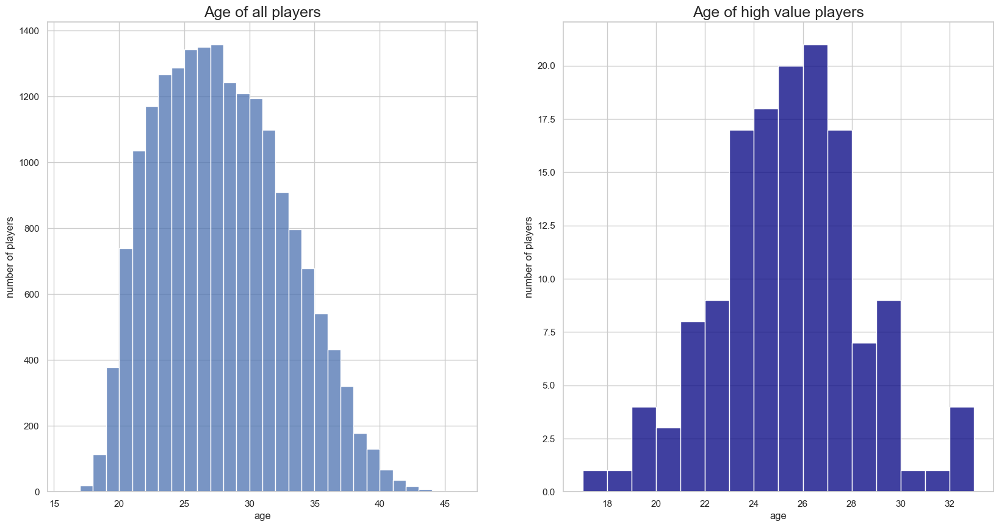

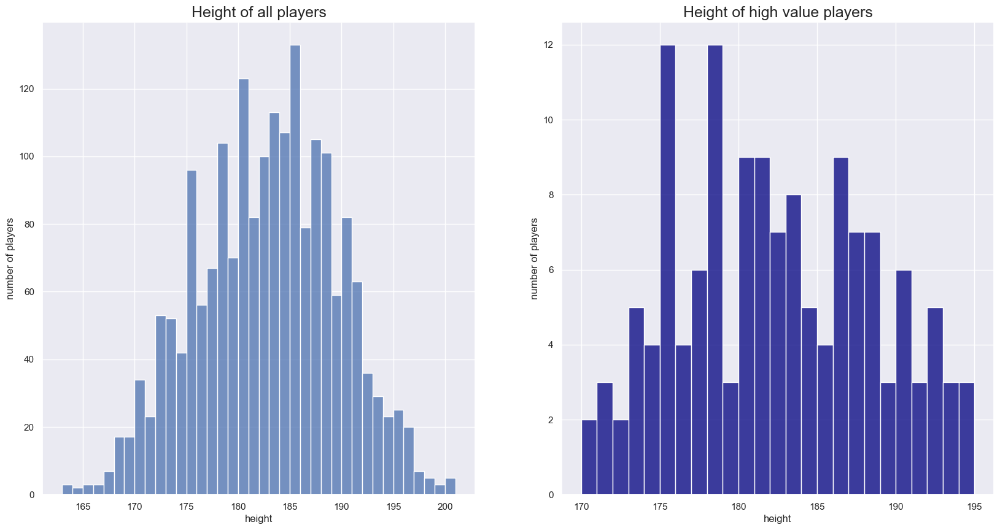

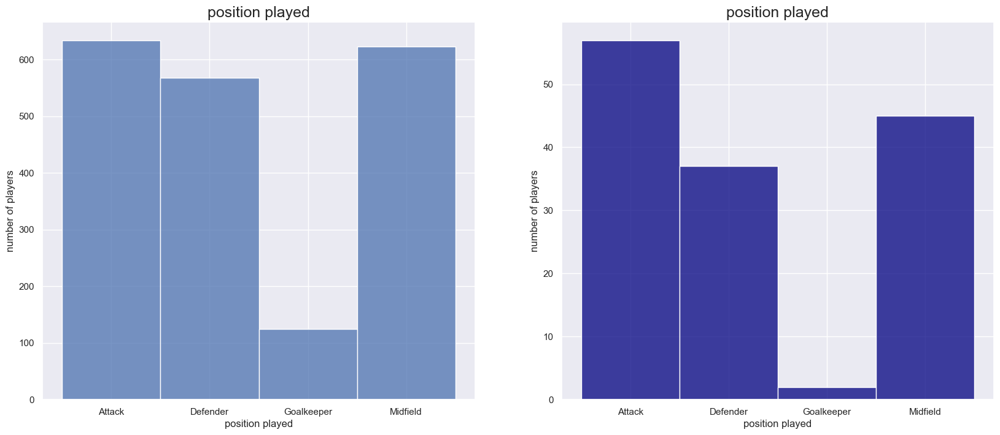

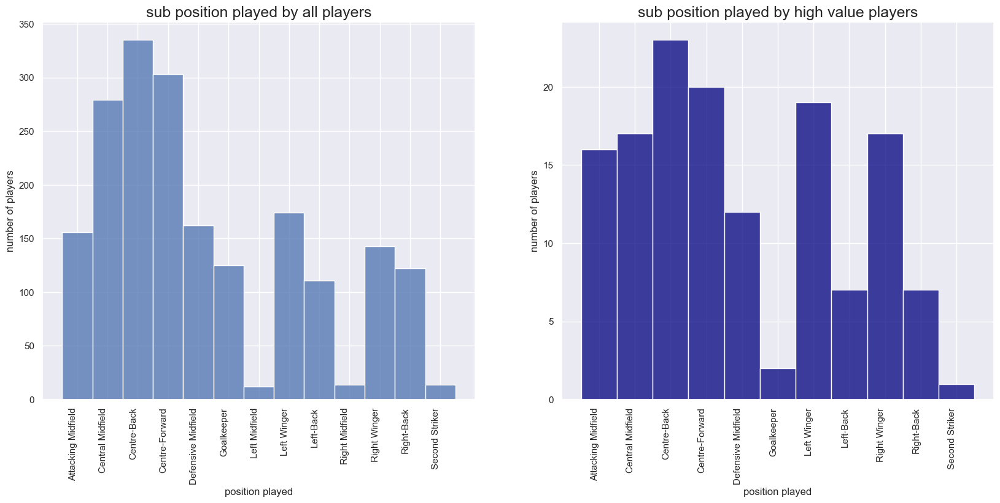

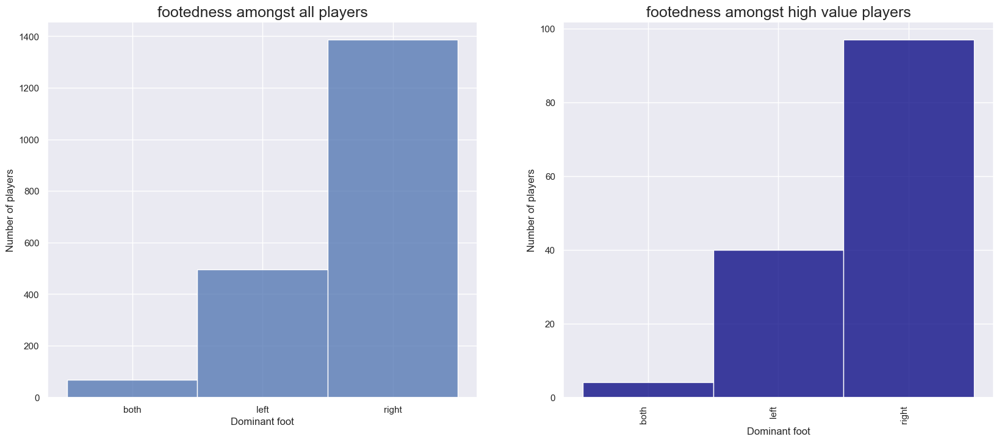

In [802]:
#overview of player dataset
#remove players with no Market Value
players_df1 = players_df[players_df.highest_market_value_in_eur.isnull() == False]
#order by Market Value
players_df1 = players_df1.sort_values("highest_market_value_in_eur", ascending = False)
#filter by season and value
players_df1 = players_df[players_df['last_season'] >= 2021]
players_df1 = players_df1[players_df1['highest_market_value_in_eur'] >= 10000000]
high_value_players_df = players_df1[(players_df1.market_value_in_eur > 40000000 )]
positions=players_df.position.unique()

# Show player age distribution
f = plt.figure(figsize=(20,10))
ax = f.add_subplot(121)
ax2 = f.add_subplot(122)
plt.subplot(1, 2, 1)
sns.set(rc={'figure.figsize':(20,10)})
sns.histplot(x='age',data=players_df, binwidth=1,color='b')
plt.title("Age of all players",fontsize=18)
plt.xlabel('age'); plt.ylabel('number of players')
plt.subplot(1, 2, 2)
sns.histplot(x='age',data=high_value_players_df, binwidth=1,color='navy')
plt.title("Age of high value players",fontsize=18)
plt.xlabel('age'); plt.ylabel('number of players')

# Show player height distribution
players_df3 = players_df1[players_df1.height_in_cm.isnull() == False]
f = plt.figure(figsize=(20,10))
ax = f.add_subplot(121)
ax2 = f.add_subplot(122)
plt.subplot(1, 2, 1)
sns.set(rc={'figure.figsize':(20,10)})
sns.histplot(x='height_in_cm',data=players_df3, binwidth=1,color='b')
plt.title("Height of all players",fontsize=18)
plt.xlabel('height'); plt.ylabel('number of players')
plt.subplot(1, 2, 2)
sns.histplot(x='height_in_cm',data=high_value_players_df, binwidth=1,color='navy')
plt.title("Height of high value players",fontsize=18)
plt.xlabel('height'); plt.ylabel('number of players')

# Show position data
players_df1 = players_df1.sort_values("position", ascending = True)
high_value_players_df1 = high_value_players_df.sort_values("position", ascending = True)
f = plt.figure(figsize=(20,8))
ax = f.add_subplot(121)
ax2 = f.add_subplot(122)
plt.subplot(1, 2, 1)
plt.title("position played",fontsize=18);plt.grid(True)
sns.histplot(x='position',data=players_df1, binwidth=1,color='b')
plt.xlabel('position played'); plt.ylabel('number of players')
plt.subplot(1, 2, 2)
sns.histplot(x='position',data=high_value_players_df1, binwidth=1,color='navy')
plt.title("position played",fontsize=18);plt.grid(True)
plt.xlabel('position played'); plt.ylabel('number of players')

# Show subposition data
players_df1 = players_df1.sort_values("sub_position", ascending = True)
high_value_players_df1 = high_value_players_df.sort_values("sub_position", ascending = True)
f = plt.figure(figsize=(20,8))
ax = f.add_subplot(121)
ax2 = f.add_subplot(122)
plt.subplot(1, 2, 1)
sns.histplot(x='sub_position',data=players_df1, binwidth=1,color='b')
plt.title("sub position played by all players",fontsize=18);plt.grid(True)
plt.xlabel('position played'); plt.ylabel('number of players')
plt.xticks(rotation=90, ha='right');
plt.subplot(1, 2, 2)
sns.histplot(x='sub_position',data=high_value_players_df1, binwidth=1,color='navy')
plt.title("sub position played by high value players",fontsize=18);plt.grid(True)
plt.xlabel('position played'); plt.ylabel('number of players')
plt.xticks(rotation=90, ha='right');

# Show  footedness data
players_df1 = players_df1.sort_values("foot", ascending = True)
high_value_players_df1 = high_value_players_df1.sort_values("foot", ascending = True)
f = plt.figure(figsize=(20,8))
ax = f.add_subplot(121)
ax2 = f.add_subplot(122)
plt.subplot(1, 2, 1)
sns.histplot(x='foot',data=players_df1, binwidth=1,color='b')
plt.title("footedness amongst all players",fontsize=18);plt.grid(True)
plt.xlabel('Dominant foot'); plt.ylabel('Number of players')
plt.subplot(1, 2, 2)
sns.histplot(x='foot',data=high_value_players_df1, binwidth=1,color='navy')
plt.title("footedness amongst high value players",fontsize=18);plt.grid(True)
plt.xlabel('Dominant foot'); plt.ylabel('Number of players')
plt.xticks(rotation=90, ha='right');

## Observations on player data visualizations

Generally the distibutions of age is a skewed normal distribution and height is a normal distribution.
Distibutions amongst high value players appear to be reflective of values within the entire dataset.

# Appearance Visualizations

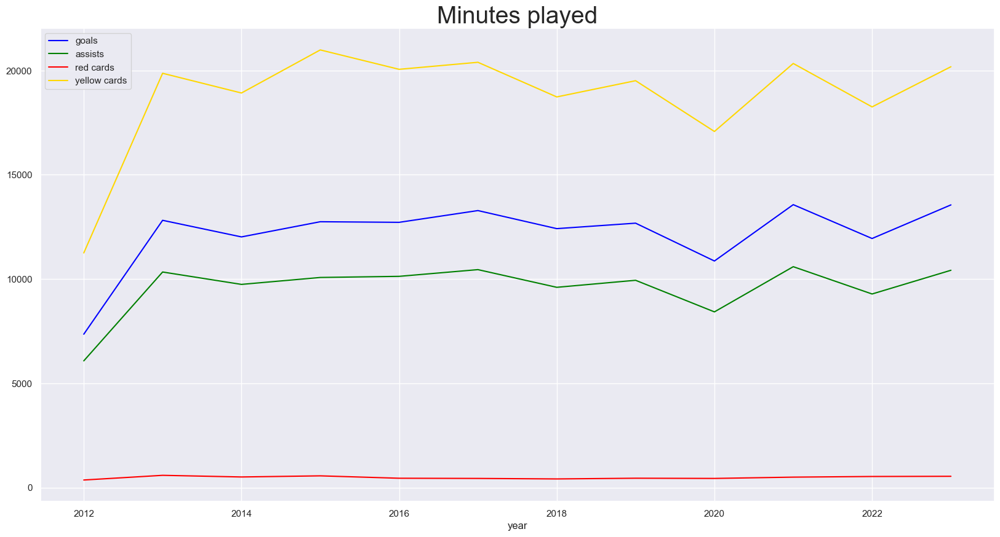

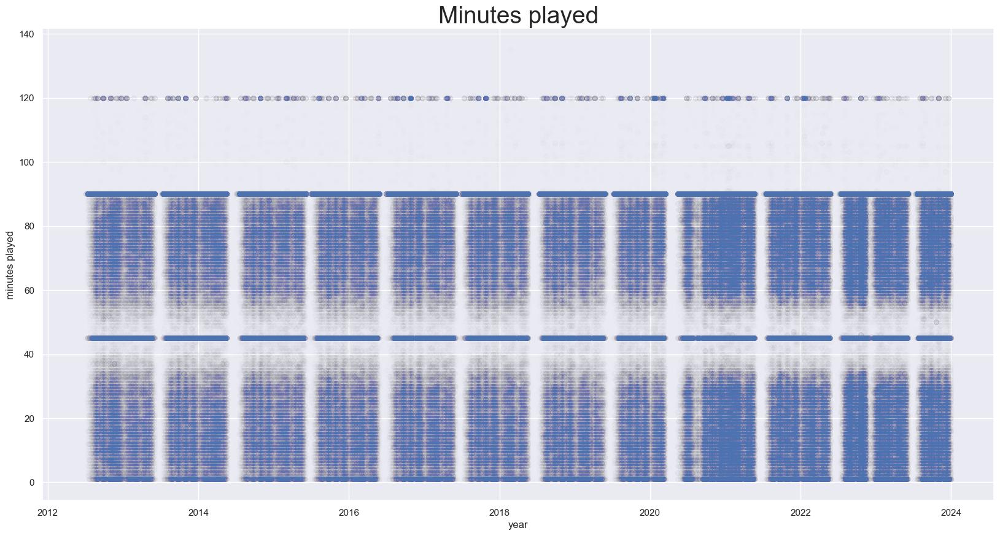

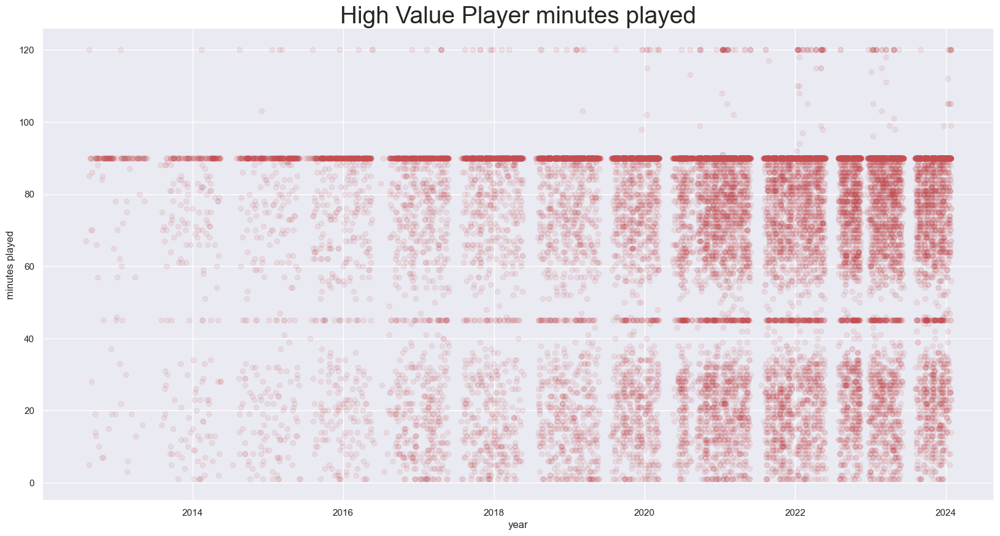

In [803]:
#print(appearances_df.columns); print(appearances_df.shape)

#filter range
appearances_df = appearances_df[(appearances_df.year > 2004 ) & (appearances_df.year <= 2023 )]
high_value_appearances_df = appearances_df1[(appearances_df1.market_value_in_eur > 40000000 )]

#Goals, assists and cards
yeargroups1 = appearances_df.loc[:,['goals', 'year']].groupby(['year']).sum().sort_values(by='year', ascending=True)
yeargroups2 = appearances_df.loc[:,['assists', 'year']].groupby(['year']).sum().sort_values(by='year', ascending=True)
yeargroups3 = appearances_df.loc[:,['red_cards', 'year']].groupby(['year']).sum().sort_values(by='year', ascending=True)
yeargroups4 = appearances_df.loc[:,['yellow_cards', 'year']].groupby(['year']).sum().sort_values(by='year', ascending=True)
plt.plot(yeargroups1.index,yeargroups1,color='blue',label='goals')
plt.plot(yeargroups2.index,yeargroups2,color='green',label='assists')
plt.plot(yeargroups3.index,yeargroups3,color='red',label='red cards')
plt.plot(yeargroups4.index,yeargroups4,color='gold',label='yellow cards')
plt.xlabel("year")
plt.title('Minutes played',fontsize=28);plt.legend()
plt.show()

# Explore minutes played
plt.scatter(appearances_df['datetime'],y=appearances_df['minutes_played'],alpha=0.0025,color='b')
plt.xlabel("year");plt.ylabel('minutes played')
plt.title('Minutes played',fontsize=28)
plt.show()

# Explore minutes played
plt.scatter(high_value_appearances_df['datetime'],y=high_value_appearances_df['minutes_played'],alpha=0.1,color='r')
plt.xlabel("year");plt.ylabel('minutes played')
plt.title('High Value Player minutes played',fontsize=28)
plt.show()

# Game Visualizations

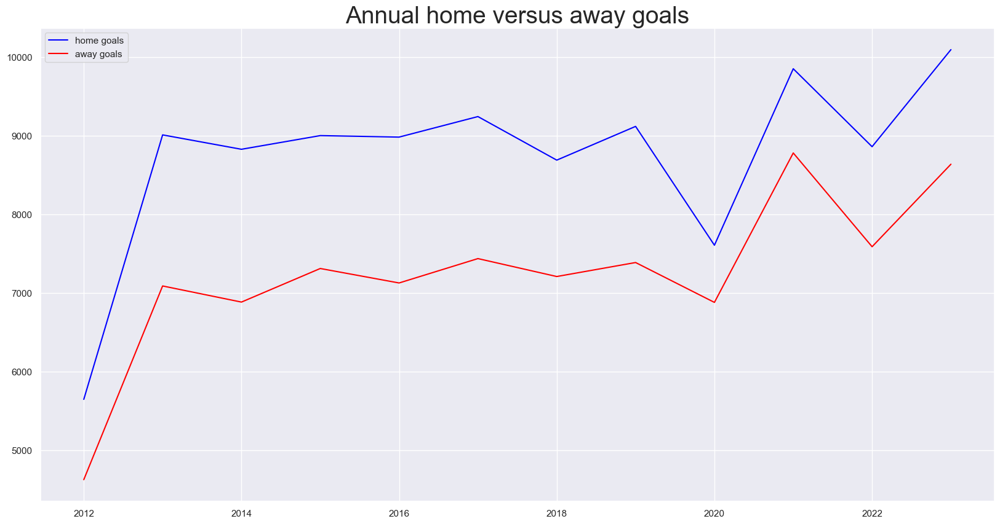

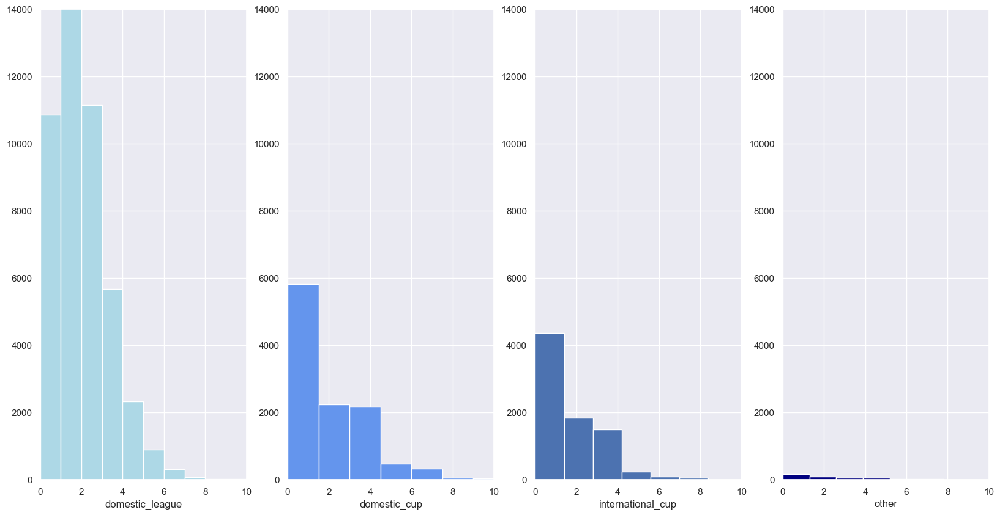

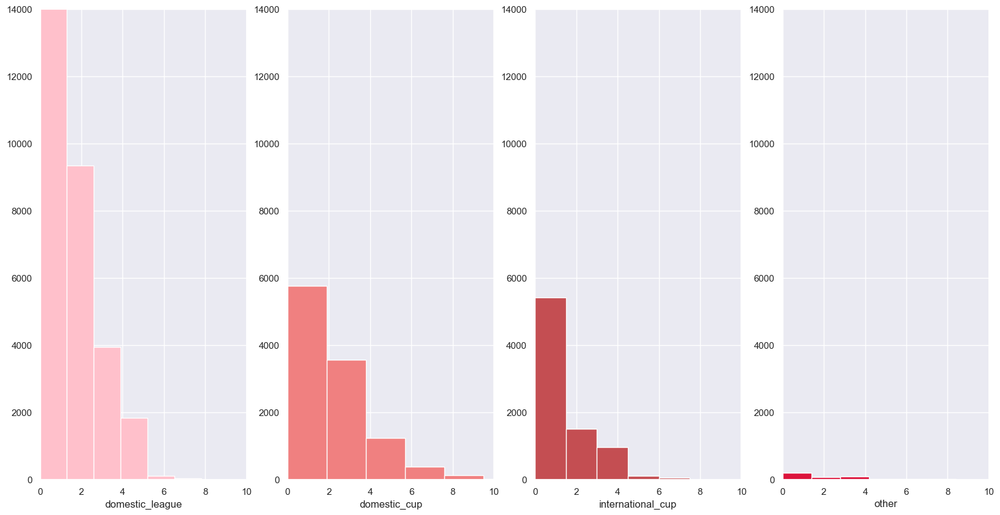

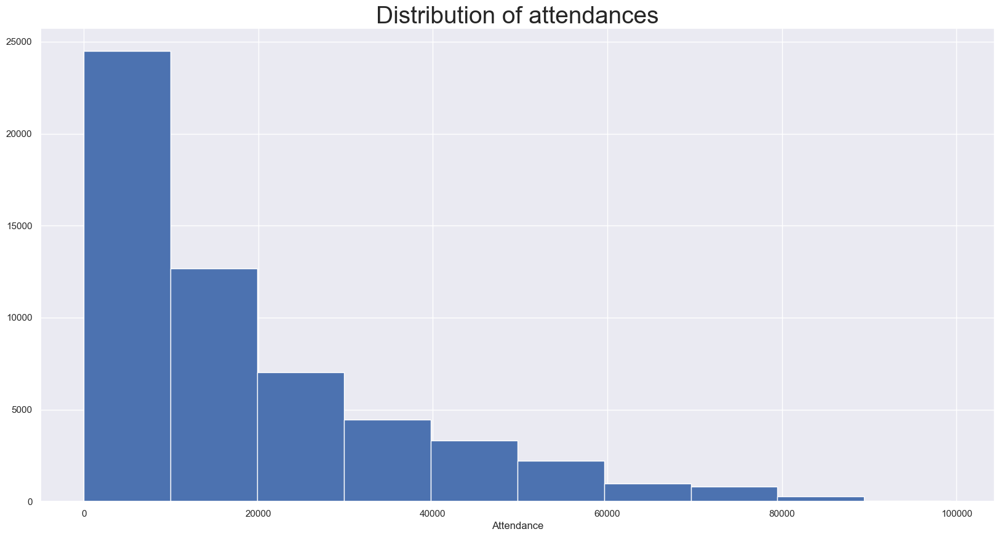

In [804]:
#print(games_df.columns) ; print(games_df.shape)

#add year to game valuations
games_df['datetime']=pd.to_datetime(games_df['date'], format="%Y-%m-%d")
games_df['year']=games_df['datetime'].dt.year

#filter range
games_df = games_df[(games_df.year > 2004 ) & (games_df.year <= 2023 )]

# annual home versus away goals
plt.title('Annual home versus away goals',fontsize=28)
yeargroups1 = games_df.loc[:,['home_club_goals', 'year']].groupby(['year']).sum().sort_values(by='year', ascending=True)
yeargroups2 = games_df.loc[:,['away_club_goals', 'year']].groupby(['year']).sum().sort_values(by='year', ascending=True)
plt.plot(yeargroups1.index,yeargroups1,color='blue',label='home goals')
plt.plot(yeargroups2.index,yeargroups2,color='red',label='away goals')
plt.legend()
plt.show()

#home goals by competition type
n=1;colour=['b','lightblue','cornflowerblue','b','navy']
competition_type=games_df.competition_type.unique()
for type in competition_type:
    plt.subplot(1,4,n);n=n+1
    games_df1 = games_df[(games_df.competition_type==type)] 
    plt.hist(games_df1['home_club_goals'],color=colour[n-1])
    plt.ylim(0,14000);plt.xlim(0,10)
    plt.xlabel(type)
plt.show()

#away goals by competition type
n=1;colour=['yellow','pink','lightcoral','r','crimson','brick']
for type in competition_type:
    plt.subplot(1,4,n);n=n+1
    games_df1 = games_df[(games_df.competition_type==type)] 
    plt.hist(games_df1['away_club_goals'],color=colour[n-1])
    plt.ylim(0,14000);plt.xlim(0,10)
    plt.xlabel(type)
plt.show()

# distribution of attendances
plt.hist(games_df['attendance'])
plt.title('Distribution of attendances',fontsize=28)
plt.xlabel('Attendance')
plt.show()

# attendance by year
#n=1;colour=['yellow','r','orange','b','g'];years=games_df['year'].unique()
#for year in years:
#    plt.subplot(1,len(years),n);n=n+1
#    attendance_df1 = games_df[(games_df.year==year)]                                             
#    plt.hist(attendance_df1['attendance'])
#    plt.ylim(0,4000)
#    plt.xlabel(year)
#plt.show()

# Data visualisation of market value by age

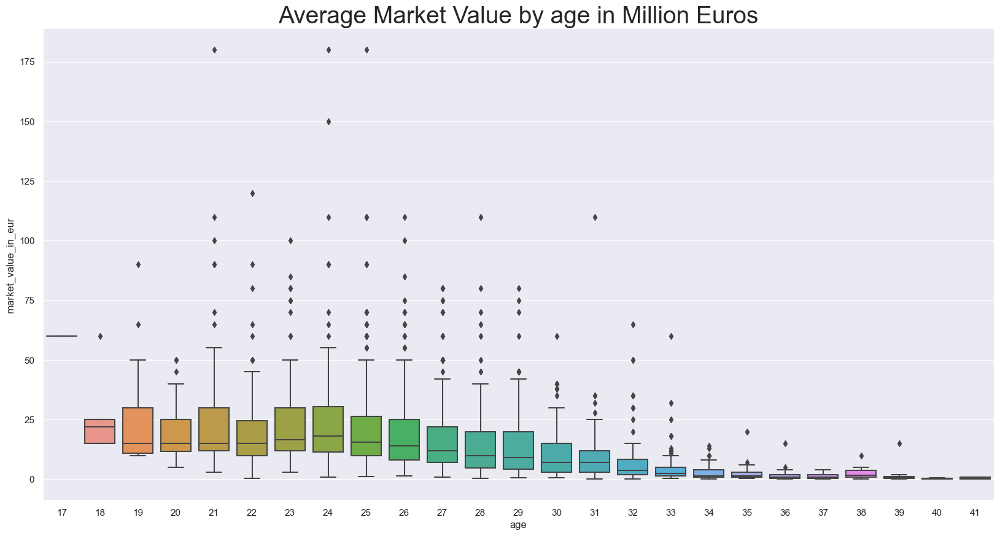

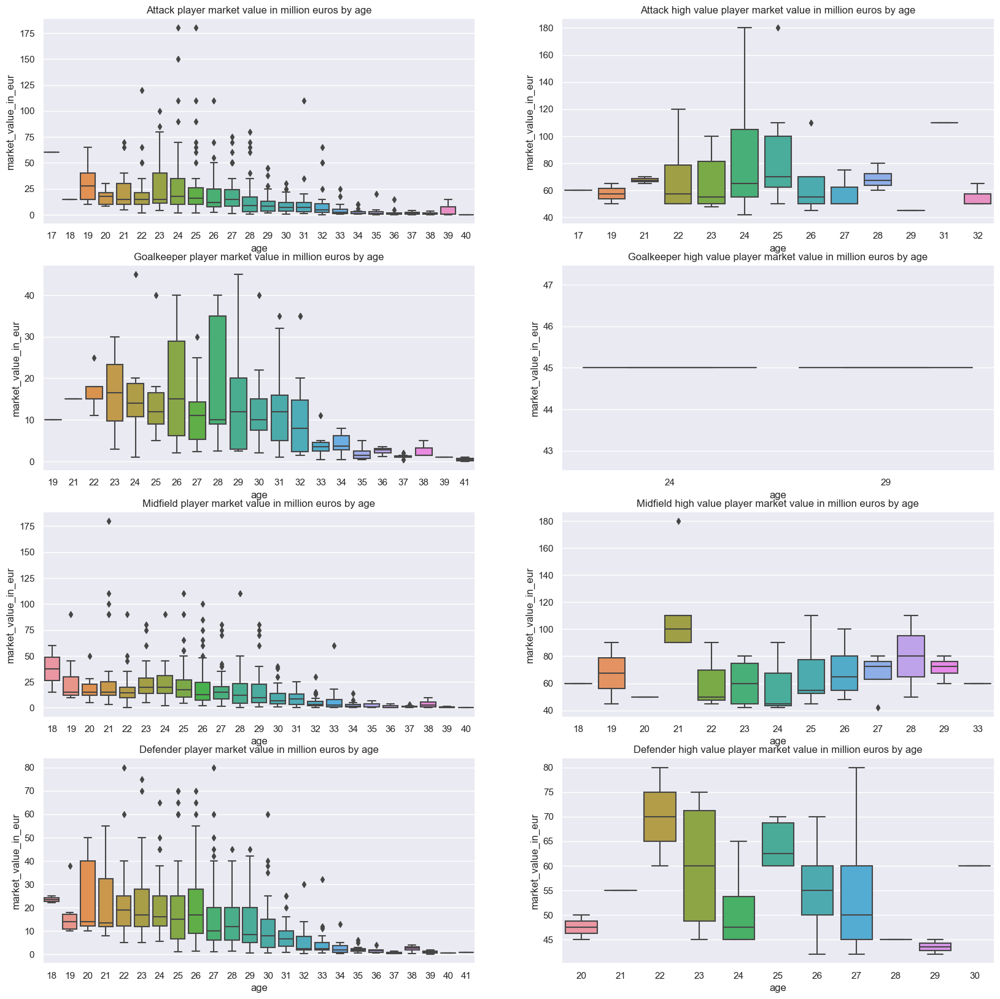

In [805]:
#market value by age
agegroups = players_df1.loc[:,['market_value_in_eur', 'age']] \
    .groupby(['age']) \
    .mean() \
    .sort_values(by='market_value_in_eur', ascending=False)
sns.set(rc={'figure.figsize':(20,10)})
plt.ylabel('Market value')
sns.boxplot(x=players_df1["age"], y=(players_df1['market_value_in_eur'])/1000000)
plt.title('Average Market Value by age in Million Euros',fontsize=28)
plt.show() 
# show Market Value for each position by age
positions=players_df1.position.unique()
f = plt.figure(figsize=(20,20))
ax = f.add_subplot(421);ax2 = f.add_subplot(422);ax3 = f.add_subplot(423);ax4 = f.add_subplot(424)
ax5 = f.add_subplot(425);ax6 = f.add_subplot(426);ax7 = f.add_subplot(427);ax8 = f.add_subplot(428)
n=1
for position in positions:
    plt.subplot(4,2,n); n=n+1 
    players_df2 = players_df1[players_df1['position'] == position]
    agegroups = players_df2.loc[:,['market_value_in_eur', 'age']].groupby(['age']).median().sort_values(by='market_value_in_eur', ascending=False)
    sns.boxplot(x=players_df2["age"], y=(players_df2['market_value_in_eur'])/1000000)
    title=str(position+' player market value in million euros by age');plt.title(title)
    plt.subplot(4,2,n); n=n+1
    high_value_players_df2 = high_value_players_df[high_value_players_df['position'] == position]
    agegroups = high_value_players_df.loc[:,['market_value_in_eur', 'age']].groupby(['age']).median().sort_values(by='market_value_in_eur', ascending=False)
    sns.boxplot(x=high_value_players_df2["age"], y=(high_value_players_df2['market_value_in_eur'])/1000000)
    title=str(position+' high value player market value in million euros by age'); plt.title(title)
plt.show()

## Observations on age

The age distribution of players is a skewed normal distribution starting at 17 years of age and going up 50 with an average age of 29. Players with a market value to over 400,000 euros form a normal distribution ranging from 19 to 32 years of age, with a significant number at age 25.

# Data visualisation of market value by height

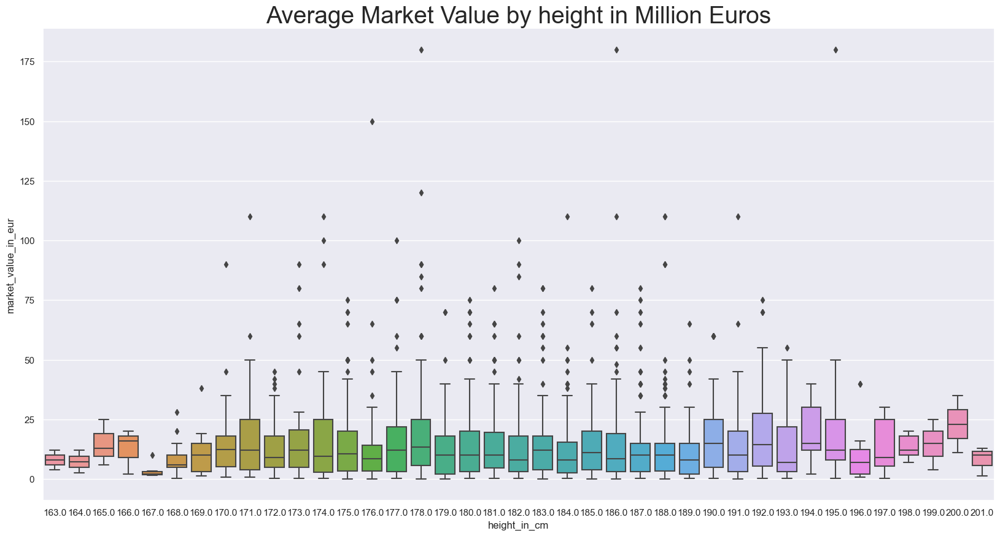

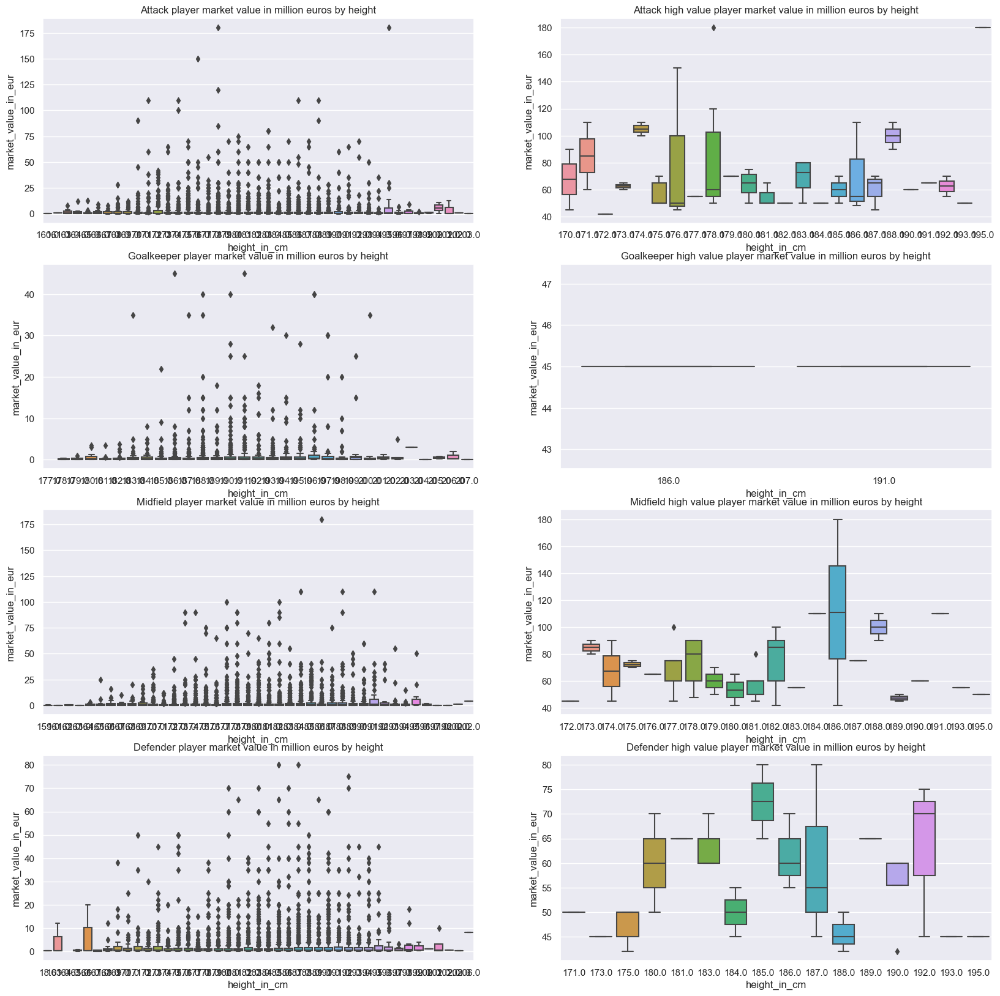

In [806]:
# drop players with no height
players_df3 = players_df[players_df['height_in_cm'] >= 1]

#market value by height
heightgroups = players_df1.loc[:,['market_value_in_eur', 'height_in_cm']] \
    .groupby(['height_in_cm']) \
    .mean() \
    .sort_values(by='market_value_in_eur', ascending=False)
sns.set(rc={'figure.figsize':(20,10)})
plt.ylabel('Market value')
sns.boxplot(x=players_df1["height_in_cm"], y=(players_df1['market_value_in_eur'])/1000000)
plt.title('Average Market Value by height in Million Euros', fontsize=28)
plt.show() 

# show Market Value for each position by height
f = plt.figure(figsize=(20,20))
ax = f.add_subplot(421);ax2 = f.add_subplot(422);ax3 = f.add_subplot(423);ax4 = f.add_subplot(424)
ax5 = f.add_subplot(425);ax6 = f.add_subplot(426);ax7 = f.add_subplot(427);ax8 = f.add_subplot(428)

n=1
for position in positions:
    plt.subplot(4,2,n)
    n=n+1 
    players_df4 = players_df3[players_df3['position'] == position]
    heightgroups = players_df4.loc[:,['market_value_in_eur', 'height_in_cm']] \
    .groupby(['height_in_cm']) \
    .median() \
    .sort_values(by='market_value_in_eur', ascending=False)
    sns.boxplot(x=players_df4["height_in_cm"], y=(players_df4['market_value_in_eur'])/1000000)
    title=str(position+' player market value in million euros by height')
    plt.title(title)
    plt.subplot(4,2,n); n=n+1
    high_value_players_df2 = high_value_players_df[high_value_players_df['position'] == position]
    heightgroups = high_value_players_df2.loc[:,['market_value_in_eur', 'height_in_cm']] \
    .groupby(['height_in_cm']) \
    .median() \
    .sort_values(by='market_value_in_eur', ascending=False)
    sns.boxplot(x=high_value_players_df2["height_in_cm"], y=(high_value_players_df2['market_value_in_eur'])/1000000)
    title=str(position+' high value player market value in million euros by height')
    plt.title(title)
plt.show()

## Observations on height

The height distribution of players is a normal distribution ranging from 160cm to 200cm with an average age of 181cm. The average height for heigh value players is about 1cm taller that the general average.

There are relatively fee high value goal keepers, but they are all tall ranging froom 188 to 200cm.

There appears to be a normal like relationship between height and market value for each position when you look at all players, but does not appear to be any significant relationship between height and market value in the most valuable players.

## Top players by Market Value

In [807]:
high_value_players_df2=high_value_players_df1.sort_values('market_value_in_eur',ascending = False)
highest_value_players_df2=high_value_players_df1.sort_values('highest_market_value_in_eur',ascending = False)

print((high_value_players_df2[['name',"market_value_in_eur","last_season"]]).head(15));print("*****")
print(highest_value_players_df2[['name',"highest_market_value_in_eur","last_season"]].head(15));print("*****")

                    name  market_value_in_eur  last_season
21474     Erling Haaland          180000000.0         2023
25392    Jude Bellingham          180000000.0         2023
18682      Kylian Mbappé          180000000.0         2023
19862    Vinicius Junior          150000000.0         2023
21891        Bukayo Saka          120000000.0         2023
9419          Harry Kane          110000000.0         2023
21158   Lautaro Martínez          110000000.0         2023
21013     Victor Osimhen          110000000.0         2023
19408        Declan Rice          110000000.0         2023
25357      Jamal Musiala          110000000.0         2023
21162         Phil Foden          110000000.0         2023
19403              Rodri          110000000.0         2023
25741      Florian Wirtz          100000000.0         2023
19742  Federico Valverde          100000000.0         2023
21305            Rodrygo          100000000.0         2023
*****
                         name  highest_market_valu

# Statistical Overview

In [810]:
# print info and describe for each dataframe

for i, df in enumerate(dataframes):
    print("***********")
    print(df.info())
    print(df.describe())

***********
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1524941 entries, 0 to 1524940
Data columns (total 13 columns):
 #   Column                  Non-Null Count    Dtype 
---  ------                  --------------    ----- 
 0   appearance_id           1524941 non-null  object
 1   game_id                 1524941 non-null  int64 
 2   player_id               1524941 non-null  int64 
 3   player_club_id          1524941 non-null  int64 
 4   player_current_club_id  1524941 non-null  int64 
 5   date                    1524941 non-null  object
 6   player_name             1524940 non-null  object
 7   competition_id          1524941 non-null  object
 8   yellow_cards            1524941 non-null  int64 
 9   red_cards               1524941 non-null  int64 
 10  goals                   1524941 non-null  int64 
 11  assists                 1524941 non-null  int64 
 12  minutes_played          1524941 non-null  int64 
dtypes: int64(9), object(4)
memory usage: 151.2+ MB
None
        

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 681952 entries, 0 to 681951
Data columns (total 10 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   game_event_id     681952 non-null  object 
 1   date              681952 non-null  object 
 2   game_id           681952 non-null  int64  
 3   minute            681952 non-null  int64  
 4   type              681952 non-null  object 
 5   club_id           681952 non-null  int64  
 6   player_id         681952 non-null  int64  
 7   description       344576 non-null  object 
 8   player_in_id      429604 non-null  float64
 9   player_assist_id  32987 non-null   float64
dtypes: float64(2), int64(4), object(4)
memory usage: 52.0+ MB
None
            game_id         minute        club_id     player_id  player_in_id  player_assist_id
count  6.819520e+05  681952.000000  681952.000000  6.819520e+05  4.296040e+05      3.298700e+04
mean   3.076390e+06      63.518582    4573.212179  2.

# Collating All Player Data

Having look at each the data in each of the data files, I'm going to pull all of the data together for each player, so that we can look at feature importance and start to model transfer values.

In [811]:
import pandas as pd

# Assuming players_df is your DataFrame
# Assuming 'last_season' is a column representing the last season for each player

# Filter players with the last season of 2023
players_2023 = players_df[players_df['last_season'] == 2023]

# Display the filtered DataFrame
print("Players with the Last Season of 2023:")
print(players_2023.info())


Players with the Last Season of 2023:
<class 'pandas.core.frame.DataFrame'>
Int64Index: 6315 entries, 188 to 30394
Data columns (total 25 columns):
 #   Column                                Non-Null Count  Dtype         
---  ------                                --------------  -----         
 0   player_id                             6315 non-null   int64         
 1   first_name                            5920 non-null   object        
 2   last_name                             6315 non-null   object        
 3   name                                  6315 non-null   object        
 4   last_season                           6315 non-null   int64         
 5   current_club_id                       6315 non-null   int64         
 6   player_code                           6315 non-null   object        
 7   country_of_birth                      6008 non-null   object        
 8   city_of_birth                         6010 non-null   object        
 9   country_of_citizenship           

In [812]:
players_df = players_2023

In [813]:
# This was by attempt to collate all of the player data, but i found a far more elegant solution from LOIS CORDEIRO see below

#Start with players_df
merged_players_df=players_df.drop(['current_club_id', 'city_of_birth', 'date_of_birth','first_name', 'last_name', 'player_code', 'image_url', 'url'], axis=1)

#next look at clubs_df
merged_players_df = merged_players_df.reindex(columns = merged_players_df.columns.tolist() + ['club_value','squad_size','goals_2022','games_2022','assists_2022','minutes_played_2022','goals_against_2022','goals_for_2022','clean_sheet_2022'])
for player_id in merged_players_df.player_id.unique():
    #print(players_df.current_club_id[(players_df.player_id==player_id)])
    club_id= players_df.current_club_id[(players_df.player_id==player_id)]
    #print(clubs_df.total_market_value[(clubs_df.club_id==int(club_id))])
    #print(clubs_df.squad_size[(clubs_df.club_id==int(club_id))])
    try:
        merged_players_df.club_value[(players_df.player_id==player_id)]=int(clubs_df.total_market_value[(clubs_df.club_id==int(club_id))])
    except:
        merged_players_df.club_value[(players_df.player_id==player_id)]='NaN'  
    merged_players_df.squad_size[(players_df.player_id==player_id)]=int((clubs_df.squad_size[(clubs_df.club_id==int(club_id))]))
#sort column order
columns=['player_id','games_2022','minutes_played_2022','goals_2022','assists_2022','goals_against_2022','goals_for_2022','clean_sheet_2022','name','position','sub_position','last_season','foot','height_in_cm','age','country_of_citizenship','country_of_birth','current_club_name','club_value','squad_size','current_club_domestic_competition_id','agent_name','contract_expiration_date','term_days_remaining','market_value_in_eur','highest_market_value_in_eur']
merged_players_df=merged_players_df[columns]
#print(merged_players_df.head())

In [814]:
# merge games and appearances

In [815]:
appearances_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1515758 entries, 0 to 1515757
Data columns (total 15 columns):
 #   Column                  Non-Null Count    Dtype         
---  ------                  --------------    -----         
 0   appearance_id           1515758 non-null  object        
 1   game_id                 1515758 non-null  int64         
 2   player_id               1515758 non-null  int64         
 3   player_club_id          1515758 non-null  int64         
 4   player_current_club_id  1515758 non-null  int64         
 5   date                    1515758 non-null  object        
 6   player_name             1515757 non-null  object        
 7   competition_id          1515758 non-null  object        
 8   yellow_cards            1515758 non-null  int64         
 9   red_cards               1515758 non-null  int64         
 10  goals                   1515758 non-null  int64         
 11  assists                 1515758 non-null  int64         
 12  minutes_played

In [816]:
games_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 65837 entries, 0 to 66193
Data columns (total 25 columns):
 #   Column                  Non-Null Count  Dtype         
---  ------                  --------------  -----         
 0   game_id                 65837 non-null  int64         
 1   competition_id          65837 non-null  object        
 2   season                  65837 non-null  int64         
 3   round                   65837 non-null  object        
 4   date                    65837 non-null  object        
 5   home_club_id            65837 non-null  int64         
 6   away_club_id            65837 non-null  int64         
 7   home_club_goals         65837 non-null  int64         
 8   away_club_goals         65837 non-null  int64         
 9   home_club_position      46229 non-null  float64       
 10  away_club_position      46228 non-null  float64       
 11  home_club_manager_name  65094 non-null  object        
 12  away_club_manager_name  65094 non-null  object

In [817]:
import pandas as pd

# Assuming your dataframes are named games_df and appearances_df
merged_df = pd.merge(games_df, appearances_df, on='game_id', how='inner')

# Display information about the merged dataframe
merged_df.info()


<class 'pandas.core.frame.DataFrame'>
Int64Index: 1515758 entries, 0 to 1515757
Data columns (total 39 columns):
 #   Column                  Non-Null Count    Dtype         
---  ------                  --------------    -----         
 0   game_id                 1515758 non-null  int64         
 1   competition_id_x        1515758 non-null  object        
 2   season                  1515758 non-null  int64         
 3   round                   1515758 non-null  object        
 4   date_x                  1515758 non-null  object        
 5   home_club_id            1515758 non-null  int64         
 6   away_club_id            1515758 non-null  int64         
 7   home_club_goals         1515758 non-null  int64         
 8   away_club_goals         1515758 non-null  int64         
 9   home_club_position      1298875 non-null  float64       
 10  away_club_position      1298852 non-null  float64       
 11  home_club_manager_name  1512114 non-null  object        
 12  away_club_mana

In [818]:
# Assuming your merged dataframe is named merged_df
merged_df_2023 = merged_df[merged_df['season'] == 2022]

# Display information about the filtered dataframe
merged_df_2023.info()


<class 'pandas.core.frame.DataFrame'>
Int64Index: 142891 entries, 57582 to 1515621
Data columns (total 39 columns):
 #   Column                  Non-Null Count   Dtype         
---  ------                  --------------   -----         
 0   game_id                 142891 non-null  int64         
 1   competition_id_x        142891 non-null  object        
 2   season                  142891 non-null  int64         
 3   round                   142891 non-null  object        
 4   date_x                  142891 non-null  object        
 5   home_club_id            142891 non-null  int64         
 6   away_club_id            142891 non-null  int64         
 7   home_club_goals         142891 non-null  int64         
 8   away_club_goals         142891 non-null  int64         
 9   home_club_position      123153 non-null  float64       
 10  away_club_position      123153 non-null  float64       
 11  home_club_manager_name  142682 non-null  object        
 12  away_club_manager_name  1

In [819]:
# Assuming your dataframe is named merged_df_2023
player_goals_sum = merged_df_2023.groupby('player_name')['goals'].sum().reset_index()

# Select the top 10 players based on the sum of goals
top_10_players = player_goals_sum.nlargest(10, 'goals')

# Print the top 10 players and their total goals
print(top_10_players[['player_name', 'goals']])


             player_name  goals
2004      Erling Haaland     51
3716       Kylian Mbappé     36
5608  Robert Lewandowski     33
1954      Enner Valencia     32
2565          Harry Kane     32
3486       Karim Benzema     31
4514        Mehdi Taremi     31
6621      Victor Osimhen     31
4696       Mohamed Salah     29
3763    Lautaro Martínez     28


In [820]:
games_and_appearances_df = merged_df_2023

In [821]:
games_and_appearances_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 142891 entries, 57582 to 1515621
Data columns (total 39 columns):
 #   Column                  Non-Null Count   Dtype         
---  ------                  --------------   -----         
 0   game_id                 142891 non-null  int64         
 1   competition_id_x        142891 non-null  object        
 2   season                  142891 non-null  int64         
 3   round                   142891 non-null  object        
 4   date_x                  142891 non-null  object        
 5   home_club_id            142891 non-null  int64         
 6   away_club_id            142891 non-null  int64         
 7   home_club_goals         142891 non-null  int64         
 8   away_club_goals         142891 non-null  int64         
 9   home_club_position      123153 non-null  float64       
 10  away_club_position      123153 non-null  float64       
 11  home_club_manager_name  142682 non-null  object        
 12  away_club_manager_name  1

In [822]:
merged_players_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 6315 entries, 188 to 30394
Data columns (total 26 columns):
 #   Column                                Non-Null Count  Dtype         
---  ------                                --------------  -----         
 0   player_id                             6315 non-null   int64         
 1   games_2022                            0 non-null      float64       
 2   minutes_played_2022                   0 non-null      float64       
 3   goals_2022                            0 non-null      float64       
 4   assists_2022                          0 non-null      float64       
 5   goals_against_2022                    0 non-null      float64       
 6   goals_for_2022                        0 non-null      float64       
 7   clean_sheet_2022                      0 non-null      float64       
 8   name                                  6315 non-null   object        
 9   position                              6315 non-null   object        
 1

In [823]:
#collate stats game, appearance and goal date for each player.
#code based on code from luis gasparcordeiro's notebook at https://www.kaggle.com/code/luisgasparcordeiro/market-value-eda/notebook

#merge games and appearances   
games_and_appearances_df = appearances_df.merge(games_df, on=['game_id'], how='left')
season = 2022

#create a function to collate player stats
def player_stats(player_id, season, df):
    df = games_and_appearances_df[games_and_appearances_df['player_id'] == player_id]
    df =  df[ df['season'] == season]    
    if (df.shape[0] == 0):
        Out = [(np.nan, season,0,0,0,0,0,0,0,0,0)]
        out_df = pd.DataFrame(data = Out, columns = ['player_id','season','goals','games',
                                                     'assists','minutes_played','goals_for','goals_against','clean_sheet','yellow_cards','red_cards'])
        return out_df    
    else:       
        df["goals_for"] = df.apply(lambda row: row['home_club_goals'] if row['home_club_id'] == row['player_club_id'] 
            else row['away_club_goals'] if row['away_club_id'] == row['player_club_id'] 
            else np.nan, axis=1)
        df["goals_against"] = df.apply(lambda row: row['away_club_goals'] if row['home_club_id'] == row['player_club_id'] 
            else row['home_club_goals'] if row['away_club_id'] == row['player_club_id'] 
            else np.nan, axis=1)
        df['clean_sheet'] = df.apply(lambda row: 1 if row['goals_against'] == 0
            else 0 if row['goals_against'] > 0
            else np.nan, axis=1)
        df = df.groupby(['player_id',"season"],as_index=False).agg({'goals': 'sum', 'game_id': 'nunique', 
                                                                      'assists': 'sum', 'minutes_played' : 'sum', 'goals_for' : 'sum',
                                                                      'goals_against' : 'sum', 'clean_sheet' : 'sum','yellow_cards':'sum','red_cards':'sum'})
        out_df = df.rename(columns={'game_id': 'games'})
        return out_df
#print(player_stats(67064, 2014, games_and_appearances_df)) #test function works.

#iterate through players
for index in merged_players_df.index:
    id = merged_players_df.loc[index][0]
    #print(id)
    name = merged_players_df.loc[index][1]
    stats = player_stats(id, season, games_and_appearances_df)
    try:
        merged_players_df.at[index,'games_{}'.format(season)]= stats['games'][0]
        merged_players_df.at[index,'goals_{}'.format(season)]= stats['goals'][0]
        merged_players_df.at[index,'assists_{}'.format(season)]= stats['assists'][0]
        merged_players_df.at[index,'minutes_played_{}'.format(season)]= stats['minutes_played'][0]
        merged_players_df.at[index,'goals_for_{}'.format(season)]= stats['goals_for'][0]
        merged_players_df.at[index,'goals_against_{}'.format(season)]= stats['goals_against'][0]
        merged_players_df.at[index,'clean_sheet_{}'.format(season)]= stats['clean_sheet'][0]
        merged_players_df.at[index,'yellow_cards_{}'.format(season)]= stats['yellow_cards'][0]
        merged_players_df.at[index,'red_cards_{}'.format(season)]= stats['red_cards'][0]
    except:
        #print(id)
        n=n+1     
print('appearance,goal and card data merged')
print(merged_players_df.info());#print(merged_players_df.describe())

appearance,goal and card data merged
<class 'pandas.core.frame.DataFrame'>
Int64Index: 6315 entries, 188 to 30394
Data columns (total 28 columns):
 #   Column                                Non-Null Count  Dtype         
---  ------                                --------------  -----         
 0   player_id                             6315 non-null   int64         
 1   games_2022                            6315 non-null   float64       
 2   minutes_played_2022                   6315 non-null   float64       
 3   goals_2022                            6315 non-null   float64       
 4   assists_2022                          6315 non-null   float64       
 5   goals_against_2022                    6315 non-null   float64       
 6   goals_for_2022                        6315 non-null   float64       
 7   clean_sheet_2022                      6315 non-null   float64       
 8   name                                  6315 non-null   object        
 9   position                          

In [824]:
merged_players_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 6315 entries, 188 to 30394
Data columns (total 28 columns):
 #   Column                                Non-Null Count  Dtype         
---  ------                                --------------  -----         
 0   player_id                             6315 non-null   int64         
 1   games_2022                            6315 non-null   float64       
 2   minutes_played_2022                   6315 non-null   float64       
 3   goals_2022                            6315 non-null   float64       
 4   assists_2022                          6315 non-null   float64       
 5   goals_against_2022                    6315 non-null   float64       
 6   goals_for_2022                        6315 non-null   float64       
 7   clean_sheet_2022                      6315 non-null   float64       
 8   name                                  6315 non-null   object        
 9   position                              6315 non-null   object        
 1

In [825]:
import pandas as pd

# Assuming merged_players_df is your DataFrame
print(merged_players_df.columns)


Index(['player_id', 'games_2022', 'minutes_played_2022', 'goals_2022', 'assists_2022', 'goals_against_2022', 'goals_for_2022', 'clean_sheet_2022', 'name', 'position', 'sub_position', 'last_season', 'foot', 'height_in_cm', 'age', 'country_of_citizenship', 'country_of_birth', 'current_club_name', 'club_value', 'squad_size', 'current_club_domestic_competition_id', 'agent_name', 'contract_expiration_date', 'term_days_remaining', 'market_value_in_eur', 'highest_market_value_in_eur', 'yellow_cards_2022', 'red_cards_2022'], dtype='object')


In [826]:
# Feature jadid 

In [827]:
def combine_stats(x,y):
    return x+y

def aggregate(x):
    return sum(x)

def name(x):
    return x[0]

def p90_calculator(*args,total_minutes=0):
    total_goals=0
    total_minutes_played=0
    for stat in args:
        total_goals=total_goals+stat
    return total_goals / (total_minutes / 90)

In [828]:
df = merged_players_df


# add columns to get direct goal contribution
df['direct_goal_contribution2022']=combine_stats(df['goals_2022'],df['assists_2022'])
df=df.sort_values('direct_goal_contribution2022', ascending=False)

# goals per 90 min calc
df['goals_per_90']=p90_calculator(df.goals_2022, total_minutes=df.minutes_played_2022)

,player_id,games_2022,minutes_played_2022,goals_2022,assists_2022,goals_against_2022,goals_for_2022,clean_sheet_2022,name,position,sub_position,last_season,foot,height_in_cm,age,country_of_citizenship,country_of_birth,current_club_name,club_value,squad_size,current_club_domestic_competition_id,agent_name,contract_expiration_date,term_days_remaining,market_value_in_eur,highest_market_value_in_eur,yellow_cards_2022,red_cards_2022,direct_goal_contribution2022,goals_per_90
21474,418560,51.0,4024.0,51.0,9.0,39.0,131.0,22.0,Erling Haaland,Attack,Centre-Forward,2023,left,195.0,24,Norway,England,Manchester City Football Club,1.293700e+09,24.0,GB1,Rafaela Pimenta,2027-06-30,1245,180000000.0,180000000.0,6.0,0.0,60.0,1.140656
18682,342229,42.0,3474.0,36.0,9.0,46.0,95.0,11.0,Kylian Mbappé,Attack,Left Winger,2023,right,178.0,25,France,France,Paris Saint-Germain Football Club,1.049300e+09,30.0,FR1,NaN,2024-06-30,150,180000000.0,200000000.0,6.0,0.0,45.0,0.932642
10048,148455,50.0,4211.0,29.0,16.0,64.0,101.0,18.0,Mohamed Salah,Attack,Right Winger,2023,left,175.0,32,Egypt,Egypt,Liverpool Football Club,8.746000e+08,28.0,GB1,NaN,2025-06-30,515,65000000.0,150000000.0,2.0,0.0,45.0,0.619805
19862,371998,55.0,4759.0,23.0,21.0,61.0,120.0,18.0,Vinicius Junior,Attack,Left Winger,2023,right,176.0,24,Brazil,Brazil,Real Madrid Club de Fútbol,1.038000e+09,24.0,ES1,Roc Nation Sports,2027-06-30,1245,150000000.0,150000000.0,16.0,1.0,44.0,0.434965
17245,307058,46.0,3576.0,31.0,11.0,25.0,99.0,27.0,Mehdi Taremi,Attack,Centre-Forward,2023,right,185.0,32,Iran,Iran,Futebol Clube do Porto,2.681000e+08,27.0,PO1,NaN,2024-06-30,150,12000000.0,20000000.0,10.0,0.0,42.0,0.780201


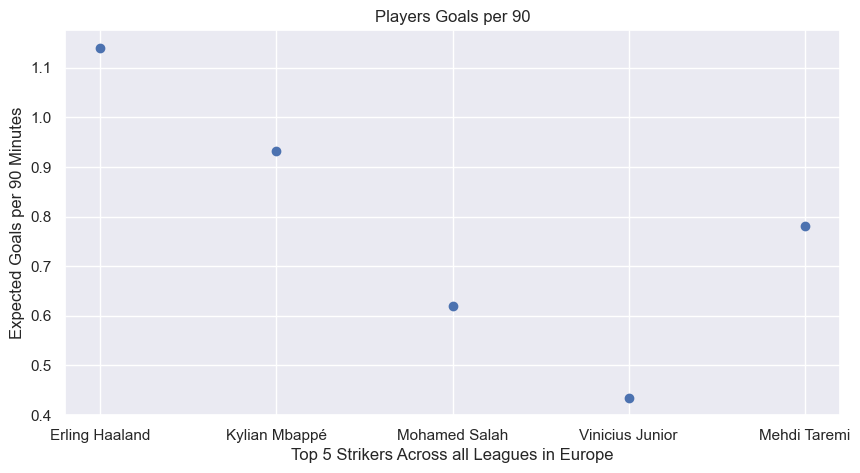

In [829]:
# create x-axis of top 5 players
players=df['name'][0:5]

# y-axis for their corresponding goals per 90
goals_per_90_minutes=df['goals_per_90'][0:5]

# scatterplot to visualize
plt.figure(figsize=(10, 5))
plt.xlabel('Top 5 Strikers Across all Leagues in Europe')
plt.ylabel('Expected Goals per 90 Minutes')
plt.title('Players Goals per 90')
plt.scatter(players, goals_per_90_minutes)

df.head()

In [830]:
merged_players_df = df

In [831]:
merged_players_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 6315 entries, 21474 to 30394
Data columns (total 30 columns):
 #   Column                                Non-Null Count  Dtype         
---  ------                                --------------  -----         
 0   player_id                             6315 non-null   int64         
 1   games_2022                            6315 non-null   float64       
 2   minutes_played_2022                   6315 non-null   float64       
 3   goals_2022                            6315 non-null   float64       
 4   assists_2022                          6315 non-null   float64       
 5   goals_against_2022                    6315 non-null   float64       
 6   goals_for_2022                        6315 non-null   float64       
 7   clean_sheet_2022                      6315 non-null   float64       
 8   name                                  6315 non-null   object        
 9   position                              6315 non-null   object        


In [832]:
# Assuming merged_players_df is your DataFrame
merged_players_df['score_2022'] = 0  # Initialize the new score column

# Define weights for different metrics based on positions
position_weights = {
    'Goalkeeper': {'minutes_played': 0.1, 'clean_sheet': 0.4, 'yellow_cards': -0.1, 'red_cards': -0.2},
    'Midfield': {'minutes_played': 0.2, 'goals': 0.3, 'assists': 0.3, 'yellow_cards': -0.1, 'red_cards': -0.2},
    'Defender': {'minutes_played': 0.2, 'goals_against': -0.6, 'clean_sheet': 0.3, 'yellow_cards': -0.1, 'red_cards': -0.2},
    'Attack': {'minutes_played': 0.2, 'goals': 5, 'assists': 0.2},
}

# Calculate the score based on position-specific weights
for position in position_weights.keys():
    position_mask = merged_players_df['position'] == position
    for metric, weight in position_weights[position].items():
        merged_players_df.loc[position_mask, 'score_2022'] += merged_players_df.loc[position_mask, f'{metric}_2022'] * weight

# Print the resulting DataFrame with the new 'score_2022' column
print(merged_players_df[['name', 'position', 'score_2022']])


                      name    position  score_2022
21474       Erling Haaland      Attack      1061.6
18682        Kylian Mbappé      Attack       876.6
10048        Mohamed Salah      Attack       990.4
19862      Vinicius Junior      Attack      1071.0
17245         Mehdi Taremi      Attack       872.4
...                    ...         ...         ...
12917  Mickey van der Hart  Goalkeeper       257.4
12915            Dan Potts    Defender         0.0
23603        Samuel Soares  Goalkeeper         0.6
23604     Eduardo Quaresma    Defender        12.5
30394       Bakary Haidara    Defender         0.0

[6315 rows x 3 columns]


In [833]:
# Sort the DataFrame by 'score_2022' in descending order
sorted_players_df = merged_players_df.sort_values(by='score_2022', ascending=False)

# Print the sorted DataFrame with the new 'score_2022' column
print(sorted_players_df[['name', 'position', 'score_2022']].head(100))


                        name  position  score_2022
19862        Vinicius Junior    Attack      1071.0
21474         Erling Haaland    Attack      1061.6
9419              Harry Kane    Attack      1009.6
10048          Mohamed Salah    Attack       990.4
21158       Lautaro Martínez    Attack       965.8
3253      Robert Lewandowski    Attack       957.4
14313        Bruno Fernandes  Midfield       949.8
21719        Pedro Gonçalves    Attack       940.0
15238        Marcus Rashford    Attack       908.6
9909                  Danilo  Defender       906.4
19742      Federico Valverde  Midfield       885.7
3037             Dusan Tadic    Attack       883.8
12153     Alejandro Grimaldo  Defender       881.5
18682          Kylian Mbappé    Attack       876.6
17245           Mehdi Taremi    Attack       872.4
25052            Xavi Simons    Attack       872.4
21305                Rodrygo    Attack       867.8
21937             Cody Gakpo    Attack       867.8
12508        Bryan Cristante  M

In [834]:
# Calculate the correlation between 'score_2022' and 'market_value_in_eur'
correlation = merged_players_df['score_2022'].corr(merged_players_df['market_value_in_eur'])

# Print the correlation coefficient
print(f"The correlation between 'score_2022' and 'market_value_in_eur' is: {correlation}")


The correlation between 'score_2022' and 'market_value_in_eur' is: 0.47196412707964785


In [835]:
merged_players_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 6315 entries, 21474 to 30394
Data columns (total 31 columns):
 #   Column                                Non-Null Count  Dtype         
---  ------                                --------------  -----         
 0   player_id                             6315 non-null   int64         
 1   games_2022                            6315 non-null   float64       
 2   minutes_played_2022                   6315 non-null   float64       
 3   goals_2022                            6315 non-null   float64       
 4   assists_2022                          6315 non-null   float64       
 5   goals_against_2022                    6315 non-null   float64       
 6   goals_for_2022                        6315 non-null   float64       
 7   clean_sheet_2022                      6315 non-null   float64       
 8   name                                  6315 non-null   object        
 9   position                              6315 non-null   object        


In [836]:
import pandas as pd

# Assuming merged_players_df is your DataFrame
# Add 'price_last_year' column representing the market value in 2022
merged_players_df['price_last_year'] = 0  # Initialize the column with zeros

# Update 'price_last_year' with 'market_value_in_eur' for the year 2022
merged_players_df.loc[merged_players_df['last_season'] == 2022, 'price_last_year'] = merged_players_df['market_value_in_eur']

# Assuming your DataFrame is named 'merged_players_df'
# Filter the DataFrame for last_season <= 2022
filtered_df = merged_players_df[merged_players_df['last_season'] <= 2022]

# Calculate average price for each player
average_prices = filtered_df.groupby('player_id')['market_value_in_eur'].mean()
average_prices.shape
# # Create a new column 'price_avg' based on the 'player_id' in the original DataFrame
# merged_players_df['price_avg'] = merged_players_df['player_id'].map(average_prices)

# merged_players_df.info()

# Assuming merged_players_df is your DataFrame

(0,)

In [837]:
merged_players_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 6315 entries, 21474 to 30394
Data columns (total 32 columns):
 #   Column                                Non-Null Count  Dtype         
---  ------                                --------------  -----         
 0   player_id                             6315 non-null   int64         
 1   games_2022                            6315 non-null   float64       
 2   minutes_played_2022                   6315 non-null   float64       
 3   goals_2022                            6315 non-null   float64       
 4   assists_2022                          6315 non-null   float64       
 5   goals_against_2022                    6315 non-null   float64       
 6   goals_for_2022                        6315 non-null   float64       
 7   clean_sheet_2022                      6315 non-null   float64       
 8   name                                  6315 non-null   object        
 9   position                              6315 non-null   object        


In [838]:
# Drop rows where 'last_season' is not 2023
filtered_df = merged_players_df.loc[merged_players_df['last_season'] == 2023]

# Print the shape of the filtered DataFrame to check the number of rows
print("Shape of the filtered DataFrame:", filtered_df.shape)

# Optionally, if you want to modify the original DataFrame in-place:
# merged_players_df = merged_players_df.loc[merged_players_df['last_season'] == 2023]


Shape of the filtered DataFrame: (6315, 32)


In [839]:
filtered_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 6315 entries, 21474 to 30394
Data columns (total 32 columns):
 #   Column                                Non-Null Count  Dtype         
---  ------                                --------------  -----         
 0   player_id                             6315 non-null   int64         
 1   games_2022                            6315 non-null   float64       
 2   minutes_played_2022                   6315 non-null   float64       
 3   goals_2022                            6315 non-null   float64       
 4   assists_2022                          6315 non-null   float64       
 5   goals_against_2022                    6315 non-null   float64       
 6   goals_for_2022                        6315 non-null   float64       
 7   clean_sheet_2022                      6315 non-null   float64       
 8   name                                  6315 non-null   object        
 9   position                              6315 non-null   object        


In [840]:
# Assuming your DataFrame is named filtered_df
top_10_club_values = filtered_df.groupby('current_club_name')['club_value'].sum().sort_values(ascending=False).head(10)

# Display the top 10 unique club values based on club_value
print(top_10_club_values)


current_club_name
Paris Saint-Germain Football Club    3.147900e+10
Chelsea Football Club                3.136320e+10
Manchester City Football Club        3.104880e+10
Arsenal Football Club                2.902900e+10
Real Madrid Club de Fútbol           2.491200e+10
FC Bayern München                    2.454270e+10
Liverpool Football Club              2.273960e+10
Tottenham Hotspur Football Club      2.166640e+10
Manchester United Football Club      1.995975e+10
Futbol Club Barcelona                1.887600e+10
Name: club_value, dtype: float64


In [841]:
merged_players_df = filtered_df

In [843]:
temp = filtered_df

In [844]:
# Print unique values in the 'last_season' column
unique_last_season_values = merged_players_df['last_season'].unique()

# Print the result
print("Unique values in the 'last_season' column:")
print(unique_last_season_values)


Unique values in the 'last_season' column:
[2023]


# Pearson Correlation of Features

Index(['games_2022', 'minutes_played_2022', 'goals_2022', 'assists_2022', 'goals_against_2022', 'goals_for_2022', 'clean_sheet_2022', 'age', 'club_value', 'squad_size', 'term_days_remaining', 'market_value_in_eur', 'highest_market_value_in_eur', 'yellow_cards_2022', 'red_cards_2022', 'direct_goal_contribution2022', 'goals_per_90', 'score_2022', 'price_last_year'], dtype='object')


<Axes: title={'center': 'Pearson Correlation of Features'}>

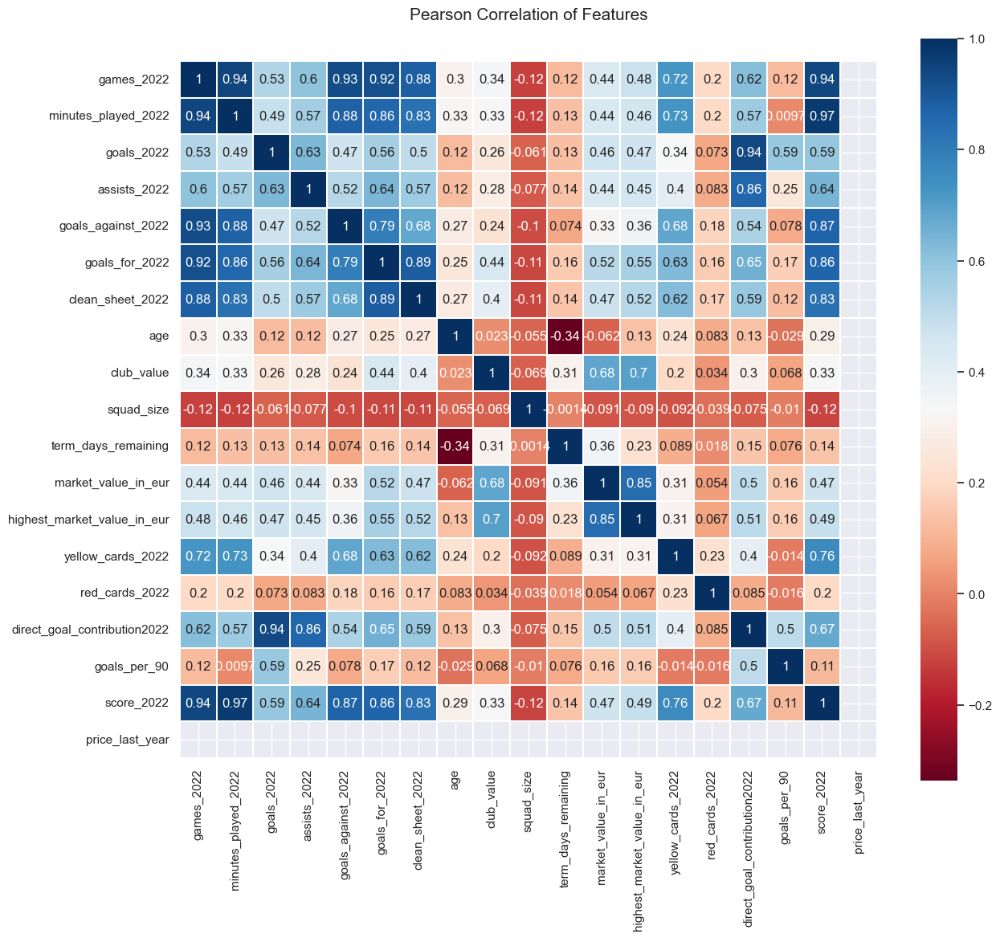

In [845]:
colormap = plt.cm.RdBu
plt.figure(figsize=(14,12))
plt.title('Pearson Correlation of Features', y=1.05, size=15)
features_df=merged_players_df.drop(['player_id','name','position','sub_position','last_season','foot','height_in_cm','country_of_citizenship','country_of_birth','current_club_name','current_club_domestic_competition_id','agent_name','contract_expiration_date'],axis=1)
print(features_df.columns)
sns.heatmap(features_df.astype(float).corr(),linewidths=0.1,vmax=1.0,square=True, cmap=colormap, linecolor='white', annot=True)

['player_id', 'games_2022', 'minutes_played_2022', 'goals_2022', 'assists_2022', 'goals_against_2022', 'goals_for_2022', 'clean_sheet_2022', 'name', 'position', 'sub_position', 'last_season', 'foot', 'height_in_cm', 'age', 'country_of_citizenship', 'country_of_birth', 'current_club_name', 'club_value', 'squad_size', 'current_club_domestic_competition_id', 'agent_name', 'contract_expiration_date', 'term_days_remaining', 'market_value_in_eur', 'highest_market_value_in_eur', 'yellow_cards_2022', 'red_cards_2022', 'direct_goal_contribution2022', 'goals_per_90', 'score_2022', 'price_last_year']


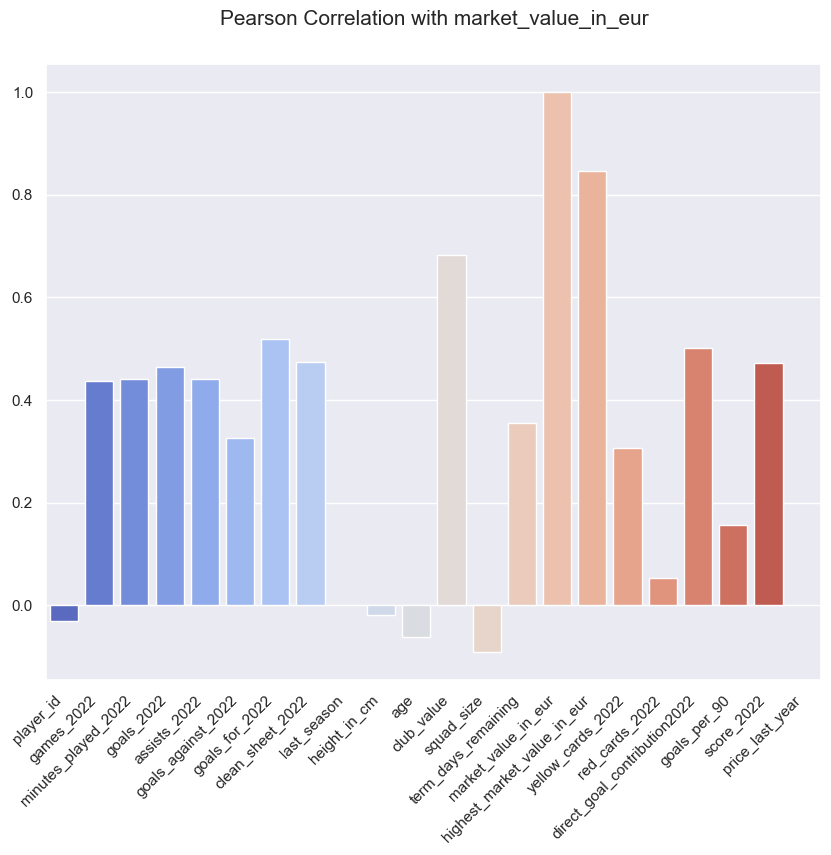

In [846]:
import matplotlib.pyplot as plt
import seaborn as sns

# Get the columns of the DataFrame
columns_for_correlation = filtered_df.columns.tolist()

# Print or use the variable as needed
print(columns_for_correlation)


# Extract the subset of columns for correlation analysis
correlation_df = merged_players_df[columns_for_correlation]

# Create a correlation matrix focused on 'market_value_in_eur'
correlation_market_value = correlation_df.corr()['market_value_in_eur']

# Set up the matplotlib figure
plt.figure(figsize=(10, 8))
plt.title('Pearson Correlation with market_value_in_eur', y=1.05, size=15)

# Create a bar plot for correlation with market_value_in_eur
sns.barplot(x=correlation_market_value.index, y=correlation_market_value.values, palette='coolwarm')

# Show the plot
plt.xticks(rotation=45, ha='right')
plt.show()


In [847]:
merged_players_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 6315 entries, 21474 to 30394
Data columns (total 32 columns):
 #   Column                                Non-Null Count  Dtype         
---  ------                                --------------  -----         
 0   player_id                             6315 non-null   int64         
 1   games_2022                            6315 non-null   float64       
 2   minutes_played_2022                   6315 non-null   float64       
 3   goals_2022                            6315 non-null   float64       
 4   assists_2022                          6315 non-null   float64       
 5   goals_against_2022                    6315 non-null   float64       
 6   goals_for_2022                        6315 non-null   float64       
 7   clean_sheet_2022                      6315 non-null   float64       
 8   name                                  6315 non-null   object        
 9   position                              6315 non-null   object        


In [848]:
columns_to_drop = ['player_id', 'name', 'country_of_citizenship', 'current_club_name', 'agent_name', 'contract_expiration_date']
merged_players_df = merged_players_df.drop(columns=columns_to_drop)


In [849]:
merged_players_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 6315 entries, 21474 to 30394
Data columns (total 26 columns):
 #   Column                                Non-Null Count  Dtype  
---  ------                                --------------  -----  
 0   games_2022                            6315 non-null   float64
 1   minutes_played_2022                   6315 non-null   float64
 2   goals_2022                            6315 non-null   float64
 3   assists_2022                          6315 non-null   float64
 4   goals_against_2022                    6315 non-null   float64
 5   goals_for_2022                        6315 non-null   float64
 6   clean_sheet_2022                      6315 non-null   float64
 7   position                              6315 non-null   object 
 8   sub_position                          6313 non-null   object 
 9   last_season                           6315 non-null   int64  
 10  foot                                  6137 non-null   object 
 11  height_in_cm

# Handle missing values
handle missing values by imputing the mean for numerical columns and the mode (most common value) for categorical columns:

In [850]:
# Impute mean for numerical columns
numerical_columns = merged_players_df.select_dtypes(include=['float64']).columns
merged_players_df[numerical_columns] = merged_players_df[numerical_columns].fillna(merged_players_df[numerical_columns].mean())

# Impute mode for categorical columns
categorical_columns = merged_players_df.select_dtypes(include=['object']).columns
merged_players_df[categorical_columns] = merged_players_df[categorical_columns].apply(lambda x: x.fillna(x.mode()[0]))


In [851]:
merged_players_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 6315 entries, 21474 to 30394
Data columns (total 26 columns):
 #   Column                                Non-Null Count  Dtype  
---  ------                                --------------  -----  
 0   games_2022                            6315 non-null   float64
 1   minutes_played_2022                   6315 non-null   float64
 2   goals_2022                            6315 non-null   float64
 3   assists_2022                          6315 non-null   float64
 4   goals_against_2022                    6315 non-null   float64
 5   goals_for_2022                        6315 non-null   float64
 6   clean_sheet_2022                      6315 non-null   float64
 7   position                              6315 non-null   object 
 8   sub_position                          6315 non-null   object 
 9   last_season                           6315 non-null   int64  
 10  foot                                  6315 non-null   object 
 11  height_in_cm

## Distribution of players based on positions

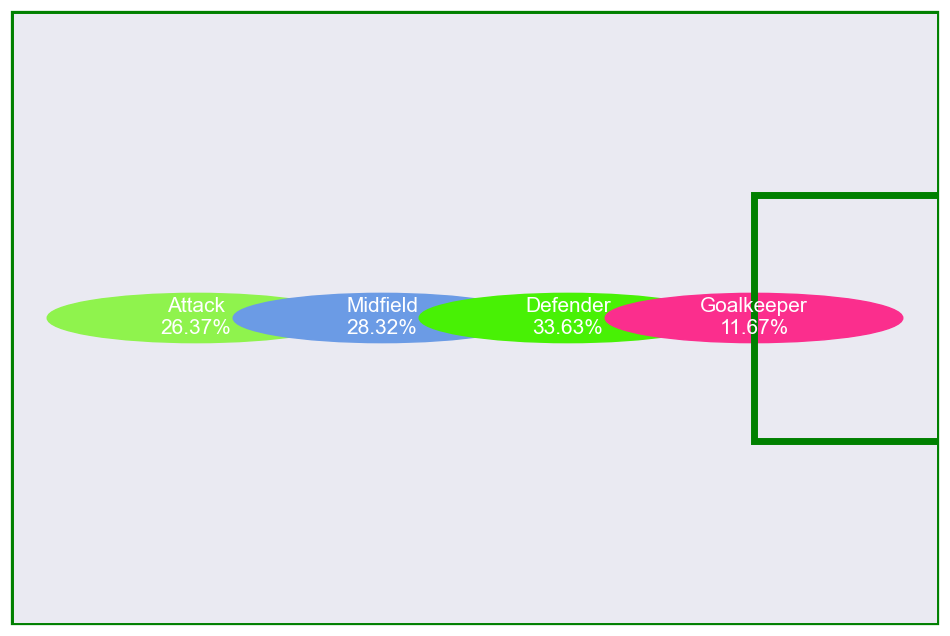

In [852]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# Assuming df is your DataFrame
# Replace 'position' with the actual column name in your dataset
positions_order = df[df['position'] != 'Missing']['position'].unique()
positions_count = df[df['position'] != 'Missing']['position'].value_counts()

# Total count of entries in the DataFrame
total_count = len(df[df['position'] != 'Missing'])

# Set up the football pitch
fig, ax = plt.subplots(figsize=(12, 8))
pitch = plt.Rectangle((0, 0), 25, 100, linewidth=5, edgecolor='green', facecolor='none')
ax.add_patch(pitch)

# Find the starting position dynamically
starting_position = 25 - len(positions_order) * 5

# Set a larger radius for the circles
circle_radius = 4

# Plot the positions on the pitch in the specified order with circles
for i, position in enumerate(positions_order):
    count = positions_count.get(position, 0)
    percentage = (count / total_count) * 100

    # Adjust the x-coordinate dynamically with more space to the left
    text_location = (starting_position + i * 5, 50)

    # Enhance aesthetics with circles and colors
    circle = plt.Circle(text_location, radius=circle_radius, color=np.random.rand(3,))
    ax.add_patch(circle)
    ax.text(*text_location, f'{position}\n{percentage:.2f}%', fontsize=15, ha='center', va='center', color='white')

# Add penalty area on the right side
penalty_area = plt.Rectangle((20, 30), 5, 40, linewidth=5, edgecolor='green', facecolor='none')
ax.add_patch(penalty_area)

# Set axis limits and remove axis labels
ax.set_xlim(0, 25)
ax.set_ylim(0, 100)
ax.set_xticks([])
ax.set_yticks([])

plt.show()


## Distribution of players with 30000000 and more market values!

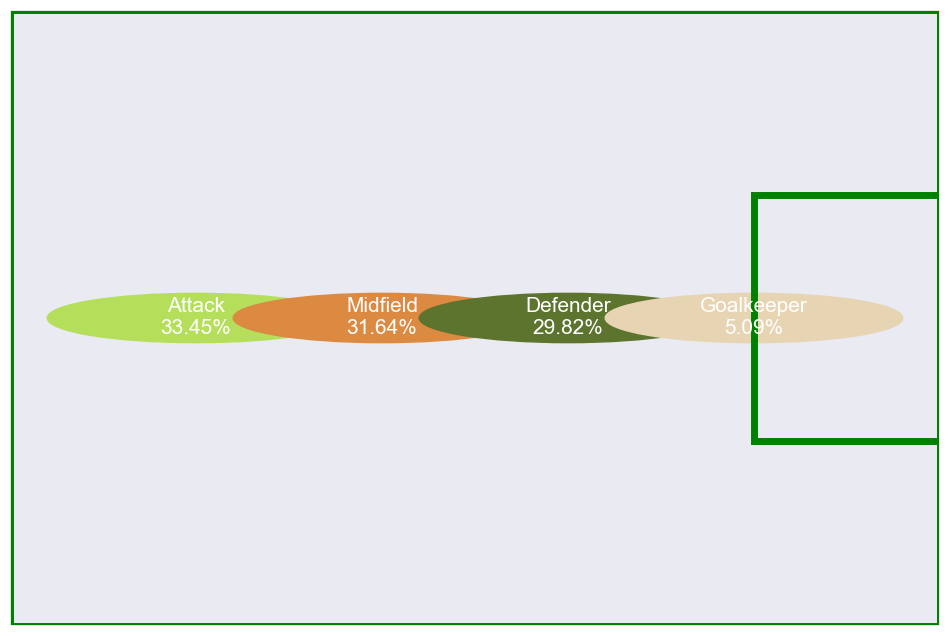

In [853]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# Assuming df is your DataFrame
# Replace 'position' and 'market_value_in_eur' with the actual column names in your dataset
filtered_df = df[(df['position'] != 'Missing') & (df['market_value_in_eur'] >= 30000000)]

positions_order = filtered_df['position'].unique()
positions_count = filtered_df['position'].value_counts()

# Total count of entries in the filtered DataFrame
total_count = len(filtered_df)

# Set up the football pitch
fig, ax = plt.subplots(figsize=(12, 8))
pitch = plt.Rectangle((0, 0), 25, 100, linewidth=5, edgecolor='green', facecolor='none')
ax.add_patch(pitch)

# Find the starting position dynamically
starting_position = 25 - len(positions_order) * 5

# Set a larger radius for the circles
circle_radius = 4

# Plot the positions on the pitch in the specified order with circles
for i, position in enumerate(positions_order):
    count = positions_count.get(position, 0)
    percentage = (count / total_count) * 100

    # Adjust the x-coordinate dynamically with more space to the left
    text_location = (starting_position + i * 5, 50)

    # Enhance aesthetics with circles and colors
    circle = plt.Circle(text_location, radius=circle_radius, color=np.random.rand(3,))
    ax.add_patch(circle)
    ax.text(*text_location, f'{position}\n{percentage:.2f}%', fontsize=15, ha='center', va='center', color='white')

# Add penalty area on the right side
penalty_area = plt.Rectangle((20, 30), 5, 40, linewidth=5, edgecolor='green', facecolor='none')
ax.add_patch(penalty_area)

# Set axis limits and remove axis labels
ax.set_xlim(0, 25)
ax.set_ylim(0, 100)
ax.set_xticks([])
ax.set_yticks([])

plt.show()


# Encoding Categorical Variables:

In [854]:
merged_players_df = pd.get_dummies(merged_players_df, columns=['position', 'sub_position', 'foot', 'country_of_birth', 'current_club_domestic_competition_id'], drop_first=True)


# Hpothesis testing

In [855]:
merged_players_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 6315 entries, 21474 to 30394
Columns: 188 entries, games_2022 to current_club_domestic_competition_id_UKR1
dtypes: float64(17), int32(1), int64(3), uint8(167)
memory usage: 2.0 MB


#### test whether there is a significant difference in the 'market_value_in_eur' between players with different foot preferences (left and right foot)

In [856]:
import pandas as pd
from scipy.stats import f_oneway
# Separate the data into groups based on foot preference
left_foot_players = merged_players_df[merged_players_df['foot_left'] == True]['market_value_in_eur'].dropna()
right_foot_players = merged_players_df[merged_players_df['foot_right'] == True]['market_value_in_eur'].dropna()
both_foot_players = merged_players_df[(merged_players_df['foot_left'] != True) & (merged_players_df['foot_right'] != True)]['market_value_in_eur'].dropna()

# Print summary statistics for each group
print("Left Foot Players:")
print(left_foot_players.describe())

print("\nRight Foot Players:")
print(right_foot_players.describe())

print("\nBoth Foot Players:")
print(both_foot_players.describe())

# Perform one-way ANOVA
f_stat, p_value = f_oneway(left_foot_players, right_foot_players, both_foot_players)

# Display the results
print(f'\nF-statistic: {f_stat}')
print(f'P-value: {p_value}')

# Check significance
alpha = 0.05
if p_value < alpha:
    print("Reject the null hypothesis: There is a significant difference in market values between foot preference groups.")
else:
    print("Fail to reject the null hypothesis: There is no significant difference in market values between foot preference groups.")


Left Foot Players:
count    1.589000e+03
mean     5.940499e+06
std      1.239877e+07
min      2.500000e+04
25%      5.000000e+05
50%      1.500000e+06
75%      5.000000e+06
max      1.800000e+08
Name: market_value_in_eur, dtype: float64

Right Foot Players:
count    4.517000e+03
mean     5.457537e+06
std      1.217284e+07
min      2.000000e+04
25%      4.000000e+05
50%      1.200000e+06
75%      5.000000e+06
max      1.800000e+08
Name: market_value_in_eur, dtype: float64

Both Foot Players:
count    2.090000e+02
mean     4.929306e+06
std      9.964487e+06
min      2.500000e+04
25%      4.000000e+05
50%      1.000000e+06
75%      5.000000e+06
max      8.000000e+07
Name: market_value_in_eur, dtype: float64

F-statistic: 1.2185291313582847
P-value: 0.29573427267093705
Fail to reject the null hypothesis: There is no significant difference in market values between foot preference groups.


### Analysis of Variance (ANOVA) test to investigate whether there is a significant difference in the average market values between players of different positions.

In [857]:
filtered_columns = merged_players_df.filter(regex='sub_position_*')

filtered_columns

,sub_position_Central Midfield,sub_position_Centre-Back,sub_position_Centre-Forward,sub_position_Defensive Midfield,sub_position_Goalkeeper,sub_position_Left Midfield,sub_position_Left Winger,sub_position_Left-Back,sub_position_Right Midfield,sub_position_Right Winger,sub_position_Right-Back,sub_position_Second Striker
21474,0,0,1,0,0,0,0,0,0,0,0,0
18682,0,0,0,0,0,0,1,0,0,0,0,0
10048,0,0,0,0,0,0,0,0,0,1,0,0
19862,0,0,0,0,0,0,1,0,0,0,0,0
17245,0,0,1,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...
12917,0,0,0,0,1,0,0,0,0,0,0,0
12915,0,0,0,0,0,0,0,1,0,0,0,0
23603,0,0,0,0,1,0,0,0,0,0,0,0
23604,0,1,0,0,0,0,0,0,0,0,0,0


In [858]:
import scipy.stats as stats

# Define the binary position fields
binary_position_fields = ['position_Defender', 'position_Goalkeeper', 'position_Midfield', 'position_Missing']

# Filter the DataFrame to include only numeric columns and the binary position fields
numeric_and_binary_columns = ['market_value_in_eur'] + binary_position_fields
filtered_df_anova = merged_players_df[numeric_and_binary_columns]

# Drop rows with missing values in 'market_value_in_eur'
filtered_df_anova = filtered_df_anova.dropna(subset=['market_value_in_eur'])

# Perform ANOVA test
anova_result = stats.f_oneway(
    *[group['market_value_in_eur'] for name, group in filtered_df_anova.groupby(binary_position_fields)]
)

# Display the ANOVA results
print("ANOVA Results:")
print(anova_result)

# Interpret the results
if anova_result.pvalue < 0.05:
    print("\nThere is a significant difference in the average market values between players of different positions.")
else:
    print("\nThe average market values between players of different positions are not significantly different.")


ANOVA Results:
F_onewayResult(statistic=19.506551702364632, pvalue=5.724310966553086e-16)

There is a significant difference in the average market values between players of different positions.


### market values of players across different age groups

In [859]:
# Specify the number of age groups
num_age_groups = 5

# Create age groups based on quantiles
merged_players_df['age_group'] = pd.qcut(merged_players_df['age'], q=num_age_groups, labels=False)

# Filter the DataFrame to include only numeric columns and the 'age_group' column
numeric_columns_for_age = ['market_value_in_eur']
numeric_columns_for_age.append('age_group')
filtered_age_df = merged_players_df[numeric_columns_for_age]

# Perform ANOVA test
anova_age_result = stats.f_oneway(
    *[group['market_value_in_eur'] for name, group in filtered_age_df.groupby('age_group')]
)

# Display the ANOVA results for age groups
print("ANOVA Results for Age Groups:")
print(anova_age_result)

# Interpret the results
if anova_age_result.pvalue < 0.05:
    print("\nThere is a significant difference in the market values of players across different age groups.")
else:
    print("\nThe market values of players across different age groups are not significantly different.")


ANOVA Results for Age Groups:
F_onewayResult(statistic=36.884733657931115, pvalue=1.5666088444352123e-30)

There is a significant difference in the market values of players across different age groups.


# Splitting the Data

In [860]:
# Splitting the Data
from sklearn.model_selection import train_test_split

X = merged_players_df.drop('market_value_in_eur', axis=1)  # Features
y = merged_players_df['market_value_in_eur']  # Target variable

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)


In [861]:
# Import necessary libraries
from sklearn.linear_model import LinearRegression
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.svm import SVR
from sklearn.metrics import r2_score

# Initialize models
models = {
    'Linear Regression': LinearRegression(),
    'Decision Tree': DecisionTreeRegressor(random_state=42),
    'Random Forest': RandomForestRegressor(random_state=42),
    'Gradient Boosting': GradientBoostingRegressor(random_state=42),
    'Support Vector Machine': SVR()
}

# Train and evaluate models
for model_name, model in models.items():
    # Train the model
    model.fit(X_train, y_train)
    
    # Make predictions
    y_pred = model.predict(X_test)
    
    # Evaluate the model
    r2 = r2_score(y_test, y_pred)
    
    # Display the results
    print(f"Model: {model_name}")
    print(f"R-squared Score: {r2}")
    print("--------")


Model: Linear Regression
R-squared Score: 0.7433333222685792
--------
Model: Decision Tree
R-squared Score: 0.7114321710917324
--------
Model: Random Forest
R-squared Score: 0.8590893997940707
--------
Model: Gradient Boosting
R-squared Score: 0.8631803483692
--------
Model: Support Vector Machine
R-squared Score: -0.1634947454510558
--------


In [862]:
# Import necessary libraries
from sklearn.linear_model import LinearRegression
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.svm import SVR
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error, explained_variance_score

# Initialize models
models = {
    'Linear Regression': LinearRegression(),
    'Decision Tree': DecisionTreeRegressor(random_state=42),
    'Random Forest': RandomForestRegressor(random_state=42),
    'Gradient Boosting': GradientBoostingRegressor(random_state=42),
    'Support Vector Machine': SVR()
}

# Train and evaluate models
for model_name, model in models.items():
    # Train the model
    model.fit(X_train, y_train)
    
    # Make predictions
    y_pred = model.predict(X_test)
    
    # Evaluate the model
    r2 = r2_score(y_test, y_pred)
    mae = mean_absolute_error(y_test, y_pred)
    mse = mean_squared_error(y_test, y_pred)
    rmse = mean_squared_error(y_test, y_pred, squared=False)
    explained_var = explained_variance_score(y_test, y_pred)
    
    # Display the results
    print(f"Model: {model_name}")
    print(f"R-squared Score: {r2}")
    print(f"Mean Absolute Error: {mae}")
    print(f"Mean Squared Error: {mse}")
    print(f"Root Mean Squared Error: {rmse}")
    print(f"Explained Variance Score: {explained_var}")
    print("--------")


Model: Linear Regression
R-squared Score: 0.7433333222685792
Mean Absolute Error: 3291227.6329319756
Mean Squared Error: 29901613128351.04
Root Mean Squared Error: 5468236.747650108
Explained Variance Score: 0.745340458247326
--------
Model: Decision Tree
R-squared Score: 0.7114321710917324
Mean Absolute Error: 1964276.7848629102
Mean Squared Error: 33618090425950.55
Root Mean Squared Error: 5798110.935981697
Explained Variance Score: 0.7115031891778547
--------
Model: Random Forest
R-squared Score: 0.8590893997940707
Mean Absolute Error: 1467294.2553968753
Mean Squared Error: 16416054823643.496
Root Mean Squared Error: 4051673.0894339806
Explained Variance Score: 0.859195691651162
--------
Model: Gradient Boosting
R-squared Score: 0.8631803483692
Mean Absolute Error: 1653043.221607018
Mean Squared Error: 15939460188521.049
Root Mean Squared Error: 3992425.3516529333
Explained Variance Score: 0.8633543851195749
--------
Model: Support Vector Machine
R-squared Score: -0.1634947454510558

# Observation on  model


` The negative R-squared score for the Support Vector Machine indicates that this model is not performing well on your data. It's possible that the SVM model may not be suitable for your regression task, or there might be an issue with the model's hyperparameters. Consider adjusting the parameters or trying different models to improve performance.`


`In contrast, both Random Forest and Gradient Boosting seem to be performing well, with high R-squared scores. You may want to further tune hyperparameters for these models or consider them for your final prediction.`

# Best hyperparameters for Random Forest and Gradient Boosting:

In [ ]:
#Grid Search

In [130]:
from sklearn.model_selection import GridSearchCV

# Define hyperparameter grids for Random Forest and Gradient Boosting
rf_param_grid = {
    'n_estimators': [50, 100, 200],
    'max_depth': [None, 10, 20],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

gb_param_grid = {
    'n_estimators': [50, 100, 200],
    'learning_rate': [0.01, 0.1, 0.2],
    'max_depth': [3, 4, 5],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

# Perform grid search for Random Forest
rf_grid_search = GridSearchCV(RandomForestRegressor(random_state=42), rf_param_grid, cv=5, scoring='r2')
rf_grid_search.fit(X_train, y_train)

# Perform grid search for Gradient Boosting
gb_grid_search = GridSearchCV(GradientBoostingRegressor(random_state=42), gb_param_grid, cv=5, scoring='r2')
gb_grid_search.fit(X_train, y_train)

# Print the best hyperparameters for each model
print("Best Hyperparameters for Random Forest:")
print(rf_grid_search.best_params_)
print("\nBest Hyperparameters for Gradient Boosting:")
print(gb_grid_search.best_params_)

# Evaluate the models with the best hyperparameters
rf_best_model = rf_grid_search.best_estimator_
gb_best_model = gb_grid_search.best_estimator_

# Evaluate on the test set
rf_y_pred = rf_best_model.predict(X_test)
gb_y_pred = gb_best_model.predict(X_test)

rf_r2 = r2_score(y_test, rf_y_pred)
gb_r2 = r2_score(y_test, gb_y_pred)

# Display the results
print("\nRandom Forest R-squared Score with Best Hyperparameters:", rf_r2)
print("Gradient Boosting R-squared Score with Best Hyperparameters:", gb_r2)


Best Hyperparameters for Random Forest:
{'max_depth': 10, 'min_samples_leaf': 2, 'min_samples_split': 2, 'n_estimators': 200}

Best Hyperparameters for Gradient Boosting:
{'learning_rate': 0.1, 'max_depth': 5, 'min_samples_leaf': 1, 'min_samples_split': 10, 'n_estimators': 200}

Random Forest R-squared Score with Best Hyperparameters: 0.8787846261124929
Gradient Boosting R-squared Score with Best Hyperparameters: 0.8834115304962495


 Best Hyperparameters for Random Forest:
{'max_depth': 10, 'min_samples_leaf': 2, 'min_samples_split': 2, 'n_estimators': 200}

Best Hyperparameters for Gradient Boosting:
{'learning_rate': 0.1, 'max_depth': 5, 'min_samples_leaf': 1, 'min_samples_split': 10, 'n_estimators': 200}

Random Forest R-squared Score with Best Hyperparameters: 0.8787846261124929
Gradient Boosting R-squared Score with Best Hyperparameters: 0.8834115304962495 

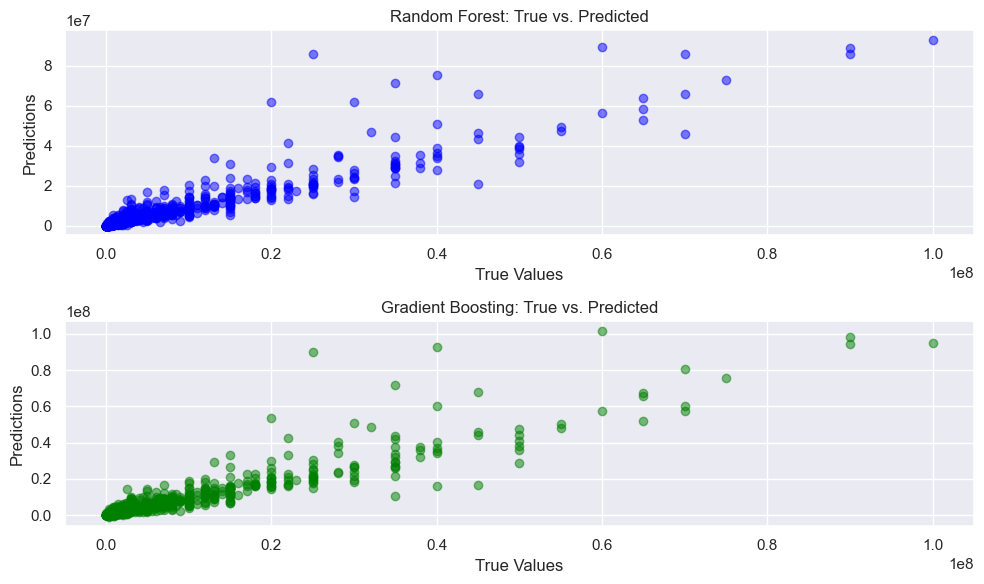

Random Forest Metrics:
Mean Squared Error: 16150414558974.264
Mean Absolute Error: 1472181.406202689

Gradient Boosting Metrics:
Mean Squared Error: 18220074195273.938
Mean Absolute Error: 1511729.3559508722


In [863]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error, mean_absolute_error

# Assuming you have X_test and y_test for evaluation
# Replace these with your actual test set and target values

# Evaluate Random Forest
rf_model = RandomForestRegressor(max_depth=10, min_samples_leaf=2, min_samples_split=2, n_estimators=200)
rf_model.fit(X_train, y_train)
rf_predictions = rf_model.predict(X_test)

# Calculate additional metrics for Random Forest
rf_mse = mean_squared_error(y_test, rf_predictions)
rf_mae = mean_absolute_error(y_test, rf_predictions)

# Evaluate Gradient Boosting
gb_model = GradientBoostingRegressor(learning_rate=0.1, max_depth=5, min_samples_leaf=1, min_samples_split=10, n_estimators=200)
gb_model.fit(X_train, y_train)
gb_predictions = gb_model.predict(X_test)

# Calculate additional metrics for Gradient Boosting
gb_mse = mean_squared_error(y_test, gb_predictions)
gb_mae = mean_absolute_error(y_test, gb_predictions)

# Plot the predictions
plt.figure(figsize=(10, 6))

plt.subplot(2, 1, 1)
plt.scatter(y_test, rf_predictions, alpha=0.5, color='blue')
plt.title('Random Forest: True vs. Predicted')
plt.xlabel('True Values')
plt.ylabel('Predictions')

plt.subplot(2, 1, 2)
plt.scatter(y_test, gb_predictions, alpha=0.5, color='green')
plt.title('Gradient Boosting: True vs. Predicted')
plt.xlabel('True Values')
plt.ylabel('Predictions')

plt.tight_layout()
plt.show()

# Print the metrics
print("Random Forest Metrics:")
print(f"Mean Squared Error: {rf_mse}")
print(f"Mean Absolute Error: {rf_mae}")

print("\nGradient Boosting Metrics:")
print(f"Mean Squared Error: {gb_mse}")
print(f"Mean Absolute Error: {gb_mae}")


In [726]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import r2_score
from sklearn.neural_network import MLPRegressor

# Standardize the data (important for neural networks)
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Build a simple neural network model
model = MLPRegressor(hidden_layer_sizes=(100, 50), max_iter=500, random_state=42)

# Train the model
model.fit(X_train_scaled, y_train)

# Make predictions on the test set
y_pred = model.predict(X_test_scaled)

# Evaluate the model
r2 = r2_score(y_test, y_pred)

# Print the R-squared score
print("Model: Neural Network")
print(f"R-squared Score: {r2}")

Model: Neural Network
R-squared Score: 0.7373565166708334


In [730]:
# Build a more complex neural network model
model = MLPRegressor(
    hidden_layer_sizes=(200, 100, 50),  # More layers and neurons
    activation='relu',  # Rectified Linear Unit (ReLU) activation function
    max_iter=1000,  # Increase the number of iterations
    random_state=42
)

# Train the model
model.fit(X_train_scaled, y_train)

# Make predictions on the test set
y_pred = model.predict(X_test_scaled)

# Evaluate the model
r2 = r2_score(y_test, y_pred)

# Print the R-squared score
print("Model: Neural Network (More Complex)")

print(f"R-squared Score: {r2}")

Model: Neural Network (More Complex)
R-squared Score: 0.7557207139781752
